In [1]:
import random
import numpy as np
import math

## Estimation de π par Monte Carlo

In [43]:
def tirage(m):
    return [-m + 2*m*random.random(),-m + 2*m*random.random()]

In [44]:
tirage(1)

[0.03733228104489217, -0.7863418079781888]

In [4]:
def monteCarlo(N):
    pi = 0
    abscisses = []
    ordonnees = []
    for i in range(N):
        x,y = tirage(1)
        abscisses.append(x)
        ordonnees.append(y)
        if x*x + y*y <= 1:
            pi += 1
    pi = 4*(pi/N)
    return pi,np.array(abscisses),np.array(ordonnees)

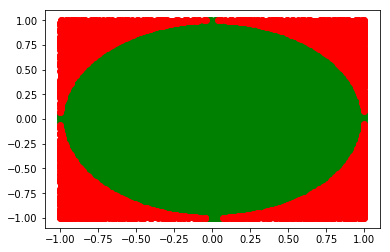

In [29]:
import matplotlib.pyplot as plt

plt.figure()

# trace le carré
plt.plot([-1, -1, 1, 1], [-1, 1, 1, -1], '-')

# trace le cercle
x = np.linspace(-1, 1, 100)
y = np.sqrt(1- x*x)
plt.plot(x, y, 'b')
plt.plot(x, -y, 'b')

# estimation par Monte Carlo
pi, x, y = monteCarlo(int(1e5))

# trace les points dans le cercle et hors du cercle
dist = x*x + y*y 
plt.plot(x[dist <=1], y[dist <=1], "go")
plt.plot(x[dist>1], y[dist>1], "ro")
plt.show()

In [30]:
pi

3.1372

## Décodage par la méthode de Metropolis-Hastings

In [7]:
import pickle as pkl

with open("countWar.pkl", 'rb') as f:
    (count, mu, A) = pkl.load(f, encoding='latin1')

with open("secret.txt", 'r') as f:
    secret = f.read()[0:-1] # -1 pour supprimer le saut de ligne 
    
with open("secret2.txt", 'r') as f:
    secret2 = f.read()[0:-1] # -1 pour supprimer le saut de ligne 

In [8]:
def swapFDet(taut, c1, c2): #swapF déterministe
    tau = taut.copy()
    tmp = taut[c1]
    tau[c1] = taut[c2]
    tau[c2] = tmp
    return tau

In [9]:
def swapF(taut):
    lC = list(taut.keys())
    c1 = random.choice(lC)
    lC.pop(lC.index(c1))
    c2 = random.choice(lC)
    return swapFDet(taut,c1,c2)

In [10]:
taut = {'a' : 'b', 'b' : 'c', 'c' : 'a', 'd' : 'd' }

In [11]:
swapF(taut)

{'a': 'b', 'b': 'c', 'c': 'd', 'd': 'a'}

In [12]:
def decrypt(mess, tau):
    md = ""
    for c in mess:
        md += tau[c]
    return md

In [13]:
tau = {'a' : 'b', 'b' : 'c', 'c' : 'a', 'd' : 'd' }
decrypt("aabcd",tau)

'bbcad'

In [14]:
decrypt( "dcba",tau)

'dacb'

In [15]:
chars2index = dict(zip(np.array(list(count.keys())), np.arange(len(count.keys()))))

In [16]:
chars2index['a']

51

In [17]:
with open("fichierHash.pkl", 'rb') as f:
    chars2index = pkl.load(f, encoding='latin1')

In [18]:
chars2index['a']

51

In [19]:
def logLikelihood(mess, mu, A, chars2index):
    ll = np.log(mu[chars2index[mess[0]]])
    for i in range(len(mess)-1):
        ll+=np.log(A[chars2index[mess[i]]][chars2index[mess[i+1]]])
    return ll

In [20]:
logLikelihood("abcd",mu,A,chars2index)

-24.600258560804818

In [21]:
logLikelihood( "dcba",mu,A,chars2index)

-26.274828997400395

In [55]:
def MetropolisHastings(mess, mu, A, tau, N, chars2index) :
    mess_dec_lpv = decrypt(mess,tau)
    ll = logLikelihood(mess_dec_lpv,mu,A,chars2index)
    for i in range(N):
        new_tau = swapF(tau)
        mess_dec = decrypt(mess,new_tau)
        new_ll = logLikelihood(mess_dec,mu,A,chars2index)
        alpha = min(1,np.exp(new_ll-ll))
        if alpha > random.random():
            tau = new_tau
            mess_dec_lpv = mess_dec # message décodé le plus vraisemblable 
            ll = new_ll
            print()
            print("Itération",i,"\nLog vraisemblance : ",ll,"\nMessage décodé : ",mess_dec_lpv,"\n")
    return mess_dec_lpv

In [56]:
def identityTau (count):
    tau = {} 
    for k in list(count.keys()):
        tau[k] = k
    return tau

In [58]:
MetropolisHastings(secret2,mu,A,identityTau(count),50000,chars2index)


Itération 0 
Log vraisemblance :  -9339.435428748578 
Message décodé :  ,""TSK0)IT:92(I9(:TS)v(Tgm)v("(3T)"VIXTgS)gTh)gSqT,mm2v2IXT)gT2IB2I2g(:20)":=T0)gS(0)g29:=TgS(T0V:gT(M)9gTVBT:92(I9(:=T)D)I3VI:TgS(ThmV9(::TVBT)I)"x:2:T)I3T(Ig(m:TVITgS(TI(aThmV9(::TVBTgS(T2Ig(Xm)g2VITVBTKIPIVaI=T2IB2I2g("xT:0)""=TdK)Ig2g2(:qT,D)I3VI2IXTgS(T9VI9(hg2VITVBT9)K:(=T0)gS(0)g29:T:((P:T")a=TgS)gT2:=TgS(ThmVh(mgxT9V00VITgVT)""TKIPIVaI=T2IB2I2g("xT:0)""=T("(0(Ig:qT IT)IVgS(mTBVm0TDKgT)"VIXTgS(T:)0(Th)gSTVBTm(B"(9g2VITgS(TVgS(mT:92(I9(:TS)v(ThmV9((3(3qTCS(ITR(agVIT(IKI92)g(3TgS(T")aTVBTXm)v2gxTS(T323TIVgT:)xTgS)gTgS(T:KITVmTgS(T()mgSTS)3T)ThmVh(mgxTVBT)ggm)9g2VI?TS(T:)23TgS)gT)""TDV32(:TBmV0TgS(T")mX(:gTgVTgS(T:0)""(:gTS)v(TgS(ThmVh(mgxTVBT)ggm)9g2IXTVI(T)IVgS(m=TgS)gT2:=T"()v2IXT):23(TgS(TdK(:g2VITVBTgS(T9)K:(TVBTgS(T0Vv(0(IgTVBTgS(TDV32(:=TS(T(Mhm(::(3TgS(ThmVh(mgxT9V00VITgVT)""TDV32(:TBmV0TgS(T2IB2I2g("xT")mX(TgVTgS(T2IB2I2g("xT:0)""qTJS(T:)0(T2:T3VI(TDxTgS(TI)gKm)"T:92(I9(:7T"()v2IXT):23(TgS(TdK(:g2VITV

Log vraisemblance :  -8823.504884078304 
Message décodé :  ,66TSK0)IT:92(I9(:TS)v(Tqm)v(6(3T)6VIXTqS)qTe)qSgT,mm2v2IXT)qT2I12I2q(:20)6:=T0)qS(0)q29:=TqS(T0V:qT(M)9qTV1T:92(I9(:=T)D)I3VI:TqS(TemV9(::TV1T)I)6x:2:T)I3T(Iq(m:TVITqS(TI(aTemV9(::TV1TqS(T2Iq(Xm)q2VITV1TKIPIVaI=T2I12I2q(6xT:0)66=TdK)Iq2q2(:gT,D)I3VI2IXTqS(T9VI9(eq2VITV1T9)K:(=T0)qS(0)q29:T:((P:T6)a=TqS)qT2:=TqS(TemVe(mqxT9V00VITqVT)66TKIPIVaI=T2I12I2q(6xT:0)66=T(6(0(Iq:gT IT)IVqS(mT1Vm0TDKqT)6VIXTqS(T:)0(Te)qSTV1Tm(16(9q2VITqS(TVqS(mT:92(I9(:TS)v(TemV9((3(3gTCS(ITR(aqVIT(IKI92)q(3TqS(T6)aTV1TXm)v2qxTS(T323TIVqT:)xTqS)qTqS(T:KITVmTqS(T()mqSTS)3T)TemVe(mqxTV1T)qqm)9q2VI?TS(T:)23TqS)qT)66TDV32(:T1mV0TqS(T6)mX(:qTqVTqS(T:0)66(:qTS)v(TqS(TemVe(mqxTV1T)qqm)9q2IXTVI(T)IVqS(m=TqS)qT2:=T6()v2IXT):23(TqS(TdK(:q2VITV1TqS(T9)K:(TV1TqS(T0Vv(0(IqTV1TqS(TDV32(:=TS(T(Mem(::(3TqS(TemVe(mqxT9V00VITqVT)66TDV32(:T1mV0TqS(T2I12I2q(6xT6)mX(TqVTqS(T2I12I2q(6xT:0)66gTJS(T:)0(T2:T3VI(TDxTqS(TI)qKm)6T:92(I9(:7T6()v2IXT):23(TqS(TdK(:q2VITV1T9)K:(=TqS(xT

Itération 161 
Log vraisemblance :  -7469.213403448795 
Message décodé :  G66)3K2O/):X7(/X(:)3OL()JjOL(6(S)O60/9)J3OJ)ZOJ3g)Gjj7L7/9)OJ)7/17/7J(:72O6:=)2OJ3(2OJ7X:=)J3()20:J)(HOXJ)01):X7(/X(:=)ODO/S0/:)J3()Zj0X(::)01)O/O64:7:)O/S)(/J(j:)0/)J3()/(Q)Zj0X(::)01)J3()7/J(9jOJ70/)01)K/P/0Q/=)7/17/7J(64):2O66=)UKO/J7J7(:g)GDO/S0/7/9)J3()X0/X(ZJ70/)01)XOK:(=)2OJ3(2OJ7X:):((P:)6OQ=)J3OJ)7:=)J3()Zj0Z(jJ4)X0220/)J0)O66)K/P/0Q/=)7/17/7J(64):2O66=)(6(2(/J:g)*/)O/0J3(j)10j2)DKJ)O60/9)J3():O2()ZOJ3)01)j(16(XJ70/)J3()0J3(j):X7(/X(:)3OL()Zj0X((S(Sg),3(/)5(QJ0/)(/K/X7OJ(S)J3()6OQ)01)9jOL7J4)3()S7S)/0J):O4)J3OJ)J3():K/)0j)J3()(OjJ3)3OS)O)Zj0Z(jJ4)01)OJJjOXJ70/?)3():O7S)J3OJ)O66)D0S7(:)1j02)J3()6Oj9(:J)J0)J3():2O66(:J)3OL()J3()Zj0Z(jJ4)01)OJJjOXJ7/9)0/()O/0J3(j=)J3OJ)7:=)6(OL7/9)O:7S()J3()UK(:J70/)01)J3()XOK:()01)J3()20L(2(/J)01)J3()D0S7(:=)3()(HZj(::(S)J3()Zj0Z(jJ4)X0220/)J0)O66)D0S7(:)1j02)J3()7/17/7J(64)6Oj9()J0)J3()7/17/7J(64):2O66g)R3():O2()7:)S0/()D4)J3()/OJKjO6):X7(/X(:V)6(OL7/9)O:7S()J3()UK(:J70/)

Log vraisemblance :  -6372.251104929916 
Message décodé :  C::945J6/9ZO7=/O=Z946L=9326L=:=896:0/*934639E634G9C227L7/*96397/17/73=Z7J6:Z)9J634=J637OZ)934=9J0Z39=K6O39019ZO7=/O=Z)96Q6/80/Z934=9E20O=ZZ90196/6:XZ7Z96/89=/3=2Z90/934=9/=(9E20O=ZZ901934=97/3=*26370/90195/V/0(/)97/17/73=:X9ZJ6::)9U56/3737=ZG9CQ6/80/7/*934=9O0/O=E370/9019O65Z=)9J634=J637OZ9Z==VZ9:6()9346397Z)934=9E20E=23X9O0JJ0/93096::95/V/0(/)97/17/73=:X9ZJ6::)9=:=J=/3ZG9q/96/034=29102J9Q5396:0/*934=9Z6J=9E63490192=1:=O370/934=9034=29ZO7=/O=Z946L=9E20O==8=8G9D4=/9,=(30/9=/5/O763=8934=9:6(9019*26L73X94=98789/039Z6X93463934=9Z5/902934=9=62349468969E20E=23X901963326O370/H94=9Z6789346396::9Q087=Z9120J934=9:62*=Z3930934=9ZJ6::=Z3946L=934=9E20E=23X901963326O37/*90/=96/034=2)9346397Z)9:=6L7/*96Z78=934=9U5=Z370/901934=9O65Z=901934=9J0L=J=/3901934=9Q087=Z)94=9=KE2=ZZ=8934=9E20E=23X9O0JJ0/93096::9Q087=Z9120J934=97/17/73=:X9:62*=930934=97/17/73=:X9ZJ6::G9-4=9Z6J=97Z980/=9QX934=9/63526:9ZO7=/O=Zh9:=6L7/*96Z78=934=9U5=Z370/9019O65Z=)934=X9

Log vraisemblance :  -6150.644294753137 
Message décodé :  O::14=06/1ZJ78/J8Z146L81326L8:8K16:5/*134631V634G1O227L7/*16317/97/738Z706:Z)1063480637JZ)1348105Z318E6J31591ZJ78/J8Z)16Q6/K5/Z13481V25J8ZZ15916/6:XZ7Z16/K18/382Z15/13481/8(1V25J8ZZ159134817/38*26375/1591=/C/5(/)17/97/738:X1Z06::)1U=6/37378ZG1OQ6/K5/7/*13481J5/J8V375/1591J6=Z8)1063480637JZ1Z88CZ1:6()1346317Z)13481V25V823X1J5005/13516::1=/C/5(/)17/97/738:X1Z06::)18:808/3ZG1x/16/53482195201Q=316:5/*13481Z6081V6341591289:8J375/13481534821ZJ78/J8Z146L81V25J88K8KG1W48/1I8(35/18/=/J7638K13481:6(1591*26L73X1481K7K1/531Z6X1346313481Z=/1521348186234146K161V25V823X159163326J375/Y1481Z67K1346316::1Q5K78Z1925013481:62*8Z313513481Z06::8Z3146L813481V25V823X159163326J37/*15/816/53482)1346317Z)1:86L7/*16Z7K813481U=8Z375/15913481J6=Z81591348105L808/315913481Q5K78Z)14818EV28ZZ8K13481V25V823X1J5005/13516::1Q5K78Z19250134817/97/738:X1:62*8135134817/97/738:X1Z06::G1;481Z60817Z1K5/81QX13481/63=26:1ZJ78/J8Zb1:86L7/*16Z7K813481U=8Z375/1591J6=Z8)1348X1

Message décodé :  O9914U06/1X=38/=8X146J81726J898V1695/Q174671;674G1O223J3/Q16713/*3/378X3069X(1067480673=X(1748105X718E6=715*1X=38/=8X(16:6/V5/X17481;25=8XX15*16/69ZX3X16/V18/782X15/17481/8)1;25=8XX15*174813/78Q26735/15*1U/Y/5)/(13/*3/3789Z1X0699(1LU6/73738XG1O:6/V5/3/Q17481=5/=8;735/15*1=6UX8(1067480673=X1X88YX196)(1746713X(17481;25;827Z1=5005/17516991U/Y/5)/(13/*3/3789Z1X0699(189808/7XG1K/16/574821*5201:U71695/Q17481X6081;67415*128*98=735/17481574821X=38/=8X146J81;25=88V8VG1?48/1C8)75/18/U/=3678V1748196)15*1Q26J37Z1481V3V1/571X6Z1746717481XU/1521748186274146V161;25;827Z15*167726=735/'1481X63V1746716991:5V38X1*25017481962Q8X717517481X06998X7146J817481;25;827Z15*167726=73/Q15/816/57482(1746713X(1986J3/Q16X3V817481LU8X735/15*17481=6UX815*1748105J808/715*17481:5V38X(14818E;28XX8V17481;25;827Z1=5005/17516991:5V38X1*250174813/*3/3789Z1962Q8175174813/*3/3789Z1X0699G1x481X60813X1V5/81:Z17481/67U2691X=38/=8XH1986J3/Q16X3V817481LU8X735/15*1=6UX8(1748Z1X88Y1*52196)XG1j3X752Z1X76/VX15/17481X608

Itération 1658 
Log vraisemblance :  -5885.024844802519 
Message décodé :  O001*U96/1X=38/=8X1*6J81726J808Q1605/G17*671L67*V1O223J3/G16713/43/378X3960X(1967*89673=X(17*8195X718z6=71541X=38/=8X(16:6/Q5/X17*81L25=8XX15416/60ZX3X16/Q18/782X15/17*81/8)1L25=8XX15417*813/78G26735/1541U/Y/5)/(13/43/3780Z1X9600(1 U6/73738XV1O:6/Q5/3/G17*81=5/=8L735/1541=6UX8(1967*89673=X1X88YX106)(17*6713X(17*81L25L827Z1=5995/17516001U/Y/5)/(13/43/3780Z1X9600(180898/7XV1x/16/57*82145291:U71605/G17*81X6981L67*154128408=735/17*8157*821X=38/=8X1*6J81L25=88Q8QV1R*8/1P8)75/18/U/=3678Q17*8106)1541G26J37Z1*81Q3Q1/571X6Z17*6717*81XU/15217*818627*1*6Q161L25L827Z154167726=735/S1*81X63Q17*6716001:5Q38X1425917*81062G8X717517*81X96008X71*6J817*81L25L827Z154167726=73/G15/816/57*82(17*6713X(1086J3/G16X3Q817*81 U8X735/15417*81=6UX815417*8195J898/715417*81:5Q38X(1*818zL28XX8Q17*81L25L827Z1=5995/17516001:5Q38X1425917*813/43/3780Z1062G817517*813/43/3780Z1X9600V1K*81X69813X1Q5/81:Z17*81/67U2601X=38/=8X;1086J3/G16X3Q817*81 U8X735/

Itération 2081 
Log vraisemblance :  -5833.622083203268 
Message décodé :  K001*U=2/1XQ38/Q8X1*2L81762L80891205/G17*271)27*V1K663L3/G12713/43/378X3=20X(1=27*8=273QX(17*81=5X718z2Q71541XQ38/Q8X(12Y2/95/X17*81)65Q8XX15412/20ZX3X12/918/786X15/17*81/8J1)65Q8XX15417*813/78G62735/1541U/;/5J/(13/43/3780Z1X=200(1 U2/73738XV1KY2/95/3/G17*81Q5/Q8)735/1541Q2UX8(1=27*8=273QX1X88;X102J(17*2713X(17*81)65)867Z1Q5==5/17512001U/;/5J/(13/43/3780Z1X=200(1808=8/7XV1C/12/57*861456=1YU71205/G17*81X2=81)27*154168408Q735/17*8157*861XQ38/Q8X1*2L81)65Q88989V1P*8/1D8J75/18/U/Q3278917*8102J1541G62L37Z1*819391/571X2Z17*2717*81XU/15617*818267*1*29121)65)867Z154127762Q735/:1*81X23917*2712001Y5938X1465=17*81026G8X717517*81X=2008X71*2L817*81)65)867Z154127762Q73/G15/812/57*86(17*2713X(1082L3/G12X39817*81 U8X735/15417*81Q2UX815417*81=5L8=8/715417*81Y5938X(1*818z)68XX8917*81)65)867Z1Q5==5/17512001Y5938X1465=17*813/43/3780Z1026G817517*813/43/3780Z1X=200V1B*81X2=813X195/81YZ17*81/27U6201XQ38/Q8XI1082L3/G12X39817*81 U8X735/

Itération 2453 
Log vraisemblance :  -5837.822094831492 
Message décodé :  G001XU*2/1=Q38/Q8=1X2L81762L80891205/O17X271)27XV1G663L3/O12713/43/378=3*20=(1*27X8*273Q=(17X81*5=718F2Q71541=Q38/Q8=(12Y2/95/=17X81)65Q8==15412/20Z=3=12/918/786=15/17X81/8J1)65Q8==15417X813/78O62735/1541U/K/5J/(13/43/3780Z1=*200(1 U2/73738=V1GY2/95/3/O17X81Q5/Q8)735/1541Q2U=8(1*27X8*273Q=1=88K=102J(17X2713=(17X81)65)867Z1Q5**5/17512001U/K/5J/(13/43/3780Z1=*200(1808*8/7=V1W/12/57X861456*1YU71205/O17X81=2*81)27X154168408Q735/17X8157X861=Q38/Q8=1X2L81)65Q88989V1xX8/1z8J75/18/U/Q3278917X8102J1541O62L37Z1X819391/571=2Z17X2717X81=U/15617X818267X1X29121)65)867Z154127762Q735/'1X81=23917X2712001Y5938=1465*17X81026O8=717517X81=*2008=71X2L817X81)65)867Z154127762Q73/O15/812/57X86(17X2713=(1082L3/O12=39817X81 U8=735/15417X81Q2U=815417X81*5L8*8/715417X81Y5938=(1X818F)68==8917X81)65)867Z1Q5**5/17512001Y5938=1465*17X813/43/3780Z1026O817517X813/43/3780Z1=*200V1DX81=2*813=195/81YZ17X81/27U6201=Q38/Q8=M1082L3/O12=39817X81 U8=735/

Log vraisemblance :  -5817.724054274512 
Message décodé :  G331XU*2/1=608/68=1X2L817Q2L83891235/;17X271)27XV1GQQ0L0/;12710/40/078=0*23=(1*27X8*2706=(17X81*5=718C2671541=608/68=(12E2/95/=17X81)Q568==15412/23Z=0=12/918/78Q=15/17X81/8J1)Q568==15417X810/78;Q2705/1541U/Y/5J/(10/40/0783Z1=*233(1 U2/70708=V1GE2/95/0/;17X8165/68)705/154162U=8(1*27X8*2706=1=88Y=132J(17X2710=(17X81)Q5)8Q7Z165**5/17512331U/Y/5J/(10/40/0783Z1=*233(1838*8/7=V1:/12/57X8Q145Q*1EU71235/;17X81=2*81)27X1541Q84386705/17X8157X8Q1=608/68=1X2L81)Q5688989V1OX8/1F8J75/18/U/60278917X8132J1541;Q2L07Z1X819091/571=2Z17X2717X81=U/15Q17X8182Q7X1X29121)Q5)8Q7Z1541277Q26705/P1X81=20917X2712331E5908=14Q5*17X8132Q;8=717517X81=*2338=71X2L817X81)Q5)8Q7Z1541277Q2670/;15/812/57X8Q(17X2710=(1382L0/;12=09817X81 U8=705/15417X8162U=815417X81*5L8*8/715417X81E5908=(1X818C)Q8==8917X81)Q5)8Q7Z165**5/17512331E5908=14Q5*17X810/40/0783Z132Q;817517X810/40/0783Z1=*233V1RX81=2*810=195/81EZ17X81/27UQ231=608/68=j1382L0/;12=09817X81 U8=705/154162U=8(17X8Z1

Log vraisemblance :  -5745.698343012105 
Message décodé :  G6619U*2/103=8/380192L817Q2L868X1265/:179271)279V1GQQ=L=/:1271=/4=/=780=*260(1*2798*27=30(17981*50718 237154103=8/380(12E2/X5/017981)Q5380015412/26Z0=012/X18/78Q015/17981/8J1)Q5380015417981=/78:Q27=5/1541U/C/5J/(1=/4=/=786Z10*266(1"U2/7=7=80V1GE2/X5/=/:1798135/38)7=5/154132U08(1*2798*27=301088C0162J(179271=0(17981)Q5)8Q7Z135**5/17512661U/C/5J/(1=/4=/=786Z10*266(1868*8/70V1!/12/5798Q145Q*1EU71265/:1798102*81)2791541Q846837=5/179815798Q103=8/380192L81)Q5388X8XV1b98/1F8J75/18/U/3=278X1798162J1541:Q2L=7Z1981X=X1/57102Z17927179810U/15Q1798182Q79192X121)Q5)8Q7Z1541277Q237=5/A198102=X1792712661E5X=8014Q5*1798162Q:807175179810*266807192L817981)Q5)8Q7Z1541277Q237=/:15/812/5798Q(179271=0(1682L=/:120=X817981"U807=5/1541798132U0815417981*5L8*8/715417981E5X=80(19818 )Q8008X17981)Q5)8Q7Z135**5/17512661E5X=8014Q5*17981=/4=/=786Z162Q:817517981=/4=/=786Z10*266V1R98102*81=01X5/81EZ17981/27UQ26103=8/380O1682L=/:120=X817981"U807=5/154132U08(1798Z1

Message décodé :  G6619U*2/10348/380192L817=2L868X1265/:179271)279V1G==4L4/:12714/Q4/47804*260(1*2798*27430(17981*50718B23715Q10348/380(12E2/X5/017981)=5380015Q12/26Z04012/X18/78=015/17981/8J1)=5380015Q179814/78:=2745/15Q1U/Y/5J/(14/Q4/4786Z10*266(1"U2/747480V1GE2/X5/4/:1798135/38)745/15Q132U08(1*2798*274301088Y0162J(17927140(17981)=5)8=7Z135**5/17512661U/Y/5J/(14/Q4/4786Z10*266(1868*8/70V1'/12/5798=1Q5=*1EU71265/:1798102*81)27915Q1=8Q683745/179815798=10348/380192L81)=5388X8XV1W98/1T8J75/18/U/34278X1798162J15Q1:=2L47Z1981X4X1/57102Z17927179810U/15=1798182=79192X121)=5)8=7Z15Q1277=23745/c1981024X1792712661E5X4801Q=5*1798162=:807175179810*266807192L817981)=5)8=7Z15Q1277=2374/:15/812/5798=(17927140(1682L4/:1204X817981"U80745/15Q1798132U0815Q17981*5L8*8/715Q17981E5X480(19818B)=8008X17981)=5)8=7Z135**5/17512661E5X4801Q=5*179814/Q4/4786Z162=:8175179814/Q4/4786Z10*266V1D98102*81401X5/81EZ17981/27U=2610348/380x1682L4/:1204X817981"U80745/15Q132U08(1798Z1088Y1Q5=162J0V1z4075=Z1072/X015/1798102*8


Itération 3903 
Log vraisemblance :  -5654.116202294874 
Message décodé :  O6607U=2/01348/381072J809*2J868X0265/:097290(297V0O**4J4/:02904/Q4/49814=261)0=2978=29431)09780=51908 23905Q01348/381)02E2/X5/109780(*5381105Q02/26Z14102/X08/98*105/09780/8L0(*5381105Q097804/98:*2945/05Q0U/K/5L/)04/Q4/4986Z01=266)0"U2/949481V0OE2/X5/4/:0978035/38(945/05Q032U18)0=2978=294310188K1062L)09729041)09780(*5(8*9Z035==5/09502660U/K/5L/)04/Q4/4986Z01=266)0868=8/91V0B/02/5978*0Q5*=0EU90265/:0978012=80(29705Q0*8Q683945/097805978*01348/381072J80(*5388X8XV0Y78/0M8L95/08/U/34298X0978062L05Q0:*2J49Z0780X4X0/59012Z09729097801U/05*0978082*97072X020(*5(8*9Z05Q0299*23945/T0780124X0972902660E5X4810Q*5=0978062*:819095097801=266819072J809780(*5(8*9Z05Q0299*2394/:05/802/5978*)09729041)0682J4/:0214X809780"U81945/05Q0978032U1805Q09780=5J8=8/905Q09780E5X481)07808 (*8118X09780(*5(8*9Z035==5/09502660E5X4810Q*5=097804/Q4/4986Z062*:8095097804/Q4/4986Z01=266V0q78012=80410X5/80EZ09780/29U*2601348/381a0682J4/:0214X809780"U81945

Message décodé :  E6607U32/01*=8/*81072J80542J868X0269/O057250(257V0E44=J=/O0250=/Q=/=581=3261)032578325=*1)05780391508F2*509Q01*=8/*81)02:2/X9/105780(49*81109Q02/26Z1=102/X08/584109/05780/8L0(49*81109Q05780=/58O425=9/09Q0U/K/9L/)0=/Q=/=586Z013266)0"U2/5=5=81V0E:2/X9/=/O05780*9/*8(5=9/09Q0*2U18)032578325=*10188K1062L)057250=1)05780(49(845Z0*9339/05902660U/K/9L/)0=/Q=/=586Z013266)086838/51V0C/02/957840Q9430:U50269/O0578012380(25709Q048Q68*5=9/057809578401*=8/*81072J80(49*88X8XV0I78/0z8L59/08/U/*=258X0578062L09Q0O42J=5Z0780X=X0/95012Z05725057801U/0940578082457072X020(49(845Z09Q025542*5=9/W078012=X0572502660:9X=810Q49305780624O8150590578013266815072J805780(49(845Z09Q025542*5=/O09/802/95784)057250=1)0682J=/O021=X805780"U815=9/09Q05780*2U1809Q0578039J838/509Q05780:9X=81)07808F(48118X05780(49(845Z0*9339/05902660:9X=810Q49305780=/Q=/=586Z0624O805905780=/Q=/=586Z013266V0H78012380=10X9/80:Z05780/25U42601*=8/*81A0682J=/O021=X805780"U815=9/09Q0*2U18)0578Z0188K0Q94062L1V0,=1594Z0152/X109/057801238

Message décodé :  E6607UX2301*=83*81072L80542L868/02693J057250(257V0E44=L=3J0250=3Q=3=581=X261)0X2578X25=*1)05780X91508;2*509Q01*=83*81)02:23/93105780(49*81109Q02326Z1=1023/08358410930578038O0(49*81109Q05780=358J425=9309Q0U3K39O3)0=3Q=3=586Z01X266)0"U235=5=81V0E:23/93=3J05780*93*8(5=9309Q0*2U18)0X2578X25=*10188K1062O)057250=1)05780(49(845Z0*9XX9305902660U3K39O3)0=3Q=3=586Z01X266)0868X8351V0,3023957840Q94X0:U502693J0578012X80(25709Q048Q68*5=93057809578401*=83*81072L80(49*88/8/V0W7830.8O593083U3*=258/0578062O09Q0J42L=5Z0780/=/0395012Z05725057801U30940578082457072/020(49(845Z09Q025542*5=93P078012=/0572502660:9/=810Q49X05780624J815059057801X266815072L805780(49(845Z09Q025542*5=3J093802395784)057250=1)0682L=3J021=/805780"U815=9309Q05780*2U1809Q05780X9L8X83509Q05780:9/=81)07808;(48118/05780(49(845Z0*9XX9305902660:9/=810Q49X05780=3Q=3=586Z0624J805905780=3Q=3=586Z01X266V0N78012X80=10/9380:Z05780325U42601*=83*81!0682L=3J021=/805780"U815=9309Q0*2U18)0578Z0188K0Q94062O1V0-=1594Z01523/10930578012X8

Log vraisemblance :  -5615.594295075605 
Message décodé :  E6607U/2301*=83*81072:80542:868X02693J057250(257O0E44=:=3J0250=3Q=3=581=/261)0/2578/25=*1)05780/91508.2*509Q01*=83*81)02L23X93105780(49*81109Q02326Z1=1023X08358410930578038V0(49*81109Q05780=358J425=9309Q0U3C39V3)0=3Q=3=586Z01/266)0"U235=5=81O0EL23X93=3J05780*93*8(5=9309Q0*2U18)0/2578/25=*10188C1062V)057250=1)05780(49(845Z0*9//9305902660U3C39V3)0=3Q=3=586Z01/266)0868/8351O0 3023957840Q94/0LU502693J0578012/80(25709Q048Q68*5=93057809578401*=83*81072:80(49*88X8XO0;7830D8V593083U3*=258X0578062V09Q0J42:=5Z0780X=X0395012Z05725057801U30940578082457072X020(49(845Z09Q025542*5=93B078012=X0572502660L9X=810Q49/05780624J815059057801/266815072:805780(49(845Z09Q025542*5=3J093802395784)057250=1)0682:=3J021=X805780"U815=9309Q05780*2U1809Q05780/9:8/83509Q05780L9X=81)07808.(48118X05780(49(845Z0*9//9305902660L9X=810Q49/05780=3Q=3=586Z0624J805905780=3Q=3=586Z01/266O0N78012/80=10X9380LZ05780325U42601*=83*81!0682:=3J021=X805780"U815=9309Q0*2U18)0578Z0

Message décodé :  E6607U/2301*=83*81072V80542V868X02693J057250(257,0E44=V=3J0250=3Q=3=581=/261)0/2578/25=*1)05780/91508W2*509Q01*=83*81)02:23X93105780(49*81109Q02326Z1=1023X08358410930578038L0(49*81109Q05780=358J425=9309Q0U3C39L3)0=3Q=3=586Z01/266)0"U235=5=81,0E:23X93=3J05780*93*8(5=9309Q0*2U18)0/2578/25=*10188C1062L)057250=1)05780(49(845Z0*9//9305902660U3C39L3)0=3Q=3=586Z01/266)0868/8351,0R3023957840Q94/0:U502693J0578012/80(25709Q048Q68*5=93057809578401*=83*81072V80(49*88X8X,0;7830-8L593083U3*=258X0578062L09Q0J42V=5Z0780X=X0395012Z05725057801U30940578082457072X020(49(845Z09Q025542*5=93Y078012=X0572502660:9X=810Q49/05780624J815059057801/266815072V805780(49(845Z09Q025542*5=3J093802395784)057250=1)0682V=3J021=X805780"U815=9309Q05780*2U1809Q05780/9V8/83509Q05780:9X=81)07808W(48118X05780(49(845Z0*9//9305902660:9X=810Q49/05780=3Q=3=586Z0624J805905780=3Q=3=586Z01/266,0N78012/80=10X9380:Z05780325U42601*=83*81.0682V=3J021=X805780"U815=9309Q0*2U18)0578Z0188C0Q94062L1,0z=1594Z01523X10930578012/8


Itération 5713 
Log vraisemblance :  -5607.430075603983 
Message décodé :  E6607U/2301*=83*81072V80542V868X02693J057250(257,0E44=V=3J0250=3Q=3=581=/261)0/2578/25=*1)05780/91508Y2*509Q01*=83*81)02:23X93105780(49*81109Q02326Z1=1023X08358410930578038L0(49*81109Q05780=358J425=9309Q0U3G39L3)0=3Q=3=586Z01/266)0"U235=5=81,0E:23X93=3J05780*93*8(5=9309Q0*2U18)0/2578/25=*10188G1062L)057250=1)05780(49(845Z0*9//9305902660U3G39L3)0=3Q=3=586Z01/266)0868/8351,0A3023957840Q94/0:U502693J0578012/80(25709Q048Q68*5=93057809578401*=83*81072V80(49*88X8X,0-7830k8L593083U3*=258X0578062L09Q0J42V=5Z0780X=X0395012Z05725057801U30940578082457072X020(49(845Z09Q025542*5=93M078012=X0572502660:9X=810Q49/05780624J815059057801/266815072V805780(49(845Z09Q025542*5=3J093802395784)057250=1)0682V=3J021=X805780"U815=9309Q05780*2U1809Q05780/9V8/83509Q05780:9X=81)07808Y(48118X05780(49(845Z0*9//9305902660:9X=810Q49/05780=3Q=3=586Z0624J805905780=3Q=3=586Z01/266,0R78012/80=10X9380:Z05780325U42601*=83*81S0682V=3J021=X805780"U815=9

Message décodé :  I6607U/2301*=83*81072V80542V868X02693J057250(257,0I44=V=3J0250=3Q=3=581=/261)0/2578/25=*1)05780/91508K2*509Q01*=83*81)02 23X93105780(49*81109Q02326Z1=1023X08358410930578038L0(49*81109Q05780=358J425=9309Q0U3Y39L3)0=3Q=3=586Z01/266)0"U235=5=81,0I 23X93=3J05780*93*8(5=9309Q0*2U18)0/2578/25=*10188Y1062L)057250=1)05780(49(845Z0*9//9305902660U3Y39L3)0=3Q=3=586Z01/266)0868/8351,0:3023957840Q94/0 U502693J0578012/80(25709Q048Q68*5=93057809578401*=83*81072V80(49*88X8X,0E7830?8L593083U3*=258X0578062L09Q0J42V=5Z0780X=X0395012Z05725057801U30940578082457072X020(49(845Z09Q025542*5=93z078012=X0572502660 9X=810Q49/05780624J815059057801/266815072V805780(49(845Z09Q025542*5=3J093802395784)057250=1)0682V=3J021=X805780"U815=9309Q05780*2U1809Q05780/9V8/83509Q05780 9X=81)07808K(48118X05780(49(845Z0*9//9305902660 9X=810Q49/05780=3Q=3=586Z0624J805905780=3Q=3=586Z01/266,0F78012/80=10X9380 Z05780325U42601*=83*81j0682V=3J021=X805780"U815=9309Q0*2U18)0578Z0188Y0Q94062L1,0;=1594Z01523X10930578012/8

Log vraisemblance :  -5603.620698601429 
Message décodé :  I6607U/2301*=83*81072V80542V868X02693J057250(257,0I44=V=3J0250=3Q=3=581=/261)0/2578/25=*1)05780/91508O2*509Q01*=83*81)02 23X93105780(49*81109Q02326Z1=1023X08358410930578038L0(49*81109Q05780=358J425=9309Q0U3Y39L3)0=3Q=3=586Z01/266)0"U235=5=81,0I 23X93=3J05780*93*8(5=9309Q0*2U18)0/2578/25=*10188Y1062L)057250=1)05780(49(845Z0*9//9305902660U3Y39L3)0=3Q=3=586Z01/266)0868/8351,0D3023957840Q94/0 U502693J0578012/80(25709Q048Q68*5=93057809578401*=83*81072V80(49*88X8X,0B7830P8L593083U3*=258X0578062L09Q0J42V=5Z0780X=X0395012Z05725057801U30940578082457072X020(49(845Z09Q025542*5=93R078012=X0572502660 9X=810Q49/05780624J815059057801/266815072V805780(49(845Z09Q025542*5=3J093802395784)057250=1)0682V=3J021=X805780"U815=9309Q05780*2U1809Q05780/9V8/83509Q05780 9X=81)07808O(48118X05780(49(845Z0*9//9305902660 9X=810Q49/05780=3Q=3=586Z0624J805905780=3Q=3=586Z01/266,0j78012/80=10X9380 Z05780325U42601*=83*81W0682V=3J021=X805780"U815=9309Q0*2U18)0578Z0

Itération 6904 
Log vraisemblance :  -5594.010676467767 
Message décodé :  F6607U=2301*/83*81072V80542V868X02693J057250(257,0F44/V/3J0250/3Q/3/581/=261)0=2578=25/*1)05780=91508!2*509Q01*/83*81)02 23X93105780(49*81109Q02326Z1/1023X08358410930578038L0(49*81109Q05780/358J425/9309Q0U3:39L3)0/3Q/3/586Z01=266)0"U235/5/81,0F 23X93/3J05780*93*8(5/9309Q0*2U18)0=2578=25/*10188:1062L)057250/1)05780(49(845Z0*9==9305902660U3:39L3)0/3Q/3/586Z01=266)0868=8351,0C3023957840Q94=0 U502693J0578012=80(25709Q048Q68*5/93057809578401*/83*81072V80(49*88X8X,0j7830;8L593083U3*/258X0578062L09Q0J42V/5Z0780X/X0395012Z05725057801U30940578082457072X020(49(845Z09Q025542*5/93R078012/X0572502660 9X/810Q49=05780624J815059057801=266815072V805780(49(845Z09Q025542*5/3J093802395784)057250/1)0682V/3J021/X805780"U815/9309Q05780*2U1809Q05780=9V8=83509Q05780 9X/81)07808!(48118X05780(49(845Z0*9==9305902660 9X/810Q49=05780/3Q/3/586Z0624J805905780/3Q/3/586Z01=266,0-78012=80/10X9380 Z05780325U42601*/83*81?0682V/3J021/X805780"U815/93

Log vraisemblance :  -5593.246599928132 
Message décodé :  E6607U=2301*/83*81072J80542J868X02693V057250(257,0E44/J/3V0250/3Q/3/581/=261)0=2578=25/*1)05780=91508!2*509Q01*/83*81)02 23X93105780(49*81109Q02326Z1/1023X08358410930578038L0(49*81109Q05780/358V425/9309Q0U3:39L3)0/3Q/3/586Z01=266)0"U235/5/81,0E 23X93/3V05780*93*8(5/9309Q0*2U18)0=2578=25/*10188:1062L)057250/1)05780(49(845Z0*9==9305902660U3:39L3)0/3Q/3/586Z01=266)0868=8351,0G3023957840Q94=0 U502693V0578012=80(25709Q048Q68*5/93057809578401*/83*81072J80(49*88X8X,0H7830S8L593083U3*/258X0578062L09Q0V42J/5Z0780X/X0395012Z05725057801U30940578082457072X020(49(845Z09Q025542*5/93F078012/X0572502660 9X/810Q49=05780624V815059057801=266815072J805780(49(845Z09Q025542*5/3V093802395784)057250/1)0682J/3V021/X805780"U815/9309Q05780*2U1809Q05780=9J8=83509Q05780 9X/81)07808!(48118X05780(49(845Z0*9==9305902660 9X/810Q49=05780/3Q/3/586Z0624V805905780/3Q/3/586Z01=266,0C78012=80/10X9380 Z05780325U42601*/83*81N0682J/3V021/X805780"U815/9309Q0*2U18)0578Z0

Message décodé :  :6607U=2301*/83*81072J80542J868X02693V057250(257,0:44/J/3V0250/3Q/3/581/=261)0=2578=25/*1)05780=91508?2*509Q01*/83*81)02 23X93105780(49*81109Q02326Z1/1023X08358410930578038L0(49*81109Q05780/358V425/9309Q0U3K39L3)0/3Q/3/586Z01=266)0"U235/5/81,0: 23X93/3V05780*93*8(5/9309Q0*2U18)0=2578=25/*10188K1062L)057250/1)05780(49(845Z0*9==9305902660U3K39L3)0/3Q/3/586Z01=266)0868=8351,0O3023957840Q94=0 U502693V0578012=80(25709Q048Q68*5/93057809578401*/83*81072J80(49*88X8X,0H7830S8L593083U3*/258X0578062L09Q0V42J/5Z0780X/X0395012Z05725057801U30940578082457072X020(49(845Z09Q025542*5/93C078012/X0572502660 9X/810Q49=05780624V815059057801=266815072J805780(49(845Z09Q025542*5/3V093802395784)057250/1)0682J/3V021/X805780"U815/9309Q05780*2U1809Q05780=9J8=83509Q05780 9X/81)07808?(48118X05780(49(845Z0*9==9305902660 9X/810Q49=05780/3Q/3/586Z0624V805905780/3Q/3/586Z01=266,0j78012=80/10X9380 Z05780325U42601*/83*81N0682J/3V021/X805780"U815/9309Q0*2U18)0578Z0188K0Q94062L1,0;/1594Z01523X10930578012=8

Log vraisemblance :  -5595.669333751528 
Message décodé :  F6607UX2301=/83=81072J80542J868*02693V057250(257,0F44/J/3V0250/3Q/3/581/X261)0X2578X25/=1)05780X91508z2=509Q01=/83=81)02 23*93105780(49=81109Q02326Z1/1023*08358410930578038L0(49=81109Q05780/358V425/9309Q0U3Y39L3)0/3Q/3/586Z01X266)0"U235/5/81,0F 23*93/3V05780=93=8(5/9309Q0=2U18)0X2578X25/=10188Y1062L)057250/1)05780(49(845Z0=9XX9305902660U3Y39L3)0/3Q/3/586Z01X266)0868X8351,0G3023957840Q94X0 U502693V0578012X80(25709Q048Q68=5/93057809578401=/83=81072J80(49=88*8*,0P7830x8L593083U3=/258*0578062L09Q0V42J/5Z0780*/*0395012Z05725057801U30940578082457072*020(49(845Z09Q025542=5/93;078012/*0572502660 9*/810Q49X05780624V815059057801X266815072J805780(49(845Z09Q025542=5/3V093802395784)057250/1)0682J/3V021/*805780"U815/9309Q05780=2U1809Q05780X9J8X83509Q05780 9*/81)07808z(48118*05780(49(845Z0=9XX9305902660 9*/810Q49X05780/3Q/3/586Z0624V805905780/3Q/3/586Z01X266,0j78012X80/10*9380 Z05780325U42601=/83=81?0682J/3V021/*805780"U815/9309Q0=2U18)0578Z0

Message décodé :  :6607UX2301Q/83Q81072J805=2J868*02693V057250(257,0:==/J/3V0250/34/3/581/X261)0X2578X25/Q1)05780X91508G2Q509401Q/83Q81)02 23*93105780(=9Q81109402326Z1/1023*08358=10930578038L0(=9Q81109405780/358V=25/930940U3Y39L3)0/34/3/586Z01X266)0"U235/5/81,0: 23*93/3V05780Q93Q8(5/930940Q2U18)0X2578X25/Q10188Y1062L)057250/1)05780(=9(8=5Z0Q9XX9305902660U3Y39L3)0/34/3/586Z01X266)0868X8351,0D30239578=049=X0 U502693V0578012X80(2570940=8468Q5/93057809578=01Q/83Q81072J80(=9Q88*8*,0C7830O8L593083U3Q/258*0578062L0940V=2J/5Z0780*/*0395012Z05725057801U309=0578082=57072*020(=9(8=5Z0940255=2Q5/93R078012/*0572502660 9*/8104=9X0578062=V815059057801X266815072J805780(=9(8=5Z0940255=2Q5/3V09380239578=)057250/1)0682J/3V021/*805780"U815/9309405780Q2U1809405780X9J8X83509405780 9*/81)07808G(=8118*05780(=9(8=5Z0Q9XX9305902660 9*/8104=9X05780/34/3/586Z062=V805905780/34/3/586Z01X266,0j78012X80/10*9380 Z05780325U=2601Q/83Q81!0682J/3V021/*805780"U815/930940Q2U18)0578Z0188Y049=062L1,0;/159=Z01523*10930578012X8

Message décodé :  :6607UX2301*/83*81072)805=2)868Q02693L057250(257,0:==/)/3L0250/34/3/581/X261J0X2578X25/*1J05780X91508G2*509401*/83*81J02 23Q93105780(=9*81109402326Z1/1023Q08358=10930578038V0(=9*81109405780/358L=25/930940U3;39V3J0/34/3/586Z01X266J0"U235/5/81,0: 23Q93/3L05780*93*8(5/930940*2U18J0X2578X25/*10188;1062VJ057250/1J05780(=9(8=5Z0*9XX9305902660U3;39V3J0/34/3/586Z01X266J0868X8351,0q30239578=049=X0 U502693L0578012X80(2570940=8468*5/93057809578=01*/83*81072)80(=9*88Q8Q,0z7830E8V593083U3*/258Q0578062V0940L=2)/5Z0780Q/Q0395012Z05725057801U309=0578082=57072Q020(=9(8=5Z0940255=2*5/93S078012/Q0572502660 9Q/8104=9X0578062=L815059057801X266815072)805780(=9(8=5Z0940255=2*5/3L09380239578=J057250/1J0682)/3L021/Q805780"U815/9309405780*2U1809405780X9)8X83509405780 9Q/81J07808G(=8118Q05780(=9(8=5Z0*9XX9305902660 9Q/8104=9X05780/34/3/586Z062=L805905780/34/3/586Z01X266,0j78012X80/10Q9380 Z05780325U=2601*/83*81!0682)/3L021/Q805780"U815/930940*2U18J0578Z0188;049=062V1,0F/159=Z01523Q10930578012X8

Log vraisemblance :  -5587.625152487225 
Message décodé :  :6607UX2301*/83*81072)805=2)868Q02693L057250(257,0:==/)/3L0250/34/3/581/X261J0X2578X25/*1J05780X91508G2*509401*/83*81J02 23Q93105780(=9*81109402326Z1/1023Q08358=10930578038V0(=9*81109405780/358L=25/930940U3Y39V3J0/34/3/586Z01X266J0"U235/5/81,0: 23Q93/3L05780*93*8(5/930940*2U18J0X2578X25/*10188Y1062VJ057250/1J05780(=9(8=5Z0*9XX9305902660U3Y39V3J0/34/3/586Z01X266J0868X8351,0q30239578=049=X0 U502693L0578012X80(2570940=8468*5/93057809578=01*/83*81072)80(=9*88Q8Q,0O7830W8V593083U3*/258Q0578062V0940L=2)/5Z0780Q/Q0395012Z05725057801U309=0578082=57072Q020(=9(8=5Z0940255=2*5/93?078012/Q0572502660 9Q/8104=9X0578062=L815059057801X266815072)805780(=9(8=5Z0940255=2*5/3L09380239578=J057250/1J0682)/3L021/Q805780"U815/9309405780*2U1809405780X9)8X83509405780 9Q/81J07808G(=8118Q05780(=9(8=5Z0*9XX9305902660 9Q/8104=9X05780/34/3/586Z062=L805905780/34/3/586Z01X266,0S78012X80/10Q9380 Z05780325U=2601*/83*81j0682)/3L021/Q805780"U815/930940*2U18J0578Z0


Itération 9595 
Log vraisemblance :  -5551.937001427834 
Message décodé :  ;6607UX2401*/84*81072)805=2)868Q02694L057250(257,0;==/)/4L0250/43/4/581/X261J0X2578X25/*1J05780X91508G2*509301*/84*81J02 24Q94105780(=9*81109302426Z1/1024Q08458=10940578048V0(=9*81109305780/458L=25/940930U4C49V4J0/43/4/586Z01X266J0"U245/5/81,0; 24Q94/4L05780*94*8(5/940930*2U18J0X2578X25/*10188C1062VJ057250/1J05780(=9(8=5Z0*9XX9405902660U4C49V4J0/43/4/586Z01X266J0868X8451,0K40249578=039=X0 U502694L0578012X80(2570930=8368*5/94057809578=01*/84*81072)80(=9*88Q8Q,0E7840Y8V594084U4*/258Q0578062V0930L=2)/5Z0780Q/Q0495012Z05725057801U409=0578082=57072Q020(=9(8=5Z0930255=2*5/94x078012/Q0572502660 9Q/8103=9X0578062=L815059057801X266815072)805780(=9(8=5Z0930255=2*5/4L09480249578=J057250/1J0682)/4L021/Q805780"U815/9409305780*2U1809305780X9)8X84509305780 9Q/81J07808G(=8118Q05780(=9(8=5Z0*9XX9405902660 9Q/8103=9X05780/43/4/586Z062=L805905780/43/4/586Z01X266,0I78012X80/10Q9480 Z05780425U=2601*/84*81:0682)/4L021/Q805780"U815/9

Itération 10006 
Log vraisemblance :  -5555.236219070948 
Message décodé :  Y6607UX2401*/84*81072)805=2)868Q02694L057250(257,0Y==/)/4L0250/43/4/581/X261J0X2578X25/*1J05780X91508;2*509301*/84*81J02 24Q94105780(=9*81109302426Z1/1024Q08458=10940578048V0(=9*81109305780/458L=25/940930U4C49V4J0/43/4/586Z01X266J0"U245/5/81,0Y 24Q94/4L05780*94*8(5/940930*2U18J0X2578X25/*10188C1062VJ057250/1J05780(=9(8=5Z0*9XX9405902660U4C49V4J0/43/4/586Z01X266J0868X8451,0K40249578=039=X0 U502694L0578012X80(2570930=8368*5/94057809578=01*/84*81072)80(=9*88Q8Q,0j7840I8V594084U4*/258Q0578062V0930L=2)/5Z0780Q/Q0495012Z05725057801U409=0578082=57072Q020(=9(8=5Z0930255=2*5/94B078012/Q0572502660 9Q/8103=9X0578062=L815059057801X266815072)805780(=9(8=5Z0930255=2*5/4L09480249578=J057250/1J0682)/4L021/Q805780"U815/9409305780*2U1809305780X9)8X84509305780 9Q/81J07808;(=8118Q05780(=9(8=5Z0*9XX9405902660 9Q/8103=9X05780/43/4/586Z062=L805905780/43/4/586Z01X266,0q78012X80/10Q9480 Z05780425U=2601*/84*81:0682)/4L021/Q805780"U815/9

Message décodé :  I6607UQ2401*/84*81072)805=2)868X02694L057250(257,0I==/)/4L0250/43/4/581/Q261J0Q2578Q25/*1J05780Q91508:2*509301*/84*81J02 24X94105780(=9*81109302426Z1/1024X08458=10940578048V0(=9*81109305780/458L=25/940930U4G49V4J0/43/4/586Z01Q266J0"U245/5/81,0I 24X94/4L05780*94*8(5/940930*2U18J0Q2578Q25/*10188G1062VJ057250/1J05780(=9(8=5Z0*9QQ9405902660U4G49V4J0/43/4/586Z01Q266J0868Q8451,0C40249578=039=Q0 U502694L0578012Q80(2570930=8368*5/94057809578=01*/84*81072)80(=9*88X8X,0-7840D8V594084U4*/258X0578062V0930L=2)/5Z0780X/X0495012Z05725057801U409=0578082=57072X020(=9(8=5Z0930255=2*5/94?078012/X0572502660 9X/8103=9Q0578062=L815059057801Q266815072)805780(=9(8=5Z0930255=2*5/4L09480249578=J057250/1J0682)/4L021/X805780"U815/9409305780*2U1809305780Q9)8Q84509305780 9X/81J07808:(=8118X05780(=9(8=5Z0*9QQ9405902660 9X/8103=9Q05780/43/4/586Z062=L805905780/43/4/586Z01Q266,0j78012Q80/10X9480 Z05780425U=2601*/84*81K0682)/4L021/X805780"U815/940930*2U18J0578Z0188G039=062V1,0Y/159=Z01524X10940578012Q8


Itération 10774 
Log vraisemblance :  -5553.442181425711 
Message décodé :  K6607UQ2401*/84*81072)805=2)868X02694L057250(257,0K==/)/4L0250/43/4/581/Q261J0Q2578Q25/*1J05780Q91508z2*509301*/84*81J02 24X94105780(=9*81109302426Z1/1024X08458=10940578048V0(=9*81109305780/458L=25/940930U4G49V4J0/43/4/586Z01Q266J0"U245/5/81,0K 24X94/4L05780*94*8(5/940930*2U18J0Q2578Q25/*10188G1062VJ057250/1J05780(=9(8=5Z0*9QQ9405902660U4G49V4J0/43/4/586Z01Q266J0868Q8451,0q40249578=039=Q0 U502694L0578012Q80(2570930=8368*5/94057809578=01*/84*81072)80(=9*88X8X,0O7840x8V594084U4*/258X0578062V0930L=2)/5Z0780X/X0495012Z05725057801U409=0578082=57072X020(=9(8=5Z0930255=2*5/94.078012/X0572502660 9X/8103=9Q0578062=L815059057801Q266815072)805780(=9(8=5Z0930255=2*5/4L09480249578=J057250/1J0682)/4L021/X805780"U815/9409305780*2U1809305780Q9)8Q84509305780 9X/81J07808z(=8118X05780(=9(8=5Z0*9QQ9405902660 9X/8103=9Q05780/43/4/586Z062=L805905780/43/4/586Z01Q266,0E78012Q80/10X9480 Z05780425U=2601*/84*81F0682)/4L021/X805780"U815/

Log vraisemblance :  -5555.72058328125 
Message décodé :  K6607UQ2401*/84*81072)805=2)868X02694L057250(257,0K==/)/4L0250/43/4/581/Q261J0Q2578Q25/*1J05780Q91508G2*509301*/84*81J02 24X94105780(=9*81109302426Z1/1024X08458=10940578048V0(=9*81109305780/458L=25/940930U4Y49V4J0/43/4/586Z01Q266J0"U245/5/81,0K 24X94/4L05780*94*8(5/940930*2U18J0Q2578Q25/*10188Y1062VJ057250/1J05780(=9(8=5Z0*9QQ9405902660U4Y49V4J0/43/4/586Z01Q266J0868Q8451,0q40249578=039=Q0 U502694L0578012Q80(2570930=8368*5/94057809578=01*/84*81072)80(=9*88X8X,0I7840x8V594084U4*/258X0578062V0930L=2)/5Z0780X/X0495012Z05725057801U409=0578082=57072X020(=9(8=5Z0930255=2*5/94'078012/X0572502660 9X/8103=9Q0578062=L815059057801Q266815072)805780(=9(8=5Z0930255=2*5/4L09480249578=J057250/1J0682)/4L021/X805780"U815/9409305780*2U1809305780Q9)8Q84509305780 9X/81J07808G(=8118X05780(=9(8=5Z0*9QQ9405902660 9X/8103=9Q05780/43/4/586Z062=L805905780/43/4/586Z01Q266,0R78012Q80/10X9480 Z05780425U=2601*/84*81P0682)/4L021/X805780"U815/940930*2U18J0578Z01

Itération 11555 
Log vraisemblance :  -5550.963978637002 
Message décodé :  K6607(Q2401*/84*81072)805=2)868X02694L057250U257,0K==/)/4L0250/43/4/581/Q261J0Q2578Q25/*1J05780Q91508G2*509301*/84*81J02 24X94105780U=9*81109302426Z1/1024X08458=10940578048V0U=9*81109305780/458L=25/940930(4Y49V4J0/43/4/586Z01Q266J0"(245/5/81,0K 24X94/4L05780*94*8U5/940930*2(18J0Q2578Q25/*10188Y1062VJ057250/1J05780U=9U8=5Z0*9QQ9405902660(4Y49V4J0/43/4/586Z01Q266J0868Q8451,0?40249578=039=Q0 (502694L0578012Q80U2570930=8368*5/94057809578=01*/84*81072)80U=9*88X8X,0;7840P8V594084(4*/258X0578062V0930L=2)/5Z0780X/X0495012Z05725057801(409=0578082=57072X020U=9U8=5Z0930255=2*5/94N078012/X0572502660 9X/8103=9Q0578062=L815059057801Q266815072)805780U=9U8=5Z0930255=2*5/4L09480249578=J057250/1J0682)/4L021/X805780"(815/9409305780*2(1809305780Q9)8Q84509305780 9X/81J07808GU=8118X05780U=9U8=5Z0*9QQ9405902660 9X/8103=9Q05780/43/4/586Z062=L805905780/43/4/586Z01Q266,0T78012Q80/10X9480 Z05780425(=2601*/84*81R0682)/4L021/X805780"(815/9

Log vraisemblance :  -5555.560587375332 
Message décodé :  .6607(Q2401X/84X81072)805=2)868*02694L057250U257,0.==/)/4L0250/43/4/581/Q261J0Q2578Q25/X1J05780Q91508;2X509301X/84X81J02 24*94105780U=9X81109302426Z1/1024*08458=10940578048V0U=9X81109305780/458L=25/940930(4:49V4J0/43/4/586Z01Q266J0Y(245/5/81,0. 24*94/4L05780X94X8U5/940930X2(18J0Q2578Q25/X10188:1062VJ057250/1J05780U=9U8=5Z0X9QQ9405902660(4:49V4J0/43/4/586Z01Q266J0868Q8451,0?40249578=039=Q0 (502694L0578012Q80U2570930=8368X5/94057809578=01X/84X81072)80U=9X88*8*,0G7840q8V594084(4X/258*0578062V0930L=2)/5Z0780*/*0495012Z05725057801(409=0578082=57072*020U=9U8=5Z0930255=2X5/94g078012/*0572502660 9*/8103=9Q0578062=L815059057801Q266815072)805780U=9U8=5Z0930255=2X5/4L09480249578=J057250/1J0682)/4L021/*805780Y(815/9409305780X2(1809305780Q9)8Q84509305780 9*/81J07808;U=8118*05780U=9U8=5Z0X9QQ9405902660 9*/8103=9Q05780/43/4/586Z062=L805905780/43/4/586Z01Q266,0K78012Q80/10*9480 Z05780425(=2601X/84X81!0682)/4L021/*805780Y(815/940930X2(18J0578Z0

Log vraisemblance :  -5553.618150072933 
Message décodé :  S6607(Q2401X/84X81072)805=2)868*02694V057250J257,0S==/)/4V0250/43/4/581/Q261Z0Q2578Q25/X1Z05780Q91508?2X509301X/84X81Z02 24*94105780J=9X81109302426U1/1024*08458=10940578048L0J=9X81109305780/458V=25/940930(4:49L4Z0/43/4/586U01Q266Z0Y(245/5/81,0S 24*94/4V05780X94X8J5/940930X2(18Z0Q2578Q25/X10188:1062LZ057250/1Z05780J=9J8=5U0X9QQ9405902660(4:49L4Z0/43/4/586U01Q266Z0868Q8451,0F40249578=039=Q0 (502694V0578012Q80J2570930=8368X5/94057809578=01X/84X81072)80J=9X88*8*,0G7840;8L594084(4X/258*0578062L0930V=2)/5U0780*/*0495012U05725057801(409=0578082=57072*020J=9J8=5U0930255=2X5/94x078012/*0572502660 9*/8103=9Q0578062=V815059057801Q266815072)805780J=9J8=5U0930255=2X5/4V09480249578=Z057250/1Z0682)/4V021/*805780Y(815/9409305780X2(1809305780Q9)8Q84509305780 9*/81Z07808?J=8118*05780J=9J8=5U0X9QQ9405902660 9*/8103=9Q05780/43/4/586U062=V805905780/43/4/586U01Q266,0!78012Q80/10*9480 U05780425(=2601X/84X81p0682)/4V021/*805780Y(815/940930X2(18Z0578U0



Itération 12668 
Log vraisemblance :  -5547.471596769155 
Message décodé :  :6607(Q2401X/84X81072)805=2)868*02694L057250J257,0:==/)/4L0250/43/4/581/Q261U0Q2578Q25/X1U05780Q91508R2X509301X/84X81U02 24*94105780J=9X81109302426Z1/1024*08458=10940578048V0J=9X81109305780/458L=25/940930(4;49V4U0/43/4/586Z01Q266U0Y(245/5/81,0: 24*94/4L05780X94X8J5/940930X2(18U0Q2578Q25/X10188;1062VU057250/1U05780J=9J8=5Z0X9QQ9405902660(4;49V4U0/43/4/586Z01Q266U0868Q8451,0I40249578=039=Q0 (502694L0578012Q80J2570930=8368X5/94057809578=01X/84X81072)80J=9X88*8*,0G7840?8V594084(4X/258*0578062V0930L=2)/5Z0780*/*0495012Z05725057801(409=0578082=57072*020J=9J8=5Z0930255=2X5/94K078012/*0572502660 9*/8103=9Q0578062=L815059057801Q266815072)805780J=9J8=5Z0930255=2X5/4L09480249578=U057250/1U0682)/4L021/*805780Y(815/9409305780X2(1809305780Q9)8Q84509305780 9*/81U07808RJ=8118*05780J=9J8=5Z0X9QQ9405902660 9*/8103=9Q05780/43/4/586Z062=L805905780/43/4/586Z01Q266,0B78012Q80/10*9480 Z05780425(=2601X/84X81W0682)/4L021/*805780Y(815

Itération 13087 
Log vraisemblance :  -5545.728728069882 
Message décodé :  "6607(Q2401X/84X81072)805=2)868*02694L057250J257,0"==/)/4L0250/43/4/581/Q261Z0Q2578Q25/X1Z05780Q91508j2X509301X/84X81Z02 24*94105780J=9X81109302426U1/1024*08458=10940578048V0J=9X81109305780/458L=25/940930(4;49V4Z0/43/4/586U01Q266Z0-(245/5/81,0" 24*94/4L05780X94X8J5/940930X2(18Z0Q2578Q25/X10188;1062VZ057250/1Z05780J=9J8=5U0X9QQ9405902660(4;49V4Z0/43/4/586U01Q266Z0868Q8451,0I40249578=039=Q0 (502694L0578012Q80J2570930=8368X5/94057809578=01X/84X81072)80J=9X88*8*,0K7840x8V594084(4X/258*0578062V0930L=2)/5U0780*/*0495012U05725057801(409=0578082=57072*020J=9J8=5U0930255=2X5/94G078012/*0572502660 9*/8103=9Q0578062=L815059057801Q266815072)805780J=9J8=5U0930255=2X5/4L09480249578=Z057250/1Z0682)/4L021/*805780-(815/9409305780X2(1809305780Q9)8Q84509305780 9*/81Z07808jJ=8118*05780J=9J8=5U0X9QQ9405902660 9*/8103=9Q05780/43/4/586U062=L805905780/43/4/586U01Q266,0Y78012Q80/10*9480 U05780425(=2601X/84X81?0682)/4L021/*805780-(815/9

Itération 13472 
Log vraisemblance :  -5548.339555517396 
Message décodé :  I6607(Q2401X/84X81072)805=2)868*02694V057250J257,0I==/)/4V0250/43/4/581/Q261Z0Q2578Q25/X1Z05780Q91508F2X509301X/84X81Z02 24*94105780J=9X81109302426U1/1024*08458=10940578048L0J=9X81109305780/458V=25/940930(4C49L4Z0/43/4/586U01Q266Z0-(245/5/81,0I 24*94/4V05780X94X8J5/940930X2(18Z0Q2578Q25/X10188C1062LZ057250/1Z05780J=9J8=5U0X9QQ9405902660(4C49L4Z0/43/4/586U01Q266Z0868Q8451,0P40249578=039=Q0 (502694V0578012Q80J2570930=8368X5/94057809578=01X/84X81072)80J=9X88*8*,0K7840S8L594084(4X/258*0578062L0930V=2)/5U0780*/*0495012U05725057801(409=0578082=57072*020J=9J8=5U0930255=2X5/94B078012/*0572502660 9*/8103=9Q0578062=V815059057801Q266815072)805780J=9J8=5U0930255=2X5/4V09480249578=Z057250/1Z0682)/4V021/*805780-(815/9409305780X2(1809305780Q9)8Q84509305780 9*/81Z07808FJ=8118*05780J=9J8=5U0X9QQ9405902660 9*/8103=9Q05780/43/4/586U062=V805905780/43/4/586U01Q266,0Y78012Q80/10*9480 U05780425(=2601X/84X81b0682)/4V021/*805780-(815/9

Itération 13873 
Log vraisemblance :  -5539.468062046931 
Message décodé :  I6607(Q2401X/84X81072)805=2)868*02694L057250J257,0I==/)/4L0250/4Z/4/581/Q26130Q2578Q25/X1305780Q91508F2X509Z01X/84X81302 24*94105780J=9X81109Z02426U1/1024*08458=10940578048V0J=9X81109Z05780/458L=25/9409Z0(4O49V430/4Z/4/586U01Q26630-(245/5/81,0I 24*94/4L05780X94X8J5/9409Z0X2(1830Q2578Q25/X10188O1062V3057250/1305780J=9J8=5U0X9QQ9405902660(4O49V430/4Z/4/586U01Q26630868Q8451,0C40249578=0Z9=Q0 (502694L0578012Q80J25709Z0=8Z68X5/94057809578=01X/84X81072)80J=9X88*8*,0?7840.8V594084(4X/258*0578062V09Z0L=2)/5U0780*/*0495012U05725057801(409=0578082=57072*020J=9J8=5U09Z0255=2X5/94Y078012/*0572502660 9*/810Z=9Q0578062=L815059057801Q266815072)805780J=9J8=5U09Z0255=2X5/4L09480249578=3057250/130682)/4L021/*805780-(815/9409Z05780X2(1809Z05780Q9)8Q84509Z05780 9*/81307808FJ=8118*05780J=9J8=5U0X9QQ9405902660 9*/810Z=9Q05780/4Z/4/586U062=L805905780/4Z/4/586U01Q266,0j78012Q80/10*9480 U05780425(=2601X/84X81:0682)/4L021/*805780-(815/9

Itération 14216 
Log vraisemblance :  -5535.97649332805 
Message décodé :  K6607(Z2401X/84X81072)805=2)868*02694L057250U257,0K==/)/4L0250/4Q/4/581/Z26130Z2578Z25/X1305780Z91508G2X509Q01X/84X81302 24*94105780U=9X81109Q02426J1/1024*08458=10940578048V0U=9X81109Q05780/458L=25/9409Q0(4O49V430/4Q/4/586J01Z26630-(245/5/81,0K 24*94/4L05780X94X8U5/9409Q0X2(1830Z2578Z25/X10188O1062V3057250/1305780U=9U8=5J0X9ZZ9405902660(4O49V430/4Q/4/586J01Z26630868Z8451,0F40249578=0Q9=Z0 (502694L0578012Z80U25709Q0=8Q68X5/94057809578=01X/84X81072)80U=9X88*8*,0B7840:8V594084(4X/258*0578062V09Q0L=2)/5J0780*/*0495012J05725057801(409=0578082=57072*020U=9U8=5J09Q0255=2X5/94?078012/*0572502660 9*/810Q=9Z0578062=L815059057801Z266815072)805780U=9U8=5J09Q0255=2X5/4L09480249578=3057250/130682)/4L021/*805780-(815/9409Q05780X2(1809Q05780Z9)8Z84509Q05780 9*/81307808GU=8118*05780U=9U8=5J0X9ZZ9405902660 9*/810Q=9Z05780/4Q/4/586J062=L805905780/4Q/4/586J01Z266,0.78012Z80/10*9480 J05780425(=2601X/84X81Y0682)/4L021/*805780-(815/94

Log vraisemblance :  -5536.06443976179 
Message décodé :  K6607(Z2401Q/84Q81072)805=2)868*02694L057250U257,0K==/)/4L0250/4X/4/581/Z26130Z2578Z25/Q1305780Z91508O2Q509X01Q/84Q81302 24*94105780U=9Q81109X02426J1/1024*08458=10940578048V0U=9Q81109X05780/458L=25/9409X0(4Y49V430/4X/4/586J01Z26630-(245/5/81,0K 24*94/4L05780Q94Q8U5/9409X0Q2(1830Z2578Z25/Q10188Y1062V3057250/1305780U=9U8=5J0Q9ZZ9405902660(4Y49V430/4X/4/586J01Z26630868Z8451,0C40249578=0X9=Z0 (502694L0578012Z80U25709X0=8X68Q5/94057809578=01Q/84Q81072)80U=9Q88*8*,0W7840.8V594084(4Q/258*0578062V09X0L=2)/5J0780*/*0495012J05725057801(409=0578082=57072*020U=9U8=5J09X0255=2Q5/94B078012/*0572502660 9*/810X=9Z0578062=L815059057801Z266815072)805780U=9U8=5J09X0255=2Q5/4L09480249578=3057250/130682)/4L021/*805780-(815/9409X05780Q2(1809X05780Z9)8Z84509X05780 9*/81307808OU=8118*05780U=9U8=5J0Q9ZZ9405902660 9*/810X=9Z05780/4X/4/586J062=L805905780/4X/4/586J01Z266,0F78012Z80/10*9480 J05780425(=2601Q/84Q81;0682)/4L021/*805780-(815/9409X0Q2(1830578J01

Log vraisemblance :  -5533.489717199007 
Message décodé :  O6607(Z2401Q/84Q81072)805=2)868*02694L057250U257,0O==/)/4L0250/4X/4/581/Z26130Z2578Z25/Q1305780Z91508G2Q509X01Q/84Q81302 24*94105780U=9Q81109X02426J1/1024*08458=10940578048V0U=9Q81109X05780/458L=25/9409X0(4;49V430/4X/4/586J01Z26630-(245/5/81,0O 24*94/4L05780Q94Q8U5/9409X0Q2(1830Z2578Z25/Q10188;1062V3057250/1305780U=9U8=5J0Q9ZZ9405902660(4;49V430/4X/4/586J01Z26630868Z8451,0R40249578=0X9=Z0 (502694L0578012Z80U25709X0=8X68Q5/94057809578=01Q/84Q81072)80U=9Q88*8*,0q7840k8V594084(4Q/258*0578062V09X0L=2)/5J0780*/*0495012J05725057801(409=0578082=57072*020U=9U8=5J09X0255=2Q5/94:078012/*0572502660 9*/810X=9Z0578062=L815059057801Z266815072)805780U=9U8=5J09X0255=2Q5/4L09480249578=3057250/130682)/4L021/*805780-(815/9409X05780Q2(1809X05780Z9)8Z84509X05780 9*/81307808GU=8118*05780U=9U8=5J0Q9ZZ9405902660 9*/810X=9Z05780/4X/4/586J062=L805905780/4X/4/586J01Z266,0F78012Z80/10*9480 J05780425(=2601Q/84Q81z0682)/4L021/*805780-(815/9409X0Q2(1830578J0

Message décodé :  O6607(Z2401Q/84Q81072)805=2)868*02694L057250U257,0O==/)/4L0250/4X/4/581/Z26130Z2578Z25/Q1305780Z91508G2Q509X01Q/84Q81302 24*94105780U=9Q81109X02426J1/1024*08458=10940578048V0U=9Q81109X05780/458L=25/9409X0(4;49V430/4X/4/586J01Z26630-(245/5/81,0O 24*94/4L05780Q94Q8U5/9409X0Q2(1830Z2578Z25/Q10188;1062V3057250/1305780U=9U8=5J0Q9ZZ9405902660(4;49V430/4X/4/586J01Z26630868Z8451,0K40249578=0X9=Z0 (502694L0578012Z80U25709X0=8X68Q5/94057809578=01Q/84Q81072)80U=9Q88*8*,0C7840k8V594084(4Q/258*0578062V09X0L=2)/5J0780*/*0495012J05725057801(409=0578082=57072*020U=9U8=5J09X0255=2Q5/94j078012/*0572502660 9*/810X=9Z0578062=L815059057801Z266815072)805780U=9U8=5J09X0255=2Q5/4L09480249578=3057250/130682)/4L021/*805780-(815/9409X05780Q2(1809X05780Z9)8Z84509X05780 9*/81307808GU=8118*05780U=9U8=5J0Q9ZZ9405902660 9*/810X=9Z05780/4X/4/586J062=L805905780/4X/4/586J01Z266,0M78012Z80/10*9480 J05780425(=2601Q/84Q81q0682)/4L021/*805780-(815/9409X0Q2(1830578J0188;0X9=062V1,0S/159=J01524*10940578012Z8

Message décodé :  I6607(Z2401X/84X81072)805=2)868*02694L057250U257,0I==/)/4L0250/4Q/4/581/Z26130Z2578Z25/X1305780Z91508G2X509Q01X/84X81302 24*94105780U=9X81109Q02426J1/1024*08458=10940578048V0U=9X81109Q05780/458L=25/9409Q0(4;49V430/4Q/4/586J01Z26630-(245/5/81,0I 24*94/4L05780X94X8U5/9409Q0X2(1830Z2578Z25/X10188;1062V3057250/1305780U=9U8=5J0X9ZZ9405902660(4;49V430/4Q/4/586J01Z26630868Z8451,0q40249578=0Q9=Z0 (502694L0578012Z80U25709Q0=8Q68X5/94057809578=01X/84X81072)80U=9X88*8*,0:7840E8V594084(4X/258*0578062V09Q0L=2)/5J0780*/*0495012J05725057801(409=0578082=57072*020U=9U8=5J09Q0255=2X5/94k078012/*0572502660 9*/810Q=9Z0578062=L815059057801Z266815072)805780U=9U8=5J09Q0255=2X5/4L09480249578=3057250/130682)/4L021/*805780-(815/9409Q05780X2(1809Q05780Z9)8Z84509Q05780 9*/81307808GU=8118*05780U=9U8=5J0X9ZZ9405902660 9*/810Q=9Z05780/4Q/4/586J062=L805905780/4Q/4/586J01Z266,0F78012Z80/10*9480 J05780425(=2601X/84X81v0682)/4L021/*805780-(815/9409Q0X2(1830578J0188;0Q9=062V1,0D/159=J01524*10940578012Z8

Itération 16153 
Log vraisemblance :  -5536.780629739917 
Message décodé :  I6607(*2401=/84=81072)805X2)868Z02694L057250U257,0IXX/)/4L0250/4Q/4/581/*26130*2578*25/=1305780*91508R2=509Q01=/84=81302 24Z94105780UX9=81109Q02426J1/1024Z08458X10940578048V0UX9=81109Q05780/458LX25/9409Q0(4G49V430/4Q/4/586J01*26630-(245/5/81,0I 24Z94/4L05780=94=8U5/9409Q0=2(1830*2578*25/=10188G1062V3057250/1305780UX9U8X5J0=9**9405902660(4G49V430/4Q/4/586J01*26630868*8451,0K40249578X0Q9X*0 (502694L0578012*80U25709Q0X8Q68=5/94057809578X01=/84=81072)80UX9=88Z8Z,0B7840D8V594084(4=/258Z0578062V09Q0LX2)/5J0780Z/Z0495012J05725057801(409X0578082X57072Z020UX9U8X5J09Q0255X2=5/94q078012/Z0572502660 9Z/810QX9*0578062XL815059057801*266815072)805780UX9U8X5J09Q0255X2=5/4L09480249578X3057250/130682)/4L021/Z805780-(815/9409Q05780=2(1809Q05780*9)8*84509Q05780 9Z/81307808RUX8118Z05780UX9U8X5J0=9**9405902660 9Z/810QX9*05780/4Q/4/586J062XL805905780/4Q/4/586J01*266,0:78012*80/10Z9480 J05780425(X2601=/84=81N0682)/4L021/Z805780-(815/9

Log vraisemblance :  -5538.216089471439 
Message décodé :  I6607(*2401=/84=81072)805X2)868Z02694L057250U257,0IXX/)/4L0250/4Q/4/581/*26130*2578*25/=1305780*91508D2=509Q01=/84=81302 24Z94105780UX9=81109Q02426V1/1024Z08458X10940578048J0UX9=81109Q05780/458LX25/9409Q0(4G49J430/4Q/4/586V01*26630-(245/5/81,0I 24Z94/4L05780=94=8U5/9409Q0=2(1830*2578*25/=10188G1062J3057250/1305780UX9U8X5V0=9**9405902660(4G49J430/4Q/4/586V01*26630868*8451,0Y40249578X0Q9X*0 (502694L0578012*80U25709Q0X8Q68=5/94057809578X01=/84=81072)80UX9=88Z8Z,0K7840!8J594084(4=/258Z0578062J09Q0LX2)/5V0780Z/Z0495012V05725057801(409X0578082X57072Z020UX9U8X5V09Q0255X2=5/94q078012/Z0572502660 9Z/810QX9*0578062XL815059057801*266815072)805780UX9U8X5V09Q0255X2=5/4L09480249578X3057250/130682)/4L021/Z805780-(815/9409Q05780=2(1809Q05780*9)8*84509Q05780 9Z/81307808DUX8118Z05780UX9U8X5V0=9**9405902660 9Z/810QX9*05780/4Q/4/586V062XL805905780/4Q/4/586V01*266,0;78012*80/10Z9480 V05780425(X2601=/84=81E0682)/4L021/Z805780-(815/9409Q0=2(1830578V0

Log vraisemblance :  -5536.5380457855235 
Message décodé :  I6607(*2401=/84=81072)805X2)868Z02694J057250U257,0IXX/)/4J0250/4Q/4/581/*26130*2578*25/=1305780*91508;2=509Q01=/84=81302 24Z94105780UX9=81109Q02426V1/1024Z08458X10940578048L0UX9=81109Q05780/458JX25/9409Q0(4E49L430/4Q/4/586V01*26630-(245/5/81,0I 24Z94/4J05780=94=8U5/9409Q0=2(1830*2578*25/=10188E1062L3057250/1305780UX9U8X5V0=9**9405902660(4E49L430/4Q/4/586V01*26630868*8451,0j40249578X0Q9X*0 (502694J0578012*80U25709Q0X8Q68=5/94057809578X01=/84=81072)80UX9=88Z8Z,0z7840R8L594084(4=/258Z0578062L09Q0JX2)/5V0780Z/Z0495012V05725057801(409X0578082X57072Z020UX9U8X5V09Q0255X2=5/94q078012/Z0572502660 9Z/810QX9*0578062XJ815059057801*266815072)805780UX9U8X5V09Q0255X2=5/4J09480249578X3057250/130682)/4J021/Z805780-(815/9409Q05780=2(1809Q05780*9)8*84509Q05780 9Z/81307808;UX8118Z05780UX9U8X5V0=9**9405902660 9Z/810QX9*05780/4Q/4/586V062XJ805905780/4Q/4/586V01*266,0K78012*80/10Z9480 V05780425(X2601=/84=81:0682)/4J021/Z805780-(815/9409Q0=2(1830578V



Itération 17343 
Log vraisemblance :  -5537.472143783394 
Message décodé :  I6607(*2401=/84=81072)805X2)868Z02694J057250U257,0IXX/)/4J0250/4Q/4/581/*26130*2578*25/=1305780*91508H2=509Q01=/84=81302 24Z94105780UX9=81109Q02426V1/1024Z08458X10940578048L0UX9=81109Q05780/458JX25/9409Q0(4;49L430/4Q/4/586V01*26630E(245/5/81,0I 24Z94/4J05780=94=8U5/9409Q0=2(1830*2578*25/=10188;1062L3057250/1305780UX9U8X5V0=9**9405902660(4;49L430/4Q/4/586V01*26630868*8451,0W40249578X0Q9X*0 (502694J0578012*80U25709Q0X8Q68=5/94057809578X01=/84=81072)80UX9=88Z8Z,0S7840O8L594084(4=/258Z0578062L09Q0JX2)/5V0780Z/Z0495012V05725057801(409X0578082X57072Z020UX9U8X5V09Q0255X2=5/94:078012/Z0572502660 9Z/810QX9*0578062XJ815059057801*266815072)805780UX9U8X5V09Q0255X2=5/4J09480249578X3057250/130682)/4J021/Z805780E(815/9409Q05780=2(1809Q05780*9)8*84509Q05780 9Z/81307808HUX8118Z05780UX9U8X5V0=9**9405902660 9Z/810QX9*05780/4Q/4/586V062XJ805905780/4Q/4/586V01*266,0G78012*80/10Z9480 V05780425(X2601=/84=81?0682)/4J021/Z805780E(815

Log vraisemblance :  -5536.1441258253035 
Message décodé :  I6607(*2401=/84=81072)805X2)868Z02694V057250U257,0IXX/)/4V0250/4Q/4/581/*26130*2578*25/=1305780*91508M2=509Q01=/84=81302 24Z94105780UX9=81109Q02426J1/1024Z08458X10940578048L0UX9=81109Q05780/458VX25/9409Q0(4;49L430/4Q/4/586J01*26630F(245/5/81,0I 24Z94/4V05780=94=8U5/9409Q0=2(1830*2578*25/=10188;1062L3057250/1305780UX9U8X5J0=9**9405902660(4;49L430/4Q/4/586J01*26630868*8451,0q40249578X0Q9X*0 (502694V0578012*80U25709Q0X8Q68=5/94057809578X01=/84=81072)80UX9=88Z8Z,0B7840G8L594084(4=/258Z0578062L09Q0VX2)/5J0780Z/Z0495012J05725057801(409X0578082X57072Z020UX9U8X5J09Q0255X2=5/94:078012/Z0572502660 9Z/810QX9*0578062XV815059057801*266815072)805780UX9U8X5J09Q0255X2=5/4V09480249578X3057250/130682)/4V021/Z805780F(815/9409Q05780=2(1809Q05780*9)8*84509Q05780 9Z/81307808MUX8118Z05780UX9U8X5J0=9**9405902660 9Z/810QX9*05780/4Q/4/586J062XV805905780/4Q/4/586J01*266,0Y78012*80/10Z9480 J05780425(X2601=/84=81P0682)/4V021/Z805780F(815/9409Q0=2(1830578J



Itération 18147 
Log vraisemblance :  -5537.617611348559 
Message décodé :  I6607(*2401=/84=81072)805X2)868Z02694V057250U257,0IXX/)/4V0250/4Q/4/581/*26130*2578*25/=1305780*91508Y2=509Q01=/84=81302 24Z94105780UX9=81109Q02426J1/1024Z08458X10940578048L0UX9=81109Q05780/458VX25/9409Q0(4;49L430/4Q/4/586J01*26630j(245/5/81,0I 24Z94/4V05780=94=8U5/9409Q0=2(1830*2578*25/=10188;1062L3057250/1305780UX9U8X5J0=9**9405902660(4;49L430/4Q/4/586J01*26630868*8451,0G40249578X0Q9X*0 (502694V0578012*80U25709Q0X8Q68=5/94057809578X01=/84=81072)80UX9=88Z8Z,0z7840T8L594084(4=/258Z0578062L09Q0VX2)/5J0780Z/Z0495012J05725057801(409X0578082X57072Z020UX9U8X5J09Q0255X2=5/94H078012/Z0572502660 9Z/810QX9*0578062XV815059057801*266815072)805780UX9U8X5J09Q0255X2=5/4V09480249578X3057250/130682)/4V021/Z805780j(815/9409Q05780=2(1809Q05780*9)8*84509Q05780 9Z/81307808YUX8118Z05780UX9U8X5J0=9**9405902660 9Z/810QX9*05780/4Q/4/586J062XV805905780/4Q/4/586J01*266,0S78012*80/10Z9480 J05780425(X2601=/84=81?0682)/4V021/Z805780j(815

Message décodé :  I6607(*2401=/84=81072)805X2)868Z02694V057250U257,0IXX/)/4V0250/4Q/4/581/*26130*2578*25/=1305780*91508:2=509Q01=/84=81302 24Z94105780UX9=81109Q02426J1/1024Z08458X10940578048L0UX9=81109Q05780/458VX25/9409Q0(4O49L430/4Q/4/586J01*26630E(245/5/81,0I 24Z94/4V05780=94=8U5/9409Q0=2(1830*2578*25/=10188O1062L3057250/1305780UX9U8X5J0=9**9405902660(4O49L430/4Q/4/586J01*26630868*8451,0Y40249578X0Q9X*0 (502694V0578012*80U25709Q0X8Q68=5/94057809578X01=/84=81072)80UX9=88Z8Z,0z7840H8L594084(4=/258Z0578062L09Q0VX2)/5J0780Z/Z0495012J05725057801(409X0578082X57072Z020UX9U8X5J09Q0255X2=5/94-078012/Z0572502660 9Z/810QX9*0578062XV815059057801*266815072)805780UX9U8X5J09Q0255X2=5/4V09480249578X3057250/130682)/4V021/Z805780E(815/9409Q05780=2(1809Q05780*9)8*84509Q05780 9Z/81307808:UX8118Z05780UX9U8X5J0=9**9405902660 9Z/810QX9*05780/4Q/4/586J062XV805905780/4Q/4/586J01*266,0P78012*80/10Z9480 J05780425(X2601=/84=81C0682)/4V021/Z805780E(815/9409Q0=2(1830578J0188O0Q9X062L1,0"/159XJ01524Z10940578012*8

Log vraisemblance :  -5515.064218053919 
Message décodé :  I6601(*2407=/84=87012)805X2)868Z02694V051250U251,0IXX/)/4V0250/43/4/587/*267Q0*2518*25/=7Q05180*97508"2=509307=/84=87Q02 24Z94705180UX9=87709302426J7/7024Z08458X70940518048L0UX9=87709305180/458VX25/940930(4G49L4Q0/43/4/586J07*266Q0z(245/5/87,0I 24Z94/4V05180=94=8U5/940930=2(78Q0*2518*25/=70788G7062LQ051250/7Q05180UX9U8X5J0=9**9405902660(4G49L4Q0/43/4/586J07*266Q0868*8457,0-40249518X039X*0 (502694V0518072*80U2510930X8368=5/94051809518X07=/84=87012)80UX9=88Z8Z,0F1840R8L594084(4=/258Z0518062L0930VX2)/5J0180Z/Z0495072J05125051807(409X0518082X51012Z020UX9U8X5J0930255X2=5/94?018072/Z0512502660 9Z/8703X9*0518062XV875059051807*266875012)805180UX9U8X5J0930255X2=5/4V09480249518XQ051250/7Q0682)/4V027/Z805180z(875/9409305180=2(7809305180*9)8*84509305180 9Z/87Q01808"UX8778Z05180UX9U8X5J0=9**9405902660 9Z/8703X9*05180/43/4/586J062XV805905180/43/4/586J07*266,0W18072*80/70Z9480 J05180425(X2607=/84=87j0682)/4V027/Z805180z(875/940930=2(78Q0518J0

Itération 19321 
Log vraisemblance :  -5489.162320138578 
Message décodé :  I6601(Z2405=/84=85012)807X2)868*02694V071270U271,0IXX/)/4V0270/43/4/785/Z265Q0Z2718Z27/=5Q07180Z95708H2=709305=/84=85Q02 24*94507180UX9=85509302426J5/5024*08478X50940718048L0UX9=85509307180/478VX27/940930(4:49L4Q0/43/4/786J05Z266Q0O(247/7/85,0I 24*94/4V07180=94=8U7/940930=2(58Q0Z2718Z27/=50588:5062LQ071270/5Q07180UX9U8X7J0=9ZZ9407902660(4:49L4Q0/43/4/786J05Z266Q0868Z8475,0G40249718X039XZ0 (702694V0718052Z80U2710930X8368=7/94071809718X05=/84=85012)80UX9=88*8*,0;1840z8L794084(4=/278*0718062L0930VX2)/7J0180*/*0497052J07127071805(409X0718082X71012*020UX9U8X7J0930277X2=7/94T018052/*0712702660 9*/8503X9Z0718062XV857079071805Z266857012)807180UX9U8X7J0930277X2=7/4V09480249718XQ071270/5Q0682)/4V025/*807180O(857/9409307180=2(5809307180Z9)8Z84709307180 9*/85Q01808HUX8558*07180UX9U8X7J0=9ZZ9407902660 9*/8503X9Z07180/43/4/786J062XV807907180/43/4/786J05Z266,0K18052Z80/50*9480 J07180427(X2605=/84=85q0682)/4V025/*807180O(857/9

Itération 19667 
Log vraisemblance :  -5484.655379743301 
Message décodé :  I6601(Z2405=/84=85012)807X2)868*02694V071270Q271,0IXX/)/4V0270/43/4/785/Z265U0Z2718Z27/=5U07180Z95708Y2=709305=/84=85U02 24*94507180QX9=85509302426J5/5024*08478X50940718048L0QX9=85509307180/478VX27/940930(4K49L4U0/43/4/786J05Z266U0O(247/7/85,0I 24*94/4V07180=94=8Q7/940930=2(58U0Z2718Z27/=50588K5062LU071270/5U07180QX9Q8X7J0=9ZZ9407902660(4K49L4U0/43/4/786J05Z266U0868Z8475,0D40249718X039XZ0 (702694V0718052Z80Q2710930X8368=7/94071809718X05=/84=85012)80QX9=88*8*,0C1840B8L794084(4=/278*0718062L0930VX2)/7J0180*/*0497052J07127071805(409X0718082X71012*020QX9Q8X7J0930277X2=7/94N018052/*0712702660 9*/8503X9Z0718062XV857079071805Z266857012)807180QX9Q8X7J0930277X2=7/4V09480249718XU071270/5U0682)/4V025/*807180O(857/9409307180=2(5809307180Z9)8Z84709307180 9*/85U01808YQX8558*07180QX9Q8X7J0=9ZZ9407902660 9*/8503X9Z07180/43/4/786J062XV807907180/43/4/786J05Z266,0G18052Z80/50*9480 J07180427(X2605=/84=85H0682)/4V025/*807180O(857/9

Itération 20021 
Log vraisemblance :  -5488.1740294743695 
Message décodé :  I6601(=2405Z/84Z85012)807X2)868*02694V071270U271,0IXX/)/4V0270/43/4/785/=265Q0=2718=27/Z5Q07180=95708E2Z709305Z/84Z85Q02 24*94507180UX9Z85509302426J5/5024*08478X50940718048L0UX9Z85509307180/478VX27/940930(4K49L4Q0/43/4/786J05=266Q0:(247/7/85,0I 24*94/4V07180Z94Z8U7/940930Z2(58Q0=2718=27/Z50588K5062LQ071270/5Q07180UX9U8X7J0Z9==9407902660(4K49L4Q0/43/4/786J05=266Q0868=8475,0N40249718X039X=0 (702694V0718052=80U2710930X8368Z7/94071809718X05Z/84Z85012)80UX9Z88*8*,0O1840j8L794084(4Z/278*0718062L0930VX2)/7J0180*/*0497052J07127071805(409X0718082X71012*020UX9U8X7J0930277X2Z7/94-018052/*0712702660 9*/8503X9=0718062XV857079071805=266857012)807180UX9U8X7J0930277X2Z7/4V09480249718XQ071270/5Q0682)/4V025/*807180:(857/9409307180Z2(5809307180=9)8=84709307180 9*/85Q01808EUX8558*07180UX9U8X7J0Z9==9407902660 9*/8503X9=07180/43/4/786J062XV807907180/43/4/786J05=266,0S18052=80/50*9480 J07180427(X2605Z/84Z85H0682)/4V025/*807180:(857/

Message décodé :  I6601(Z2405=/84=85012)807X2)868*02694V071270U271,0IXX/)/4V0270/43/4/785/Z265Q0Z2718Z27/=5Q07180Z95708Y2=709305=/84=85Q02 24*94507180UX9=85509302426J5/5024*08478X50940718048L0UX9=85509307180/478VX27/940930(4K49L4Q0/43/4/786J05Z266Q0O(247/7/85,0I 24*94/4V07180=94=8U7/940930=2(58Q0Z2718Z27/=50588K5062LQ071270/5Q07180UX9U8X7J0=9ZZ9407902660(4K49L4Q0/43/4/786J05Z266Q0868Z8475,0z40249718X039XZ0 (702694V0718052Z80U2710930X8368=7/94071809718X05=/84=85012)80UX9=88*8*,0D1840R8L794084(4=/278*0718062L0930VX2)/7J0180*/*0497052J07127071805(409X0718082X71012*020UX9U8X7J0930277X2=7/94W018052/*0712702660 9*/8503X9Z0718062XV857079071805Z266857012)807180UX9U8X7J0930277X2=7/4V09480249718XQ071270/5Q0682)/4V025/*807180O(857/9409307180=2(5809307180Z9)8Z84709307180 9*/85Q01808YUX8558*07180UX9U8X7J0=9ZZ9407902660 9*/8503X9Z07180/43/4/786J062XV807907180/43/4/786J05Z266,0F18052Z80/50*9480 J07180427(X2605=/84=85-0682)/4V025/*807180O(857/940930=2(58Q0718J0588K039X062L5,0M/579XJ05724*50940718052Z8

Itération 20820 
Log vraisemblance :  -5484.90401131363 
Message décodé :  G6601Z(2405=/84=85012)807X2)868*02694V071270Q271,0GXX/)/4V0270/43/4/785/(265U0(2718(27/=5U07180(95708F2=709305=/84=85U02 24*94507180QX9=85509302426J5/5024*08478X50940718048L0QX9=85509307180/478VX27/940930Z4Y49L4U0/43/4/786J05(266U0DZ247/7/85,0G 24*94/4V07180=94=8Q7/940930=2Z58U0(2718(27/=50588Y5062LU071270/5U07180QX9Q8X7J0=9((9407902660Z4Y49L4U0/43/4/786J05(266U0868(8475,0N40249718X039X(0 Z702694V0718052(80Q2710930X8368=7/94071809718X05=/84=85012)80QX9=88*8*,0q1840H8L794084Z4=/278*0718062L0930VX2)/7J0180*/*0497052J07127071805Z409X0718082X71012*020QX9Q8X7J0930277X2=7/94x018052/*0712702660 9*/8503X9(0718062XV857079071805(266857012)807180QX9Q8X7J0930277X2=7/4V09480249718XU071270/5U0682)/4V025/*807180DZ857/9409307180=2Z5809307180(9)8(84709307180 9*/85U01808FQX8558*07180QX9Q8X7J0=9((9407902660 9*/8503X9(07180/43/4/786J062XV807907180/43/4/786J05(266,0?18052(80/50*9480 J07180427ZX2605=/84=85z0682)/4V025/*807180DZ857/94

Itération 21151 
Log vraisemblance :  -5491.142636639828 
Message décodé :  f6601Z(2405=/84=85012)807X2)868*02694V071270Q271,0fXX/)/4V0270/43/4/785/(265U0(2718(27/=5U07180(95708B2=709305=/84=85U02 24*94507180QX9=85509302426J5/5024*08478X50940718048Y0QX9=85509307180/478VX27/940930Z4L49Y4U0/43/4/786J05(266U0OZ247/7/85,0f 24*94/4V07180=94=8Q7/940930=2Z58U0(2718(27/=50588L5062YU071270/5U07180QX9Q8X7J0=9((9407902660Z4L49Y4U0/43/4/786J05(266U0868(8475,0M40249718X039X(0 Z702694V0718052(80Q2710930X8368=7/94071809718X05=/84=85012)80QX9=88*8*,0v1840"8Y794084Z4=/278*0718062Y0930VX2)/7J0180*/*0497052J07127071805Z409X0718082X71012*020QX9Q8X7J0930277X2=7/94z018052/*0712702660 9*/8503X9(0718062XV857079071805(266857012)807180QX9Q8X7J0930277X2=7/4V09480249718XU071270/5U0682)/4V025/*807180OZ857/9409307180=2Z5809307180(9)8(84709307180 9*/85U01808BQX8558*07180QX9Q8X7J0=9((9407902660 9*/8503X9(07180/43/4/786J062XV807907180/43/4/786J05(266,0E18052(80/50*9480 J07180427ZX2605=/84=85;0682)/4V025/*807180OZ857/9

Message décodé :  "6601Z(2409=/84=89012)807X2)868*02654V071270Q271,0"XX/)/4V0270/43/4/789/(269U0(2718(27/=9U07180(59708F2=705309=/84=89U02 24*54907180QX5=89905302426J9/9024*08478X90540718048Y0QX5=89905307180/478VX27/540530Z4C45Y4U0/43/4/786J09(266U0:Z247/7/89,0" 24*54/4V07180=54=8Q7/540530=2Z98U0(2718(27/=90988C9062YU071270/9U07180QX5Q8X7J0=5((5407502660Z4C45Y4U0/43/4/786J09(266U0868(8479,0N40245718X035X(0 Z702654V0718092(80Q2710530X8368=7/54071805718X09=/84=89012)80QX5=88*8*,0?1840B8Y754084Z4=/278*0718062Y0530VX2)/7J0180*/*0457092J07127071809Z405X0718082X71012*020QX5Q8X7J0530277X2=7/54x018092/*0712702660 5*/8903X5(0718062XV897075071809(266897012)807180QX5Q8X7J0530277X2=7/4V05480245718XU071270/9U0682)/4V029/*807180:Z897/5405307180=2Z9805307180(5)8(84705307180 5*/89U01808FQX8998*07180QX5Q8X7J0=5((5407502660 5*/8903X5(07180/43/4/786J062XV807507180/43/4/786J09(266,0S18092(80/90*5480 J07180427ZX2609=/84=89-0682)/4V029/*807180:Z897/540530=2Z98U0718J0988C035X062Y9,0D/975XJ09724*90540718092(8



Itération 21856 
Log vraisemblance :  -5478.732625385518 
Message décodé :  "6601J(2409=/84=89012)807X2)868*02654V071270Q271L0"XX/)/4V0270/43/4/789/(269U0(2718(27/=9U07180(59708B2=705309=/84=89U02 24*54907180QX5=89905302426Z9/9024*08478X90540718048K0QX5=89905307180/478VX27/540530J4C45K4U0/43/4/786Z09(266U0:J247/7/89L0" 24*54/4V07180=54=8Q7/540530=2J98U0(2718(27/=90988C9062KU071270/9U07180QX5Q8X7Z0=5((5407502660J4C45K4U0/43/4/786Z09(266U0868(8479L0N40245718X035X(0 J702654V0718092(80Q2710530X8368=7/54071805718X09=/84=89012)80QX5=88*8*L0z1840Y8K754084J4=/278*0718062K0530VX2)/7Z0180*/*0457092Z07127071809J405X0718082X71012*020QX5Q8X7Z0530277X2=7/54x018092/*0712702660 5*/8903X5(0718062XV897075071809(266897012)807180QX5Q8X7Z0530277X2=7/4V05480245718XU071270/9U0682)/4V029/*807180:J897/5405307180=2J9805307180(5)8(84705307180 5*/89U01808BQX8998*07180QX5Q8X7Z0=5((5407502660 5*/8903X5(07180/43/4/786Z062XV807507180/43/4/786Z09(266L0R18092(80/90*5480 Z07180427JX2609=/84=89A0682)/4V029/*807180:J897

Itération 22232 
Log vraisemblance :  -5477.2854754968985 
Message décodé :  I6601J(2409*/84*89012)807X2)868=02654V071270Q271L0IXX/)/4V0270/43/4/789/(269U0(2718(27/*9U07180(59708:2*705309*/84*89U02 24=54907180QX5*89905302426Z9/9024=08478X90540718048K0QX5*89905307180/478VX27/540530J4C45K4U0/43/4/786Z09(266U0GJ247/7/89L0I 24=54/4V07180*54*8Q7/540530*2J98U0(2718(27/*90988C9062KU071270/9U07180QX5Q8X7Z0*5((5407502660J4C45K4U0/43/4/786Z09(266U0868(8479L0M40245718X035X(0 J702654V0718092(80Q2710530X8368*7/54071805718X09*/84*89012)80QX5*88=8=L0D1840'8K754084J4*/278=0718062K0530VX2)/7Z0180=/=0457092Z07127071809J405X0718082X71012=020QX5Q8X7Z0530277X2*7/54S018092/=0712702660 5=/8903X5(0718062XV897075071809(266897012)807180QX5Q8X7Z0530277X2*7/4V05480245718XU071270/9U0682)/4V029/=807180GJ897/5405307180*2J9805307180(5)8(84705307180 5=/89U01808:QX8998=07180QX5Q8X7Z0*5((5407502660 5=/8903X5(07180/43/4/786Z062XV807507180/43/4/786Z09(266L0W18092(80/90=5480 Z07180427JX2609*/84*89F0682)/4V029/=807180GJ897/

Itération 22615 
Log vraisemblance :  -5476.057566923848 
Message décodé :  I6601J(2409*/84*89012)807X2)868=02654V071270Q271L0IXX/)/4V0270/43/4/789/(269U0(2718(27/*9U07180(59708:2*705309*/84*89U02 24=54907180QX5*89905302426Z9/9024=08478X90540718048G0QX5*89905307180/478VX27/540530J4E45G4U0/43/4/786Z09(266U0;J247/7/89L0I 24=54/4V07180*54*8Q7/540530*2J98U0(2718(27/*90988E9062GU071270/9U07180QX5Q8X7Z0*5((5407502660J4E45G4U0/43/4/786Z09(266U0868(8479L0.40245718X035X(0 J702654V0718092(80Q2710530X8368*7/54071805718X09*/84*89012)80QX5*88=8=L0H1840M8G754084J4*/278=0718062G0530VX2)/7Z0180=/=0457092Z07127071809J405X0718082X71012=020QX5Q8X7Z0530277X2*7/54K018092/=0712702660 5=/8903X5(0718062XV897075071809(266897012)807180QX5Q8X7Z0530277X2*7/4V05480245718XU071270/9U0682)/4V029/=807180;J897/5405307180*2J9805307180(5)8(84705307180 5=/89U01808:QX8998=07180QX5Q8X7Z0*5((5407502660 5=/8903X5(07180/43/4/786Z062XV807507180/43/4/786Z09(266L0W18092(80/90=5480 Z07180427JX2609*/84*89R0682)/4V029/=807180;J897/5

Log vraisemblance :  -5478.03586454337 
Message décodé :  I6601J(2409*/84*89012)807X2)868=02654V071270Q271L0IXX/)/4V0270/43/4/789/(269U0(2718(27/*9U07180(59708W2*705309*/84*89U02 24=54907180QX5*89905302426Z9/9024=08478X90540718048G0QX5*89905307180/478VX27/540530J4j45G4U0/43/4/786Z09(266U0OJ247/7/89L0I 24=54/4V07180*54*8Q7/540530*2J98U0(2718(27/*90988j9062GU071270/9U07180QX5Q8X7Z0*5((5407502660J4j45G4U0/43/4/786Z09(266U0868(8479L0K40245718X035X(0 J702654V0718092(80Q2710530X8368*7/54071805718X09*/84*89012)80QX5*88=8=L0Y1840?8G754084J4*/278=0718062G0530VX2)/7Z0180=/=0457092Z07127071809J405X0718082X71012=020QX5Q8X7Z0530277X2*7/54M018092/=0712702660 5=/8903X5(0718062XV897075071809(266897012)807180QX5Q8X7Z0530277X2*7/4V05480245718XU071270/9U0682)/4V029/=807180OJ897/5405307180*2J9805307180(5)8(84705307180 5=/89U01808WQX8998=07180QX5Q8X7Z0*5((5407502660 5=/8903X5(07180/43/4/786Z062XV807507180/43/4/786Z09(266L0,18092(80/90=5480 Z07180427JX2609*/84*89-0682)/4V029/=807180OJ897/540530*2J98U0718Z09

Log vraisemblance :  -5483.863072231984 
Message décodé :  I6601Z(2409*/84*89012)807X2)868=02654V071270Q271L0IXX/)/4V0270/43/4/789/(269U0(2718(27/*9U07180(59708R2*705309*/84*89U02 24=54907180QX5*89905302426J9/9024=08478X90540718048G0QX5*89905307180/478VX27/540530Z4E45G4U0/43/4/786J09(266U0;Z247/7/89L0I 24=54/4V07180*54*8Q7/540530*2Z98U0(2718(27/*90988E9062GU071270/9U07180QX5Q8X7J0*5((5407502660Z4E45G4U0/43/4/786J09(266U0868(8479L0F40245718X035X(0 Z702654V0718092(80Q2710530X8368*7/54071805718X09*/84*89012)80QX5*88=8=L0B1840Y8G754084Z4*/278=0718062G0530VX2)/7J0180=/=0457092J07127071809Z405X0718082X71012=020QX5Q8X7J0530277X2*7/54'018092/=0712702660 5=/8903X5(0718062XV897075071809(266897012)807180QX5Q8X7J0530277X2*7/4V05480245718XU071270/9U0682)/4V029/=807180;Z897/5405307180*2Z9805307180(5)8(84705307180 5=/89U01808RQX8998=07180QX5Q8X7J0*5((5407502660 5=/8903X5(07180/43/4/786J062XV807507180/43/4/786J09(266L0a18092(80/90=5480 J07180427ZX2609*/84*89:0682)/4V029/=807180;Z897/540530*2Z98U0718J0

Message décodé :  "6601Z(2409*/84*89012)807X2)868=02654V071270Q271L0"XX/)/4V0270/43/4/789/(269U0(2718(27/*9U07180(59708N2*705309*/84*89U02 24=54907180QX5*89905302426J9/9024=08478X90540718048;0QX5*89905307180/478VX27/540530Z4C45;4U0/43/4/786J09(266U0GZ247/7/89L0" 24=54/4V07180*54*8Q7/540530*2Z98U0(2718(27/*90988C9062;U071270/9U07180QX5Q8X7J0*5((5407502660Z4C45;4U0/43/4/786J09(266U0868(8479L0:40245718X035X(0 Z702654V0718092(80Q2710530X8368*7/54071805718X09*/84*89012)80QX5*88=8=L0z1840E8;754084Z4*/278=0718062;0530VX2)/7J0180=/=0457092J07127071809Z405X0718082X71012=020QX5Q8X7J0530277X2*7/54Y018092/=0712702660 5=/8903X5(0718062XV897075071809(266897012)807180QX5Q8X7J0530277X2*7/4V05480245718XU071270/9U0682)/4V029/=807180GZ897/5405307180*2Z9805307180(5)8(84705307180 5=/89U01808NQX8998=07180QX5Q8X7J0*5((5407502660 5=/8903X5(07180/43/4/786J062XV807507180/43/4/786J09(266L0?18092(80/90=5480 J07180427ZX2609*/84*89R0682)/4V029/=807180GZ897/540530*2Z98U0718J0988C035X062;9L0K/975XJ09724=90540718092(8

Itération 24206 
Log vraisemblance :  -5479.188330673159 
Message décodé :  "6601J(2409X/84X89012)807*2)868=02654V071270Q271L0"**/)/4V0270/43/4/789/(269U0(2718(27/X9U07180(59708O2X705309X/84X89U02 24=54907180Q*5X89905302426Z9/9024=08478*90540718048G0Q*5X89905307180/478V*27/540530J4:45G4U0/43/4/786Z09(266U0'J247/7/89L0" 24=54/4V07180X54X8Q7/540530X2J98U0(2718(27/X90988:9062GU071270/9U07180Q*5Q8*7Z0X5((5407502660J4:45G4U0/43/4/786Z09(266U0868(8479L0M40245718*035*(0 J702654V0718092(80Q2710530*8368X7/54071805718*09X/84X89012)80Q*5X88=8=L0S1840;8G754084J4X/278=0718062G0530V*2)/7Z0180=/=0457092Z07127071809J405*0718082*71012=020Q*5Q8*7Z0530277*2X7/54A018092/=0712702660 5=/8903*5(0718062*V897075071809(266897012)807180Q*5Q8*7Z0530277*2X7/4V05480245718*U071270/9U0682)/4V029/=807180'J897/5405307180X2J9805307180(5)8(84705307180 5=/89U01808OQ*8998=07180Q*5Q8*7Z0X5((5407502660 5=/8903*5(07180/43/4/786Z062*V807507180/43/4/786Z09(266L0q18092(80/90=5480 Z07180427J*2609X/84X89g0682)/4V029/=807180'J897/5

Log vraisemblance :  -5483.80472685448 
Message décodé :  B6601J(2409X/84X89012)807*2)868=02654V071270Q271L0B**/)/4V0270/43/4/789/(269Z0(2718(27/X9Z07180(59708O2X705309X/84X89Z02 24=54907180Q*5X89905302426U9/9024=08478*90540718048C0Q*5X89905307180/478V*27/540530J4:45C4Z0/43/4/786U09(266Z0jJ247/7/89L0B 24=54/4V07180X54X8Q7/540530X2J98Z0(2718(27/X90988:9062CZ071270/9Z07180Q*5Q8*7U0X5((5407502660J4:45C4Z0/43/4/786U09(266Z0868(8479L0K40245718*035*(0 J702654V0718092(80Q2710530*8368X7/54071805718*09X/84X89012)80Q*5X88=8=L0M1840E8C754084J4X/278=0718062C0530V*2)/7U0180=/=0457092U07127071809J405*0718082*71012=020Q*5Q8*7U0530277*2X7/54I018092/=0712702660 5=/8903*5(0718062*V897075071809(266897012)807180Q*5Q8*7U0530277*2X7/4V05480245718*Z071270/9Z0682)/4V029/=807180jJ897/5405307180X2J9805307180(5)8(84705307180 5=/89Z01808OQ*8998=07180Q*5Q8*7U0X5((5407502660 5=/8903*5(07180/43/4/786U062*V807507180/43/4/786U09(266L0Y18092(80/90=5480 U07180427J*2609X/84X89R0682)/4V029/=807180jJ897/540530X2J98Z0718U09

Itération 24888 
Log vraisemblance :  -5487.063034491655 
Message décodé :  E6601J(2409Q/84Q89012)807*2)868=02654L071270X271V0E**/)/4L0270/43/4/789/(269Z0(2718(27/Q9Z07180(59708B2Q705309Q/84Q89Z02 24=54907180X*5Q89905302426U9/9024=08478*90540718048O0X*5Q89905307180/478L*27/540530J4:45O4Z0/43/4/786U09(266Z0GJ247/7/89V0E 24=54/4L07180Q54Q8X7/540530Q2J98Z0(2718(27/Q90988:9062OZ071270/9Z07180X*5X8*7U0Q5((5407502660J4:45O4Z0/43/4/786U09(266Z0868(8479V0z40245718*035*(0 J702654L0718092(80X2710530*8368Q7/54071805718*09Q/84Q89012)80X*5Q88=8=V0W1840f8O754084J4Q/278=0718062O0530L*2)/7U0180=/=0457092U07127071809J405*0718082*71012=020X*5X8*7U0530277*2Q7/54j018092/=0712702660 5=/8903*5(0718062*L897075071809(266897012)807180X*5X8*7U0530277*2Q7/4L05480245718*Z071270/9Z0682)/4L029/=807180GJ897/5405307180Q2J9805307180(5)8(84705307180 5=/89Z01808BX*8998=07180X*5X8*7U0Q5((5407502660 5=/8903*5(07180/43/4/786U062*L807507180/43/4/786U09(266V0,18092(80/90=5480 U07180427J*2609Q/84Q89C0682)/4L029/=807180GJ897/5

Itération 25317 
Log vraisemblance :  -5477.603905658265 
Message décodé :  -6601J(2409Q/84Q89012)807*2)868=02654L071270X271V0-**/)/4L0270/43/4/789/(269U0(2718(27/Q9U07180(59708O2Q705309Q/84Q89U02 24=54907180X*5Q89905302426Z9/9024=08478*90540718048;0X*5Q89905307180/478L*27/540530J4:45;4U0/43/4/786Z09(266U0KJ247/7/89V0- 24=54/4L07180Q54Q8X7/540530Q2J98U0(2718(27/Q90988:9062;U071270/9U07180X*5X8*7Z0Q5((5407502660J4:45;4U0/43/4/786Z09(266U0868(8479V0D40245718*035*(0 J702654L0718092(80X2710530*8368Q7/54071805718*09Q/84Q89012)80X*5Q88=8=V0F1840W8;754084J4Q/278=0718062;0530L*2)/7Z0180=/=0457092Z07127071809J405*0718082*71012=020X*5X8*7Z0530277*2Q7/54Y018092/=0712702660 5=/8903*5(0718062*L897075071809(266897012)807180X*5X8*7Z0530277*2Q7/4L05480245718*U071270/9U0682)/4L029/=807180KJ897/5405307180Q2J9805307180(5)8(84705307180 5=/89U01808OX*8998=07180X*5X8*7Z0Q5((5407502660 5=/8903*5(07180/43/4/786Z062*L807507180/43/4/786Z09(266V0z18092(80/90=5480 Z07180427J*2609Q/84Q89C0682)/4L029/=807180KJ897/5

Message décodé :  A6601J(2409Q/84Q89012)807*2)868=02654L071270X271V0A**/)/4L0270/43/4/789/(269U0(2718(27/Q9U07180(59708K2Q705309Q/84Q89U02 24=54907180X*5Q89905302426Z9/9024=08478*90540718048;0X*5Q89905307180/478L*27/540530J4:45;4U0/43/4/786Z09(266U0GJ247/7/89V0A 24=54/4L07180Q54Q8X7/540530Q2J98U0(2718(27/Q90988:9062;U071270/9U07180X*5X8*7Z0Q5((5407502660J4:45;4U0/43/4/786Z09(266U0868(8479V0H40245718*035*(0 J702654L0718092(80X2710530*8368Q7/54071805718*09Q/84Q89012)80X*5Q88=8=V0-1840N8;754084J4Q/278=0718062;0530L*2)/7Z0180=/=0457092Z07127071809J405*0718082*71012=020X*5X8*7Z0530277*2Q7/54O018092/=0712702660 5=/8903*5(0718062*L897075071809(266897012)807180X*5X8*7Z0530277*2Q7/4L05480245718*U071270/9U0682)/4L029/=807180GJ897/5405307180Q2J9805307180(5)8(84705307180 5=/89U01808KX*8998=07180X*5X8*7Z0Q5((5407502660 5=/8903*5(07180/43/4/786Z062*L807507180/43/4/786Z09(266V0E18092(80/90=5480 Z07180427J*2609Q/84Q89q0682)/4L029/=807180GJ897/540530Q2J98U0718Z0988:035*062;9V0Y/975*Z09724=90540718092(8

Itération 26166 
Log vraisemblance :  -5474.494920466053 
Message décodé :  I6601J(2409Q/84Q89012)807*2)868=02654V071270X271L0I**/)/4V0270/43/4/789/(269U0(2718(27/Q9U07180(59708K2Q705309Q/84Q89U02 24=54907180X*5Q89905302426Z9/9024=08478*90540718048:0X*5Q89905307180/478V*27/540530J4G45:4U0/43/4/786Z09(266U0OJ247/7/89L0I 24=54/4V07180Q54Q8X7/540530Q2J98U0(2718(27/Q90988G9062:U071270/9U07180X*5X8*7Z0Q5((5407502660J4G45:4U0/43/4/786Z09(266U0868(8479L0z40245718*035*(0 J702654V0718092(80X2710530*8368Q7/54071805718*09Q/84Q89012)80X*5Q88=8=L0j1840C8:754084J4Q/278=0718062:0530V*2)/7Z0180=/=0457092Z07127071809J405*0718082*71012=020X*5X8*7Z0530277*2Q7/54E018092/=0712702660 5=/8903*5(0718062*V897075071809(266897012)807180X*5X8*7Z0530277*2Q7/4V05480245718*U071270/9U0682)/4V029/=807180OJ897/5405307180Q2J9805307180(5)8(84705307180 5=/89U01808KX*8998=07180X*5X8*7Z0Q5((5407502660 5=/8903*5(07180/43/4/786Z062*V807507180/43/4/786Z09(266L0Y18092(80/90=5480 Z07180427J*2609Q/84Q89;0682)/4V029/=807180OJ897/5

Itération 26559 
Log vraisemblance :  -5481.697484310836 
Message décodé :  I6601J(2409Q/84Q89012)807*2)868=02654V071270X271:0I**/)/4V0270/43/4/789/(269Z0(2718(27/Q9Z07180(59708K2Q705309Q/84Q89Z02 24=54907180X*5Q89905302426U9/9024=08478*90540718048;0X*5Q89905307180/478V*27/540530J4O45;4Z0/43/4/786U09(266Z0GJ247/7/89:0I 24=54/4V07180Q54Q8X7/540530Q2J98Z0(2718(27/Q90988O9062;Z071270/9Z07180X*5X8*7U0Q5((5407502660J4O45;4Z0/43/4/786U09(266Z0868(8479:0S40245718*035*(0 J702654V0718092(80X2710530*8368Q7/54071805718*09Q/84Q89012)80X*5Q88=8=:0H1840P8;754084J4Q/278=0718062;0530V*2)/7U0180=/=0457092U07127071809J405*0718082*71012=020X*5X8*7U0530277*2Q7/54N018092/=0712702660 5=/8903*5(0718062*V897075071809(266897012)807180X*5X8*7U0530277*2Q7/4V05480245718*Z071270/9Z0682)/4V029/=807180GJ897/5405307180Q2J9805307180(5)8(84705307180 5=/89Z01808KX*8998=07180X*5X8*7U0Q5((5407502660 5=/8903*5(07180/43/4/786U062*V807507180/43/4/786U09(266:0x18092(80/90=5480 U07180427J*2609Q/84Q89L0682)/4V029/=807180GJ897/5

Message décodé :  "6601U(2409Q/84Q89012)807*2)868=02654V071270X271O0"**/)/4V0270/43/4/789/(269Z0(2718(27/Q9Z07180(59708D2Q705309Q/84Q89Z02 24=54907180X*5Q89905302426J9/9024=08478*90540718048L0X*5Q89905307180/478V*27/540530U4;45L4Z0/43/4/786J09(266Z0GU247/7/89O0" 24=54/4V07180Q54Q8X7/540530Q2U98Z0(2718(27/Q90988;9062LZ071270/9Z07180X*5X8*7J0Q5((5407502660U4;45L4Z0/43/4/786J09(266Z0868(8479O0E40245718*035*(0 U702654V0718092(80X2710530*8368Q7/54071805718*09Q/84Q89012)80X*5Q88=8=O0.1840?8L754084U4Q/278=0718062L0530V*2)/7J0180=/=0457092J07127071809U405*0718082*71012=020X*5X8*7J0530277*2Q7/54j018092/=0712702660 5=/8903*5(0718062*V897075071809(266897012)807180X*5X8*7J0530277*2Q7/4V05480245718*Z071270/9Z0682)/4V029/=807180GU897/5405307180Q2U9805307180(5)8(84705307180 5=/89Z01808DX*8998=07180X*5X8*7J0Q5((5407502660 5=/8903*5(07180/43/4/786J062*V807507180/43/4/786J09(266O0-18092(80/90=5480 J07180427U*2609Q/84Q89,0682)/4V029/=807180GU897/540530Q2U98Z0718J0988;035*062L9O0K/975*J09724=90540718092(8

Message décodé :  "6601U(2409=/84=89012)807*2)868Q02654V071270Z271:0"**/)/4V0270/43/4/789/(269X0(2718(27/=9X07180(59708!2=705309=/84=89X02 24Q54907180Z*5=89905302426J9/9024Q08478*90540718048L0Z*5=89905307180/478V*27/540530U4;45L4X0/43/4/786J09(266X0GU247/7/89:0" 24Q54/4V07180=54=8Z7/540530=2U98X0(2718(27/=90988;9062LX071270/9X07180Z*5Z8*7J0=5((5407502660U4;45L4X0/43/4/786J09(266X0868(8479:0N40245718*035*(0 U702654V0718092(80Z2710530*8368=7/54071805718*09=/84=89012)80Z*5=88Q8Q:0C1840?8L754084U4=/278Q0718062L0530V*2)/7J0180Q/Q0457092J07127071809U405*0718082*71012Q020Z*5Z8*7J0530277*2=7/54.018092/Q0712702660 5Q/8903*5(0718062*V897075071809(266897012)807180Z*5Z8*7J0530277*2=7/4V05480245718*X071270/9X0682)/4V029/Q807180GU897/5405307180=2U9805307180(5)8(84705307180 5Q/89X01808!Z*8998Q07180Z*5Z8*7J0=5((5407502660 5Q/8903*5(07180/43/4/786J062*V807507180/43/4/786J09(266:0j18092(80/90Q5480 J07180427U*2609=/84=89q0682)/4V029/Q807180GU897/540530=2U98X0718J0988;035*062L9:0S/975*J09724Q90540718092(8

Log vraisemblance :  -5471.739843307257 
Message décodé :  I6601U(2409=/84=89012)807*2)868Q02654V071270Z271:0I**/)/4V0270/43/4/789/(269X0(2718(27/=9X07180(59708E2=705309=/84=89X02 24Q54907180Z*5=89905302426J9/9024Q08478*90540718048L0Z*5=89905307180/478V*27/540530U4;45L4X0/43/4/786J09(266X0GU247/7/89:0I 24Q54/4V07180=54=8Z7/540530=2U98X0(2718(27/=90988;9062LX071270/9X07180Z*5Z8*7J0=5((5407502660U4;45L4X0/43/4/786J09(266X0868(8479:0K40245718*035*(0 U702654V0718092(80Z2710530*8368=7/54071805718*09=/84=89012)80Z*5=88Q8Q:0C1840"8L754084U4=/278Q0718062L0530V*2)/7J0180Q/Q0457092J07127071809U405*0718082*71012Q020Z*5Z8*7J0530277*2=7/54j018092/Q0712702660 5Q/8903*5(0718062*V897075071809(266897012)807180Z*5Z8*7J0530277*2=7/4V05480245718*X071270/9X0682)/4V029/Q807180GU897/5405307180=2U9805307180(5)8(84705307180 5Q/89X01808EZ*8998Q07180Z*5Z8*7J0=5((5407502660 5Q/8903*5(07180/43/4/786J062*V807507180/43/4/786J09(266:0F18092(80/90Q5480 J07180427U*2609=/84=89q0682)/4V029/Q807180GU897/540530=2U98X0718J0


Itération 28133 
Log vraisemblance :  -5476.4125860757085 
Message décodé :  I6601U(2409=/84=89012)807*2)868Q02654V071270Z271:0I**/)/4V0270/43/4/789/(269X0(2718(27/=9X07180(59708Y2=705309=/84=89X02 24Q54907180Z*5=89905302426J9/9024Q08478*90540718048L0Z*5=89905307180/478V*27/540530U4;45L4X0/43/4/786J09(266X0GU247/7/89:0I 24Q54/4V07180=54=8Z7/540530=2U98X0(2718(27/=90988;9062LX071270/9X07180Z*5Z8*7J0=5((5407502660U4;45L4X0/43/4/786J09(266X0868(8479:0H40245718*035*(0 U702654V0718092(80Z2710530*8368=7/54071805718*09=/84=89012)80Z*5=88Q8Q:0w1840u8L754084U4=/278Q0718062L0530V*2)/7J0180Q/Q0457092J07127071809U405*0718082*71012Q020Z*5Z8*7J0530277*2=7/54C018092/Q0712702660 5Q/8903*5(0718062*V897075071809(266897012)807180Z*5Z8*7J0530277*2=7/4V05480245718*X071270/9X0682)/4V029/Q807180GU897/5405307180=2U9805307180(5)8(84705307180 5Q/89X01808YZ*8998Q07180Z*5Z8*7J0=5((5407502660 5Q/8903*5(07180/43/4/786J062*V807507180/43/4/786J09(266:0S18092(80/90Q5480 J07180427U*2609=/84=89K0682)/4V029/Q807180GU897

Itération 28524 
Log vraisemblance :  -5471.532546111125 
Message décodé :  I6601U(2409=/84=89012)807*2)868Q02654V071270Z271:0I**/)/4V0270/43/4/789/(269X0(2718(27/=9X07180(59708E2=705309=/84=89X02 24Q54907180Z*5=89905302426J9/9024Q08478*90540718048L0Z*5=89905307180/478V*27/540530U4;45L4X0/43/4/786J09(266X0GU247/7/89:0I 24Q54/4V07180=54=8Z7/540530=2U98X0(2718(27/=90988;9062LX071270/9X07180Z*5Z8*7J0=5((5407502660U4;45L4X0/43/4/786J09(266X0868(8479:0-40245718*035*(0 U702654V0718092(80Z2710530*8368=7/54071805718*09=/84=89012)80Z*5=88Q8Q:0j1840R8L754084U4=/278Q0718062L0530V*2)/7J0180Q/Q0457092J07127071809U405*0718082*71012Q020Z*5Z8*7J0530277*2=7/54C018092/Q0712702660 5Q/8903*5(0718062*V897075071809(266897012)807180Z*5Z8*7J0530277*2=7/4V05480245718*X071270/9X0682)/4V029/Q807180GU897/5405307180=2U9805307180(5)8(84705307180 5Q/89X01808EZ*8998Q07180Z*5Z8*7J0=5((5407502660 5Q/8903*5(07180/43/4/786J062*V807507180/43/4/786J09(266:0A18092(80/90Q5480 J07180427U*2609=/84=89Y0682)/4V029/Q807180GU897/5

Log vraisemblance :  -5478.254307122318 
Message décodé :  A6601U(2409=/84=89012)807*2)868Q02654V071270Z271:0A**/)/4V0270/43/4/789/(269X0(2718(27/=9X07180(59708O2=705309=/84=89X02 24Q54907180Z*5=89905302426J9/9024Q08478*90540718048L0Z*5=89905307180/478V*27/540530U4;45L4X0/43/4/786J09(266X0GU247/7/89:0A 24Q54/4V07180=54=8Z7/540530=2U98X0(2718(27/=90988;9062LX071270/9X07180Z*5Z8*7J0=5((5407502660U4;45L4X0/43/4/786J09(266X0868(8479:0W40245718*035*(0 U702654V0718092(80Z2710530*8368=7/54071805718*09=/84=89012)80Z*5=88Q8Q:0M1840.8L754084U4=/278Q0718062L0530V*2)/7J0180Q/Q0457092J07127071809U405*0718082*71012Q020Z*5Z8*7J0530277*2=7/54z018092/Q0712702660 5Q/8903*5(0718062*V897075071809(266897012)807180Z*5Z8*7J0530277*2=7/4V05480245718*X071270/9X0682)/4V029/Q807180GU897/5405307180=2U9805307180(5)8(84705307180 5Q/89X01808OZ*8998Q07180Z*5Z8*7J0=5((5407502660 5Q/8903*5(07180/43/4/786J062*V807507180/43/4/786J09(266:0g18092(80/90Q5480 J07180427U*2609=/84=89!0682)/4V029/Q807180GU897/540530=2U98X0718J0

Log vraisemblance :  -5476.8685800629255 
Message décodé :  A6601U(2409*/84*89012)807=2)868Q02654V071270Z271:0A==/)/4V0270/43/4/789/(269X0(2718(27/*9X07180(59708O2*705309*/84*89X02 24Q54907180Z=5*89905302426J9/9024Q08478=90540718048L0Z=5*89905307180/478V=27/540530U4F45L4X0/43/4/786J09(266X0"U247/7/89:0A 24Q54/4V07180*54*8Z7/540530*2U98X0(2718(27/*90988F9062LX071270/9X07180Z=5Z8=7J0*5((5407502660U4F45L4X0/43/4/786J09(266X0868(8479:0?40245718=035=(0 U702654V0718092(80Z2710530=8368*7/54071805718=09*/84*89012)80Z=5*88Q8Q:0K1840;8L754084U4*/278Q0718062L0530V=2)/7J0180Q/Q0457092J07127071809U405=0718082=71012Q020Z=5Z8=7J0530277=2*7/54v018092/Q0712702660 5Q/8903=5(0718062=V897075071809(266897012)807180Z=5Z8=7J0530277=2*7/4V05480245718=X071270/9X0682)/4V029/Q807180"U897/5405307180*2U9805307180(5)8(84705307180 5Q/89X01808OZ=8998Q07180Z=5Z8=7J0*5((5407502660 5Q/8903=5(07180/43/4/786J062=V807507180/43/4/786J09(266:0B18092(80/90Q5480 J07180427U=2609*/84*89!0682)/4V029/Q807180"U897/540530*2U98X0718J

Itération 29713 
Log vraisemblance :  -5472.283811677916 
Message décodé :  K6601U(2409*/84*89012)807=2)868Q02654V071270Z271:0K==/)/4V0270/43/4/789/(269X0(2718(27/*9X07180(59708O2*705309*/84*89X02 24Q54907180Z=5*89905302426J9/9024Q08478=90540718048L0Z=5*89905307180/478V=27/540530U4z45L4X0/43/4/786J09(266X0"U247/7/89:0K 24Q54/4V07180*54*8Z7/540530*2U98X0(2718(27/*90988z9062LX071270/9X07180Z=5Z8=7J0*5((5407502660U4z45L4X0/43/4/786J09(266X0868(8479:0H40245718=035=(0 U702654V0718092(80Z2710530=8368*7/54071805718=09*/84*89012)80Z=5*88Q8Q:0x1840G8L754084U4*/278Q0718062L0530V=2)/7J0180Q/Q0457092J07127071809U405=0718082=71012Q020Z=5Z8=7J0530277=2*7/54D018092/Q0712702660 5Q/8903=5(0718062=V897075071809(266897012)807180Z=5Z8=7J0530277=2*7/4V05480245718=X071270/9X0682)/4V029/Q807180"U897/5405307180*2U9805307180(5)8(84705307180 5Q/89X01808OZ=8998Q07180Z=5Z8=7J0*5((5407502660 5Q/8903=5(07180/43/4/786J062=V807507180/43/4/786J09(266:0;18092(80/90Q5480 J07180427U=2609*/84*89C0682)/4V029/Q807180"U897/5

Log vraisemblance :  -5475.381142910247 
Message décodé :  K6601U(2409=/84=89012)807*2)868Q02654V071270Z271:0K**/)/4V0270/43/4/789/(269X0(2718(27/=9X07180(59708z2=705309=/84=89X02 24Q54907180Z*5=89905302426J9/9024Q08478*90540718048L0Z*5=89905307180/478V*27/540530U4Y45L4X0/43/4/786J09(266X0"U247/7/89:0K 24Q54/4V07180=54=8Z7/540530=2U98X0(2718(27/=90988Y9062LX071270/9X07180Z*5Z8*7J0=5((5407502660U4Y45L4X0/43/4/786J09(266X0868(8479:0q40245718*035*(0 U702654V0718092(80Z2710530*8368=7/54071805718*09=/84=89012)80Z*5=88Q8Q:0F1840S8L754084U4=/278Q0718062L0530V*2)/7J0180Q/Q0457092J07127071809U405*0718082*71012Q020Z*5Z8*7J0530277*2=7/54!018092/Q0712702660 5Q/8903*5(0718062*V897075071809(266897012)807180Z*5Z8*7J0530277*2=7/4V05480245718*X071270/9X0682)/4V029/Q807180"U897/5405307180=2U9805307180(5)8(84705307180 5Q/89X01808zZ*8998Q07180Z*5Z8*7J0=5((5407502660 5Q/8903*5(07180/43/4/786J062*V807507180/43/4/786J09(266:0h18092(80/90Q5480 J07180427U*2609=/84=89N0682)/4V029/Q807180"U897/540530=2U98X0718J0

Message décodé :  K6601U(2409*/84*89012)807=2)868Q02654V071270Z271:0K==/)/4V0270/43/4/789/(269X0(2718(27/*9X07180(59708;2*705309*/84*89X02 24Q54907180Z=5*89905302426J9/9024Q08478=90540718048L0Z=5*89905307180/478V=27/540530U4Y45L4X0/43/4/786J09(266X0GU247/7/89:0K 24Q54/4V07180*54*8Z7/540530*2U98X0(2718(27/*90988Y9062LX071270/9X07180Z=5Z8=7J0*5((5407502660U4Y45L4X0/43/4/786J09(266X0868(8479:0W40245718=035=(0 U702654V0718092(80Z2710530=8368*7/54071805718=09*/84*89012)80Z=5*88Q8Q:0F1840S8L754084U4*/278Q0718062L0530V=2)/7J0180Q/Q0457092J07127071809U405=0718082=71012Q020Z=5Z8=7J0530277=2*7/54?018092/Q0712702660 5Q/8903=5(0718062=V897075071809(266897012)807180Z=5Z8=7J0530277=2*7/4V05480245718=X071270/9X0682)/4V029/Q807180GU897/5405307180*2U9805307180(5)8(84705307180 5Q/89X01808;Z=8998Q07180Z=5Z8=7J0*5((5407502660 5Q/8903=5(07180/43/4/786J062=V807507180/43/4/786J09(266:0E18092(80/90Q5480 J07180427U=2609*/84*89R0682)/4V029/Q807180GU897/540530*2U98X0718J0988Y035=062L9:0,/975=J09724Q90540718092(8

Message décodé :  K6601U(2409*/84*89012)807=2)868Q02654V071270Z271:0K==/)/4V0270/43/4/789/(269X0(2718(27/*9X07180(59708N2*705309*/84*89X02 24Q54907180Z=5*89905302426J9/9024Q08478=90540718048L0Z=5*89905307180/478V=27/540530U4C45L4X0/43/4/786J09(266X0GU247/7/89:0K 24Q54/4V07180*54*8Z7/540530*2U98X0(2718(27/*90988C9062LX071270/9X07180Z=5Z8=7J0*5((5407502660U4C45L4X0/43/4/786J09(266X0868(8479:0,40245718=035=(0 U702654V0718092(80Z2710530=8368*7/54071805718=09*/84*89012)80Z=5*88Q8Q:0q1840R8L754084U4*/278Q0718062L0530V=2)/7J0180Q/Q0457092J07127071809U405=0718082=71012Q020Z=5Z8=7J0530277=2*7/54'018092/Q0712702660 5Q/8903=5(0718062=V897075071809(266897012)807180Z=5Z8=7J0530277=2*7/4V05480245718=X071270/9X0682)/4V029/Q807180GU897/5405307180*2U9805307180(5)8(84705307180 5Q/89X01808NZ=8998Q07180Z=5Z8=7J0*5((5407502660 5Q/8903=5(07180/43/4/786J062=V807507180/43/4/786J09(266:0;18092(80/90Q5480 J07180427U=2609*/84*89E0682)/4V029/Q807180GU897/540530*2U98X0718J0988C035=062L9:0x/975=J09724Q90540718092(8



Itération 31112 
Log vraisemblance :  -5474.7153955080175 
Message décodé :  K6601U(2409*/84*89012)807=2)868Q02654V071270Z271:0K==/)/4V0270/43/4/789/(269X0(2718(27/*9X07180(59708O2*705309*/84*89X02 24Q54907180Z=5*89905302426J9/9024Q08478=90540718048L0Z=5*89905307180/478V=27/540530U4Y45L4X0/43/4/786J09(266X0GU247/7/89:0K 24Q54/4V07180*54*8Z7/540530*2U98X0(2718(27/*90988Y9062LX071270/9X07180Z=5Z8=7J0*5((5407502660U4Y45L4X0/43/4/786J09(266X0868(8479:0S40245718=035=(0 U702654V0718092(80Z2710530=8368*7/54071805718=09*/84*89012)80Z=5*88Q8Q:0D1840-8L754084U4*/278Q0718062L0530V=2)/7J0180Q/Q0457092J07127071809U405=0718082=71012Q020Z=5Z8=7J0530277=2*7/54j018092/Q0712702660 5Q/8903=5(0718062=V897075071809(266897012)807180Z=5Z8=7J0530277=2*7/4V05480245718=X071270/9X0682)/4V029/Q807180GU897/5405307180*2U9805307180(5)8(84705307180 5Q/89X01808OZ=8998Q07180Z=5Z8=7J0*5((5407502660 5Q/8903=5(07180/43/4/786J062=V807507180/43/4/786J09(266:0;18092(80/90Q5480 J07180427U=2609*/84*89E0682)/4V029/Q807180GU89

Itération 31578 
Log vraisemblance :  -5477.57039923545 
Message décodé :  O6601U(2409*/84*89012)807=2)868Q02654V071270J271:0O==/)/4V0270/43/4/789/(269X0(2718(27/*9X07180(59708;2*705309*/84*89X02 24Q54907180J=5*89905302426Z9/9024Q08478=90540718048C0J=5*89905307180/478V=27/540530U4L45C4X0/43/4/786Z09(266X0GU247/7/89:0O 24Q54/4V07180*54*8J7/540530*2U98X0(2718(27/*90988L9062CX071270/9X07180J=5J8=7Z0*5((5407502660U4L45C4X0/43/4/786Z09(266X0868(8479:0F40245718=035=(0 U702654V0718092(80J2710530=8368*7/54071805718=09*/84*89012)80J=5*88Q8Q:0H1840K8C754084U4*/278Q0718062C0530V=2)/7Z0180Q/Q0457092Z07127071809U405=0718082=71012Q020J=5J8=7Z0530277=2*7/54W018092/Q0712702660 5Q/8903=5(0718062=V897075071809(266897012)807180J=5J8=7Z0530277=2*7/4V05480245718=X071270/9X0682)/4V029/Q807180GU897/5405307180*2U9805307180(5)8(84705307180 5Q/89X01808;J=8998Q07180J=5J8=7Z0*5((5407502660 5Q/8903=5(07180/43/4/786Z062=V807507180/43/4/786Z09(266:0!18092(80/90Q5480 Z07180427U=2609*/84*89M0682)/4V029/Q807180GU897/54

Itération 31980 
Log vraisemblance :  -5479.067117842487 
Message décodé :  O6601U(2409*/84*89012)807X2)868Q02654V071270Z271:0OXX/)/4V0270/43/4/789/(269=0(2718(27/*9=07180(59708S2*705309*/84*89=02 24Q54907180ZX5*89905302426J9/9024Q08478X90540718048C0ZX5*89905307180/478VX27/540530U4L45C4=0/43/4/786J09(266=0GU247/7/89:0O 24Q54/4V07180*54*8Z7/540530*2U98=0(2718(27/*90988L9062C=071270/9=07180ZX5Z8X7J0*5((5407502660U4L45C4=0/43/4/786J09(266=0868(8479:0P40245718X035X(0 U702654V0718092(80Z2710530X8368*7/54071805718X09*/84*89012)80ZX5*88Q8Q:0z1840K8C754084U4*/278Q0718062C0530VX2)/7J0180Q/Q0457092J07127071809U405X0718082X71012Q020ZX5Z8X7J0530277X2*7/54N018092/Q0712702660 5Q/8903X5(0718062XV897075071809(266897012)807180ZX5Z8X7J0530277X2*7/4V05480245718X=071270/9=0682)/4V029/Q807180GU897/5405307180*2U9805307180(5)8(84705307180 5Q/89=01808SZX8998Q07180ZX5Z8X7J0*5((5407502660 5Q/8903X5(07180/43/4/786J062XV807507180/43/4/786J09(266:0T18092(80/90Q5480 J07180427UX2609*/84*89F0682)/4V029/Q807180GU897/5

Itération 32359 
Log vraisemblance :  -5479.9523576889915 
Message décodé :  O6601U(2409*/84*89012)807X2)868Q02654V071270Z271:0OXX/)/4V0270/43/4/789/(269=0(2718(27/*9=07180(59708j2*705309*/84*89=02 24Q54907180ZX5*89905302426J9/9024Q08478X90540718048Y0ZX5*89905307180/478VX27/540530U4;45Y4=0/43/4/786J09(266=0GU247/7/89:0O 24Q54/4V07180*54*8Z7/540530*2U98=0(2718(27/*90988;9062Y=071270/9=07180ZX5Z8X7J0*5((5407502660U4;45Y4=0/43/4/786J09(266=0868(8479:0D40245718X035X(0 U702654V0718092(80Z2710530X8368*7/54071805718X09*/84*89012)80ZX5*88Q8Q:0z1840C8Y754084U4*/278Q0718062Y0530VX2)/7J0180Q/Q0457092J07127071809U405X0718082X71012Q020ZX5Z8X7J0530277X2*7/54v018092/Q0712702660 5Q/8903X5(0718062XV897075071809(266897012)807180ZX5Z8X7J0530277X2*7/4V05480245718X=071270/9=0682)/4V029/Q807180GU897/5405307180*2U9805307180(5)8(84705307180 5Q/89=01808jZX8998Q07180ZX5Z8X7J0*5((5407502660 5Q/8903X5(07180/43/4/786J062XV807507180/43/4/786J09(266:0T18092(80/90Q5480 J07180427UX2609*/84*89,0682)/4V029/Q807180GU897/

Itération 32559 
Log vraisemblance :  -5481.783287438087 
Message décodé :  O6601U(2409*/84*89012)807X2)868Q02654V071270Z271:0OXX/)/4V0270/43/4/789/(269=0(2718(27/*9=07180(59708j2*705309*/84*89=02 24Q54907180ZX5*89905302426J9/9024Q08478X90540718048Y0ZX5*89905307180/478VX27/540530U4;45Y4=0/43/4/786J09(266=0EU247/7/89:0O 24Q54/4V07180*54*8Z7/540530*2U98=0(2718(27/*90988;9062Y=071270/9=07180ZX5Z8X7J0*5((5407502660U4;45Y4=0/43/4/786J09(266=0868(8479:0'40245718X035X(0 U702654V0718092(80Z2710530X8368*7/54071805718X09*/84*89012)80ZX5*88Q8Q:0z1840R8Y754084U4*/278Q0718062Y0530VX2)/7J0180Q/Q0457092J07127071809U405X0718082X71012Q020ZX5Z8X7J0530277X2*7/54L018092/Q0712702660 5Q/8903X5(0718062XV897075071809(266897012)807180ZX5Z8X7J0530277X2*7/4V05480245718X=071270/9=0682)/4V029/Q807180EU897/5405307180*2U9805307180(5)8(84705307180 5Q/89=01808jZX8998Q07180ZX5Z8X7J0*5((5407502660 5Q/8903X5(07180/43/4/786J062XV807507180/43/4/786J09(266:0q18092(80/90Q5480 J07180427UX2609*/84*89P0682)/4V029/Q807180EU897/5

Log vraisemblance :  -5482.863665266239 
Message décodé :  K6601U(2409*/84*89012)807X2)868Q02654V071270Z271:0KXX/)/4V0270/43/4/789/(269=0(2718(27/*9=07180(59708j2*705309*/84*89=02 24Q54907180ZX5*89905302426J9/9024Q08478X90540718048Y0ZX5*89905307180/478VX27/540530U4;45Y4=0/43/4/786J09(266=0EU247/7/89:0K 24Q54/4V07180*54*8Z7/540530*2U98=0(2718(27/*90988;9062Y=071270/9=07180ZX5Z8X7J0*5((5407502660U4;45Y4=0/43/4/786J09(266=0868(8479:0W40245718X035X(0 U702654V0718092(80Z2710530X8368*7/54071805718X09*/84*89012)80ZX5*88Q8Q:0P1840q8Y754084U4*/278Q0718062Y0530VX2)/7J0180Q/Q0457092J07127071809U405X0718082X71012Q020ZX5Z8X7J0530277X2*7/54R018092/Q0712702660 5Q/8903X5(0718062XV897075071809(266897012)807180ZX5Z8X7J0530277X2*7/4V05480245718X=071270/9=0682)/4V029/Q807180EU897/5405307180*2U9805307180(5)8(84705307180 5Q/89=01808jZX8998Q07180ZX5Z8X7J0*5((5407502660 5Q/8903X5(07180/43/4/786J062XV807507180/43/4/786J09(266:0D18092(80/90Q5480 J07180427UX2609*/84*89S0682)/4V029/Q807180EU897/540530*2U98=0718J0

Log vraisemblance :  -5470.455844017859 
Message décodé :  K6601U(2409=/84=89012)807X2)868*02654V071270Q271:0KXX/)/4V0270/43/4/789/(269Z0(2718(27/=9Z07180(59708z2=705309=/84=89Z02 24*54907180QX5=89905302426J9/9024*08478X90540718048L0QX5=89905307180/478VX27/540530U4;45L4Z0/43/4/786J09(266Z0OU247/7/89:0K 24*54/4V07180=54=8Q7/540530=2U98Z0(2718(27/=90988;9062LZ071270/9Z07180QX5Q8X7J0=5((5407502660U4;45L4Z0/43/4/786J09(266Z0868(8479:0R40245718X035X(0 U702654V0718092(80Q2710530X8368=7/54071805718X09=/84=89012)80QX5=88*8*:0G1840q8L754084U4=/278*0718062L0530VX2)/7J0180*/*0457092J07127071809U405X0718082X71012*020QX5Q8X7J0530277X2=7/54x018092/*0712702660 5*/8903X5(0718062XV897075071809(266897012)807180QX5Q8X7J0530277X2=7/4V05480245718XZ071270/9Z0682)/4V029/*807180OU897/5405307180=2U9805307180(5)8(84705307180 5*/89Z01808zQX8998*07180QX5Q8X7J0=5((5407502660 5*/8903X5(07180/43/4/786J062XV807507180/43/4/786J09(266:0y18092(80/90*5480 J07180427UX2609=/84=89j0682)/4V029/*807180OU897/540530=2U98Z0718J0

Itération 33713 
Log vraisemblance :  -5472.02801287082 
Message décodé :  K6601U(2409=/84=89012)807X2)868*02654V071270Q271:0KXX/)/4V0270/43/4/789/(269Z0(2718(27/=9Z07180(59708W2=705309=/84=89Z02 24*54907180QX5=89905302426J9/9024*08478X90540718048L0QX5=89905307180/478VX27/540530U4;45L4Z0/43/4/786J09(266Z0OU247/7/89:0K 24*54/4V07180=54=8Q7/540530=2U98Z0(2718(27/=90988;9062LZ071270/9Z07180QX5Q8X7J0=5((5407502660U4;45L4Z0/43/4/786J09(266Z0868(8479:0I40245718X035X(0 U702654V0718092(80Q2710530X8368=7/54071805718X09=/84=89012)80QX5=88*8*:0G1840F8L754084U4=/278*0718062L0530VX2)/7J0180*/*0457092J07127071809U405X0718082X71012*020QX5Q8X7J0530277X2=7/54x018092/*0712702660 5*/8903X5(0718062XV897075071809(266897012)807180QX5Q8X7J0530277X2=7/4V05480245718XZ071270/9Z0682)/4V029/*807180OU897/5405307180=2U9805307180(5)8(84705307180 5*/89Z01808WQX8998*07180QX5Q8X7J0=5((5407502660 5*/8903X5(07180/43/4/786J062XV807507180/43/4/786J09(266:0j18092(80/90*5480 J07180427UX2609=/84=89.0682)/4V029/*807180OU897/54

Log vraisemblance :  -5465.348128111748 
Message décodé :  K6601U(2409=/84=89012)807X2)868*02654V071270Q271,0KXX/)/4V0270/43/4/789/(269Z0(2718(27/=9Z07180(59708Y2=705309=/84=89Z02 24*54907180QX5=89905302426J9/9024*08478X90540718048L0QX5=89905307180/478VX27/540530U4;45L4Z0/43/4/786J09(266Z0"U247/7/89,0K 24*54/4V07180=54=8Q7/540530=2U98Z0(2718(27/=90988;9062LZ071270/9Z07180QX5Q8X7J0=5((5407502660U4;45L4Z0/43/4/786J09(266Z0868(8479,0E40245718X035X(0 U702654V0718092(80Q2710530X8368=7/54071805718X09=/84=89012)80QX5=88*8*,0G1840z8L754084U4=/278*0718062L0530VX2)/7J0180*/*0457092J07127071809U405X0718082X71012*020QX5Q8X7J0530277X2=7/54C018092/*0712702660 5*/8903X5(0718062XV897075071809(266897012)807180QX5Q8X7J0530277X2=7/4V05480245718XZ071270/9Z0682)/4V029/*807180"U897/5405307180=2U9805307180(5)8(84705307180 5*/89Z01808YQX8998*07180QX5Q8X7J0=5((5407502660 5*/8903X5(07180/43/4/786J062XV807507180/43/4/786J09(266,0P18092(80/90*5480 J07180427UX2609=/84=89q0682)/4V029/*807180"U897/540530=2U98Z0718J0

Log vraisemblance :  -5468.209850757928 
Message décodé :  K6601U(2409=/84=89012)807X2)868*02654V071270Q271,0KXX/)/4V0270/43/4/789/(269Z0(2718(27/=9Z07180(59708Y2=705309=/84=89Z02 24*54907180QX5=89905302426J9/9024*08478X90540718048:0QX5=89905307180/478VX27/540530U4;45:4Z0/43/4/786J09(266Z0"U247/7/89,0K 24*54/4V07180=54=8Q7/540530=2U98Z0(2718(27/=90988;9062:Z071270/9Z07180QX5Q8X7J0=5((5407502660U4;45:4Z0/43/4/786J09(266Z0868(8479,0O40245718X035X(0 U702654V0718092(80Q2710530X8368=7/54071805718X09=/84=89012)80QX5=88*8*,0I1840z8:754084U4=/278*0718062:0530VX2)/7J0180*/*0457092J07127071809U405X0718082X71012*020QX5Q8X7J0530277X2=7/54L018092/*0712702660 5*/8903X5(0718062XV897075071809(266897012)807180QX5Q8X7J0530277X2=7/4V05480245718XZ071270/9Z0682)/4V029/*807180"U897/5405307180=2U9805307180(5)8(84705307180 5*/89Z01808YQX8998*07180QX5Q8X7J0=5((5407502660 5*/8903X5(07180/43/4/786J062XV807507180/43/4/786J09(266,0S18092(80/90*5480 J07180427UX2609=/84=89M0682)/4V029/*807180"U897/540530=2U98Z0718J0

Log vraisemblance :  -5473.042964213989 
Message décodé :  A6601U(2409=/84=89012)807X2)868*02654V071270Q271,0AXX/)/4V0270/43/4/789/(269Z0(2718(27/=9Z07180(59708C2=705309=/84=89Z02 24*54907180QX5=89905302426J9/9024*08478X90540718048:0QX5=89905307180/478VX27/540530U4Y45:4Z0/43/4/786J09(266Z0"U247/7/89,0A 24*54/4V07180=54=8Q7/540530=2U98Z0(2718(27/=90988Y9062:Z071270/9Z07180QX5Q8X7J0=5((5407502660U4Y45:4Z0/43/4/786J09(266Z0868(8479,0H40245718X035X(0 U702654V0718092(80Q2710530X8368=7/54071805718X09=/84=89012)80QX5=88*8*,0w1840K8:754084U4=/278*0718062:0530VX2)/7J0180*/*0457092J07127071809U405X0718082X71012*020QX5Q8X7J0530277X2=7/54B018092/*0712702660 5*/8903X5(0718062XV897075071809(266897012)807180QX5Q8X7J0530277X2=7/4V05480245718XZ071270/9Z0682)/4V029/*807180"U897/5405307180=2U9805307180(5)8(84705307180 5*/89Z01808CQX8998*07180QX5Q8X7J0=5((5407502660 5*/8903X5(07180/43/4/786J062XV807507180/43/4/786J09(266,0W18092(80/90*5480 J07180427UX2609=/84=89'0682)/4V029/*807180"U897/540530=2U98Z0718J0

Message décodé :  K6601U(2409=/84=89012)807X2)868*02654V071270Q271,0KXX/)/4V0270/43/4/789/(269Z0(2718(27/=9Z07180(59708G2=705309=/84=89Z02 24*54907180QX5=89905302426J9/9024*08478X90540718048L0QX5=89905307180/478VX27/540530U4Y45L4Z0/43/4/786J09(266Z0"U247/7/89,0K 24*54/4V07180=54=8Q7/540530=2U98Z0(2718(27/=90988Y9062LZ071270/9Z07180QX5Q8X7J0=5((5407502660U4Y45L4Z0/43/4/786J09(266Z0868(8479,0S40245718X035X(0 U702654V0718092(80Q2710530X8368=7/54071805718X09=/84=89012)80QX5=88*8*,0v1840.8L754084U4=/278*0718062L0530VX2)/7J0180*/*0457092J07127071809U405X0718082X71012*020QX5Q8X7J0530277X2=7/54R018092/*0712702660 5*/8903X5(0718062XV897075071809(266897012)807180QX5Q8X7J0530277X2=7/4V05480245718XZ071270/9Z0682)/4V029/*807180"U897/5405307180=2U9805307180(5)8(84705307180 5*/89Z01808GQX8998*07180QX5Q8X7J0=5((5407502660 5*/8903X5(07180/43/4/786J062XV807507180/43/4/786J09(266,0F18092(80/90*5480 J07180427UX2609=/84=89;0682)/4V029/*807180"U897/540530=2U98Z0718J0988Y035X062L9,0:/975XJ09724*90540718092(8

Itération 35677 
Log vraisemblance :  -5469.006308495002 
Message décodé :  K6601U(2409X/84X89012)807=2)868*02654V071270Q271:0K==/)/4V0270/43/4/789/(269Z0(2718(27/X9Z07180(59708;2X705309X/84X89Z02 24*54907180Q=5X89905302426J9/9024*08478=90540718048L0Q=5X89905307180/478V=27/540530U4Y45L4Z0/43/4/786J09(266Z0"U247/7/89:0K 24*54/4V07180X54X8Q7/540530X2U98Z0(2718(27/X90988Y9062LZ071270/9Z07180Q=5Q8=7J0X5((5407502660U4Y45L4Z0/43/4/786J09(266Z0868(8479:0,40245718=035=(0 U702654V0718092(80Q2710530=8368X7/54071805718=09X/84X89012)80Q=5X88*8*:0M1840C8L754084U4X/278*0718062L0530V=2)/7J0180*/*0457092J07127071809U405=0718082=71012*020Q=5Q8=7J0530277=2X7/54R018092/*0712702660 5*/8903=5(0718062=V897075071809(266897012)807180Q=5Q8=7J0530277=2X7/4V05480245718=Z071270/9Z0682)/4V029/*807180"U897/5405307180X2U9805307180(5)8(84705307180 5*/89Z01808;Q=8998*07180Q=5Q8=7J0X5((5407502660 5*/8903=5(07180/43/4/786J062=V807507180/43/4/786J09(266:0N18092(80/90*5480 J07180427U=2609X/84X89E0682)/4V029/*807180"U897/5

Log vraisemblance :  -5471.552863559932 
Message décodé :  K6601U(2409X/84X89012)807=2)868*02654L071270Q271:0K==/)/4L0270/43/4/789/(269Z0(2718(27/X9Z07180(59708C2X705309X/84X89Z02 24*54907180Q=5X89905302426J9/9024*08478=90540718048Y0Q=5X89905307180/478L=27/540530U4V45Y4Z0/43/4/786J09(266Z0"U247/7/89:0K 24*54/4L07180X54X8Q7/540530X2U98Z0(2718(27/X90988V9062YZ071270/9Z07180Q=5Q8=7J0X5((5407502660U4V45Y4Z0/43/4/786J09(266Z0868(8479:0j40245718=035=(0 U702654L0718092(80Q2710530=8368X7/54071805718=09X/84X89012)80Q=5X88*8*:0T1840W8Y754084U4X/278*0718062Y0530L=2)/7J0180*/*0457092J07127071809U405=0718082=71012*020Q=5Q8=7J0530277=2X7/54O018092/*0712702660 5*/8903=5(0718062=L897075071809(266897012)807180Q=5Q8=7J0530277=2X7/4L05480245718=Z071270/9Z0682)/4L029/*807180"U897/5405307180X2U9805307180(5)8(84705307180 5*/89Z01808CQ=8998*07180Q=5Q8=7J0X5((5407502660 5*/8903=5(07180/43/4/786J062=L807507180/43/4/786J09(266:0q18092(80/90*5480 J07180427U=2609X/84X89?0682)/4L029/*807180"U897/540530X2U98Z0718J0

Message décodé :  K6601U(2409*/84*89012)807=2)868X02654L071270Q271:0K==/)/4L0270/43/4/789/(269Z0(2718(27/*9Z07180(59708Y2*705309*/84*89Z02 24X54907180Q=5*89905302426J9/9024X08478=90540718048C0Q=5*89905307180/478L=27/540530U4V45C4Z0/43/4/786J09(266Z0"U247/7/89:0K 24X54/4L07180*54*8Q7/540530*2U98Z0(2718(27/*90988V9062CZ071270/9Z07180Q=5Q8=7J0*5((5407502660U4V45C4Z0/43/4/786J09(266Z0868(8479:0W40245718=035=(0 U702654L0718092(80Q2710530=8368*7/54071805718=09*/84*89012)80Q=5*88X8X:0B1840I8C754084U4*/278X0718062C0530L=2)/7J0180X/X0457092J07127071809U405=0718082=71012X020Q=5Q8=7J0530277=2*7/54q018092/X0712702660 5X/8903=5(0718062=L897075071809(266897012)807180Q=5Q8=7J0530277=2*7/4L05480245718=Z071270/9Z0682)/4L029/X807180"U897/5405307180*2U9805307180(5)8(84705307180 5X/89Z01808YQ=8998X07180Q=5Q8=7J0*5((5407502660 5X/8903=5(07180/43/4/786J062=L807507180/43/4/786J09(266:0;18092(80/90X5480 J07180427U=2609*/84*89D0682)/4L029/X807180"U897/540530*2U98Z0718J0988V035=062C9:0j/975=J09724X90540718092(8

Log vraisemblance :  -5468.922693417729 
Message décodé :  I6601U(2409=/84=89012)807*2)868X02654L071270Q271:0I**/)/4L0270/43/4/789/(269Z0(2718(27/=9Z07180(59708R2=705309=/84=89Z02 24X54907180Q*5=89905302426J9/9024X08478*90540718048C0Q*5=89905307180/478L*27/540530U4V45C4Z0/43/4/786J09(266Z0"U247/7/89:0I 24X54/4L07180=54=8Q7/540530=2U98Z0(2718(27/=90988V9062CZ071270/9Z07180Q*5Q8*7J0=5((5407502660U4V45C4Z0/43/4/786J09(266Z0868(8479:0!40245718*035*(0 U702654L0718092(80Q2710530*8368=7/54071805718*09=/84=89012)80Q*5=88X8X:0N1840E8C754084U4=/278X0718062C0530L*2)/7J0180X/X0457092J07127071809U405*0718082*71012X020Q*5Q8*7J0530277*2=7/54K018092/X0712702660 5X/8903*5(0718062*L897075071809(266897012)807180Q*5Q8*7J0530277*2=7/4L05480245718*Z071270/9Z0682)/4L029/X807180"U897/5405307180=2U9805307180(5)8(84705307180 5X/89Z01808RQ*8998X07180Q*5Q8*7J0=5((5407502660 5X/8903*5(07180/43/4/786J062*L807507180/43/4/786J09(266:0G18092(80/90X5480 J07180427U*2609=/84=89j0682)/4L029/X807180"U897/540530=2U98Z0718J0

Log vraisemblance :  -5475.412436596921 
Message décodé :  ?6601U(2409=/84=89012)807*2)868X02654L071270Q271:0?**/)/4L0270/43/4/789/(269Z0(2718(27/=9Z07180(59708E2=705309=/84=89Z02 24X54907180Q*5=89905302426J9/9024X08478*90540718048C0Q*5=89905307180/478L*27/540530U4V45C4Z0/43/4/786J09(266Z0"U247/7/89:0? 24X54/4L07180=54=8Q7/540530=2U98Z0(2718(27/=90988V9062CZ071270/9Z07180Q*5Q8*7J0=5((5407502660U4V45C4Z0/43/4/786J09(266Z0868(8479:0R40245718*035*(0 U702654L0718092(80Q2710530*8368=7/54071805718*09=/84=89012)80Q*5=88X8X:0B1840K8C754084U4=/278X0718062C0530L*2)/7J0180X/X0457092J07127071809U405*0718082*71012X020Q*5Q8*7J0530277*2=7/54S018092/X0712702660 5X/8903*5(0718062*L897075071809(266897012)807180Q*5Q8*7J0530277*2=7/4L05480245718*Z071270/9Z0682)/4L029/X807180"U897/5405307180=2U9805307180(5)8(84705307180 5X/89Z01808EQ*8998X07180Q*5Q8*7J0=5((5407502660 5X/8903*5(07180/43/4/786J062*L807507180/43/4/786J09(266:0k18092(80/90X5480 J07180427U*2609=/84=89q0682)/4L029/X807180"U897/540530=2U98Z0718J0

Itération 37535 
Log vraisemblance :  -5478.979864966254 
Message décodé :  ?6601U(2409=/84=89012)807*2)868X02654L071270Q271:0?**/)/4L0270/43/4/789/(269Z0(2718(27/=9Z07180(59708E2=705309=/84=89Z02 24X54907180Q*5=89905302426J9/9024X08478*90540718048C0Q*5=89905307180/478L*27/540530U4V45C4Z0/43/4/786J09(266Z0OU247/7/89:0? 24X54/4L07180=54=8Q7/540530=2U98Z0(2718(27/=90988V9062CZ071270/9Z07180Q*5Q8*7J0=5((5407502660U4V45C4Z0/43/4/786J09(266Z0868(8479:0B40245718*035*(0 U702654L0718092(80Q2710530*8368=7/54071805718*09=/84=89012)80Q*5=88X8X:0j1840!8C754084U4=/278X0718062C0530L*2)/7J0180X/X0457092J07127071809U405*0718082*71012X020Q*5Q8*7J0530277*2=7/54w018092/X0712702660 5X/8903*5(0718062*L897075071809(266897012)807180Q*5Q8*7J0530277*2=7/4L05480245718*Z071270/9Z0682)/4L029/X807180OU897/5405307180=2U9805307180(5)8(84705307180 5X/89Z01808EQ*8998X07180Q*5Q8*7J0=5((5407502660 5X/8903*5(07180/43/4/786J062*L807507180/43/4/786J09(266:0W18092(80/90X5480 J07180427U*2609=/84=89z0682)/4L029/X807180OU897/5

Itération 37922 
Log vraisemblance :  -5476.377575407134 
Message décodé :  z6601U(2409=/84=89012)807*2)868X02654L071270Q271:0z**/)/4L0270/43/4/789/(269Z0(2718(27/=9Z07180(59708;2=705309=/84=89Z02 24X54907180Q*5=89905302426J9/9024X08478*90540718048V0Q*5=89905307180/478L*27/540530U4K45V4Z0/43/4/786J09(266Z0OU247/7/89:0z 24X54/4L07180=54=8Q7/540530=2U98Z0(2718(27/=90988K9062VZ071270/9Z07180Q*5Q8*7J0=5((5407502660U4K45V4Z0/43/4/786J09(266Z0868(8479:0B40245718*035*(0 U702654L0718092(80Q2710530*8368=7/54071805718*09=/84=89012)80Q*5=88X8X:0?1840x8V754084U4=/278X0718062V0530L*2)/7J0180X/X0457092J07127071809U405*0718082*71012X020Q*5Q8*7J0530277*2=7/54w018092/X0712702660 5X/8903*5(0718062*L897075071809(266897012)807180Q*5Q8*7J0530277*2=7/4L05480245718*Z071270/9Z0682)/4L029/X807180OU897/5405307180=2U9805307180(5)8(84705307180 5X/89Z01808;Q*8998X07180Q*5Q8*7J0=5((5407502660 5X/8903*5(07180/43/4/786J062*L807507180/43/4/786J09(266:0F18092(80/90X5480 J07180427U*2609=/84=89N0682)/4L029/X807180OU897/5

Itération 38321 
Log vraisemblance :  -5470.004643759827 
Message décodé :  A6601U(2409*/84*89012)807=2)868X02654L071270Q271:0A==/)/4L0270/43/4/789/(269Z0(2718(27/*9Z07180(59708;2*705309*/84*89Z02 24X54907180Q=5*89905302426J9/9024X08478=90540718048V0Q=5*89905307180/478L=27/540530U4K45V4Z0/43/4/786J09(266Z0OU247/7/89:0A 24X54/4L07180*54*8Q7/540530*2U98Z0(2718(27/*90988K9062VZ071270/9Z07180Q=5Q8=7J0*5((5407502660U4K45V4Z0/43/4/786J09(266Z0868(8479:0,40245718=035=(0 U702654L0718092(80Q2710530=8368*7/54071805718=09*/84*89012)80Q=5*88X8X:0R1840Y8V754084U4*/278X0718062V0530L=2)/7J0180X/X0457092J07127071809U405=0718082=71012X020Q=5Q8=7J0530277=2*7/54!018092/X0712702660 5X/8903=5(0718062=L897075071809(266897012)807180Q=5Q8=7J0530277=2*7/4L05480245718=Z071270/9Z0682)/4L029/X807180OU897/5405307180*2U9805307180(5)8(84705307180 5X/89Z01808;Q=8998X07180Q=5Q8=7J0*5((5407502660 5X/8903=5(07180/43/4/786J062=L807507180/43/4/786J09(266:0F18092(80/90X5480 J07180427U=2609*/84*89.0682)/4L029/X807180OU897/5

Log vraisemblance :  -5472.153963108582 
Message décodé :  A6601U(2409*/84*89012)807=2)868X02654L071270Q271:0A==/)/4L0270/43/4/789/(269Z0(2718(27/*9Z07180(59708F2*705309*/84*89Z02 24X54907180Q=5*89905302426J9/9024X08478=90540718048V0Q=5*89905307180/478L=27/540530U4C45V4Z0/43/4/786J09(266Z0OU247/7/89:0A 24X54/4L07180*54*8Q7/540530*2U98Z0(2718(27/*90988C9062VZ071270/9Z07180Q=5Q8=7J0*5((5407502660U4C45V4Z0/43/4/786J09(266Z0868(8479:0;40245718=035=(0 U702654L0718092(80Q2710530=8368*7/54071805718=09*/84*89012)80Q=5*88X8X:0R1840?8V754084U4*/278X0718062V0530L=2)/7J0180X/X0457092J07127071809U405=0718082=71012X020Q=5Q8=7J0530277=2*7/54j018092/X0712702660 5X/8903=5(0718062=L897075071809(266897012)807180Q=5Q8=7J0530277=2*7/4L05480245718=Z071270/9Z0682)/4L029/X807180OU897/5405307180*2U9805307180(5)8(84705307180 5X/89Z01808FQ=8998X07180Q=5Q8=7J0*5((5407502660 5X/8903=5(07180/43/4/786J062=L807507180/43/4/786J09(266:0,18092(80/90X5480 J07180427U=2609*/84*89M0682)/4L029/X807180OU897/540530*2U98Z0718J0



Itération 39068 
Log vraisemblance :  -5485.351150540618 
Message décodé :  j6601U(2409=/84=89012)807*2)868X02654L071270Q271:0j**/)/4L0270/43/4/789/(269Z0(2718(27/=9Z07180(59708R2=705309=/84=89Z02K24X54907180Q*5=89905302426J9/9024X08478*90540718048C0Q*5=89905307180/478L*27/540530U4V45C4Z0/43/4/786J09(266Z0"U247/7/89:0jK24X54/4L07180=54=8Q7/540530=2U98Z0(2718(27/=90988V9062CZ071270/9Z07180Q*5Q8*7J0=5((5407502660U4V45C4Z0/43/4/786J09(266Z0868(8479:0;40245718*035*(0KU702654L0718092(80Q2710530*8368=7/54071805718*09=/84=89012)80Q*5=88X8X:0l1840B8C754084U4=/278X0718062C0530L*2)/7J0180X/X0457092J07127071809U405*0718082*71012X020Q*5Q8*7J0530277*2=7/54E018092/X0712702660K5X/8903*5(0718062*L897075071809(266897012)807180Q*5Q8*7J0530277*2=7/4L05480245718*Z071270/9Z0682)/4L029/X807180"U897/5405307180=2U9805307180(5)8(84705307180K5X/89Z01808RQ*8998X07180Q*5Q8*7J0=5((5407502660K5X/8903*5(07180/43/4/786J062*L807507180/43/4/786J09(266:0,18092(80/90X5480KJ07180427U*2609=/84=89!0682)/4L029/X807180"U897

Log vraisemblance :  -5484.311139074599 
Message décodé :  j6601U(2409=/84=89012)807*2)868X02654L071270Q271V0j**/)/4L0270/43/4/789/(269Z0(2718(27/=9Z07180(59708R2=705309=/84=89Z02K24X54907180Q*5=89905302426J9/9024X08478*90540718048D0Q*5=89905307180/478L*27/540530U4:45D4Z0/43/4/786J09(266Z0"U247/7/89V0jK24X54/4L07180=54=8Q7/540530=2U98Z0(2718(27/=90988:9062DZ071270/9Z07180Q*5Q8*7J0=5((5407502660U4:45D4Z0/43/4/786J09(266Z0868(8479V0T40245718*035*(0KU702654L0718092(80Q2710530*8368=7/54071805718*09=/84=89012)80Q*5=88X8XV0G1840S8D754084U4=/278X0718062D0530L*2)/7J0180X/X0457092J07127071809U405*0718082*71012X020Q*5Q8*7J0530277*2=7/54x018092/X0712702660K5X/8903*5(0718062*L897075071809(266897012)807180Q*5Q8*7J0530277*2=7/4L05480245718*Z071270/9Z0682)/4L029/X807180"U897/5405307180=2U9805307180(5)8(84705307180K5X/89Z01808RQ*8998X07180Q*5Q8*7J0=5((5407502660K5X/8903*5(07180/43/4/786J062*L807507180/43/4/786J09(266V0,18092(80/90X5480KJ07180427U*2609=/84=89w0682)/4L029/X807180"U897/540530=2U98Z0718J0

Itération 39859 
Log vraisemblance :  -5489.702899153924 
Message décodé :  j6601U(2409=/84=89012)807*2)868X02654L071270Z271V0j**/)/4L0270/43/4/789/(269Q0(2718(27/=9Q07180(59708D2=705309=/84=89Q02E24X54907180Z*5=89905302426J9/9024X08478*90540718048G0Z*5=89905307180/478L*27/540530U4:45G4Q0/43/4/786J09(266Q0"U247/7/89V0jE24X54/4L07180=54=8Z7/540530=2U98Q0(2718(27/=90988:9062GQ071270/9Q07180Z*5Z8*7J0=5((5407502660U4:45G4Q0/43/4/786J09(266Q0868(8479V0 40245718*035*(0EU702654L0718092(80Z2710530*8368=7/54071805718*09=/84=89012)80Z*5=88X8XV0;1840i8G754084U4=/278X0718062G0530L*2)/7J0180X/X0457092J07127071809U405*0718082*71012X020Z*5Z8*7J0530277*2=7/54v018092/X0712702660E5X/8903*5(0718062*L897075071809(266897012)807180Z*5Z8*7J0530277*2=7/4L05480245718*Q071270/9Q0682)/4L029/X807180"U897/5405307180=2U9805307180(5)8(84705307180E5X/89Q01808DZ*8998X07180Z*5Z8*7J0=5((5407502660E5X/8903*5(07180/43/4/786J062*L807507180/43/4/786J09(266V0A18092(80/90X5480EJ07180427U*2609=/84=89b0682)/4L029/X807180"U897/5



Itération 40254 
Log vraisemblance :  -5476.42019529198 
Message décodé :  F6601U(2409=/84=89012)807*2)868X02654L071270Z271V0F**/)/4L0270/43/4/789/(269Q0(2718(27/=9Q07180(59708D2=705309=/84=89Q02E24X54907180Z*5=89905302426J9/9024X08478*90540718048G0Z*5=89905307180/478L*27/540530U4:45G4Q0/43/4/786J09(266Q0"U247/7/89V0FE24X54/4L07180=54=8Z7/540530=2U98Q0(2718(27/=90988:9062GQ071270/9Q07180Z*5Z8*7J0=5((5407502660U4:45G4Q0/43/4/786J09(266Q0868(8479V0 40245718*035*(0EU702654L0718092(80Z2710530*8368=7/54071805718*09=/84=89012)80Z*5=88X8XV0x1840O8G754084U4=/278X0718062G0530L*2)/7J0180X/X0457092J07127071809U405*0718082*71012X020Z*5Z8*7J0530277*2=7/54!018092/X0712702660E5X/8903*5(0718062*L897075071809(266897012)807180Z*5Z8*7J0530277*2=7/4L05480245718*Q071270/9Q0682)/4L029/X807180"U897/5405307180=2U9805307180(5)8(84705307180E5X/89Q01808DZ*8998X07180Z*5Z8*7J0=5((5407502660E5X/8903*5(07180/43/4/786J062*L807507180/43/4/786J09(266V0A18092(80/90X5480EJ07180427U*2609=/84=89N0682)/4L029/X807180"U897/

Itération 40630 
Log vraisemblance :  -5482.2675199413925 
Message décodé :  D6601U(2409=/84=89012)807*2)868X02654L071270Z271V0D**/)/4L0270/43/4/789/(269Q0(2718(27/=9Q07180(59708P2=705309=/84=89Q02E24X54907180Z*5=89905302426J9/9024X08478*90540718048G0Z*5=89905307180/478L*27/540530U4C45G4Q0/43/4/786J09(266Q0"U247/7/89V0DE24X54/4L07180=54=8Z7/540530=2U98Q0(2718(27/=90988C9062GQ071270/9Q07180Z*5Z8*7J0=5((5407502660U4C45G4Q0/43/4/786J09(266Q0868(8479V0F40245718*035*(0EU702654L0718092(80Z2710530*8368=7/54071805718*09=/84=89012)80Z*5=88X8XV0R1840O8G754084U4=/278X0718062G0530L*2)/7J0180X/X0457092J07127071809U405*0718082*71012X020Z*5Z8*7J0530277*2=7/54!018092/X0712702660E5X/8903*5(0718062*L897075071809(266897012)807180Z*5Z8*7J0530277*2=7/4L05480245718*Q071270/9Q0682)/4L029/X807180"U897/5405307180=2U9805307180(5)8(84705307180E5X/89Q01808PZ*8998X07180Z*5Z8*7J0=5((5407502660E5X/8903*5(07180/43/4/786J062*L807507180/43/4/786J09(266V0,18092(80/90X5480EJ07180427U*2609=/84=89y0682)/4L029/X807180"U897/

Itération 41046 
Log vraisemblance :  -5471.7316083395235 
Message décodé :  C6601J(2409*/84*89012)807=2)868X02654L071270U271V0C==/)/4L0270/43/4/789/(269Q0(2718(27/*9Q07180(59708q2*705309*/84*89Q02E24X54907180U=5*89905302426Z9/9024X08478=90540718048G0U=5*89905307180/478L=27/540530J4:45G4Q0/43/4/786Z09(266Q0 J247/7/89V0CE24X54/4L07180*54*8U7/540530*2J98Q0(2718(27/*90988:9062GQ071270/9Q07180U=5U8=7Z0*5((5407502660J4:45G4Q0/43/4/786Z09(266Q0868(8479V0I40245718=035=(0EJ702654L0718092(80U2710530=8368*7/54071805718=09*/84*89012)80U=5*88X8XV0'1840j8G754084J4*/278X0718062G0530L=2)/7Z0180X/X0457092Z07127071809J405=0718082=71012X020U=5U8=7Z0530277=2*7/54x018092/X0712702660E5X/8903=5(0718062=L897075071809(266897012)807180U=5U8=7Z0530277=2*7/4L05480245718=Q071270/9Q0682)/4L029/X807180 J897/5405307180*2J9805307180(5)8(84705307180E5X/89Q01808qU=8998X07180U=5U8=7Z0*5((5407502660E5X/8903=5(07180/43/4/786Z062=L807507180/43/4/786Z09(266V0Y18092(80/90X5480EZ07180427J=2609*/84*89K0682)/4L029/X807180 J897/

Log vraisemblance :  -5474.627291895175 
Message décodé :  C6601J(2409*/84*89012)807=2)868X02654L071270U271V0C==/)/4L0270/43/4/789/(269Q0(2718(27/*9Q07180(59708q2*705309*/84*89Q02E24X54907180U=5*89905302426Z9/9024X08478=90540718048K0U=5*89905307180/478L=27/540530J4:45K4Q0/43/4/786Z09(266Q0 J247/7/89V0CE24X54/4L07180*54*8U7/540530*2J98Q0(2718(27/*90988:9062KQ071270/9Q07180U=5U8=7Z0*5((5407502660J4:45K4Q0/43/4/786Z09(266Q0868(8479V0!40245718=035=(0EJ702654L0718092(80U2710530=8368*7/54071805718=09*/84*89012)80U=5*88X8XV0x1840j8K754084J4*/278X0718062K0530L=2)/7Z0180X/X0457092Z07127071809J405=0718082=71012X020U=5U8=7Z0530277=2*7/54O018092/X0712702660E5X/8903=5(0718062=L897075071809(266897012)807180U=5U8=7Z0530277=2*7/4L05480245718=Q071270/9Q0682)/4L029/X807180 J897/5405307180*2J9805307180(5)8(84705307180E5X/89Q01808qU=8998X07180U=5U8=7Z0*5((5407502660E5X/8903=5(07180/43/4/786Z062=L807507180/43/4/786Z09(266V0h18092(80/90X5480EZ07180427J=2609*/84*89G0682)/4L029/X807180 J897/540530*2J98Q0718Z0

Itération 41876 
Log vraisemblance :  -5471.579647747188 
Message décodé :  G6601J(2409=/84=89012)807*2)868X02654L071270U271V0G**/)/4L0270/43/4/789/(269Z0(2718(27/=9Z07180(59708j2=705309=/84=89Z02E24X54907180U*5=89905302426Q9/9024X08478*90540718048K0U*5=89905307180/478L*27/540530J4:45K4Z0/43/4/786Q09(266Z0 J247/7/89V0GE24X54/4L07180=54=8U7/540530=2J98Z0(2718(27/=90988:9062KZ071270/9Z07180U*5U8*7Q0=5((5407502660J4:45K4Z0/43/4/786Q09(266Z0868(8479V0q40245718*035*(0EJ702654L0718092(80U2710530*8368=7/54071805718*09=/84=89012)80U*5=88X8XV0D1840x8K754084J4=/278X0718062K0530L*2)/7Q0180X/X0457092Q07127071809J405*0718082*71012X020U*5U8*7Q0530277*2=7/54W018092/X0712702660E5X/8903*5(0718062*L897075071809(266897012)807180U*5U8*7Q0530277*2=7/4L05480245718*Z071270/9Z0682)/4L029/X807180 J897/5405307180=2J9805307180(5)8(84705307180E5X/89Z01808jU*8998X07180U*5U8*7Q0=5((5407502660E5X/8903*5(07180/43/4/786Q062*L807507180/43/4/786Q09(266V0!18092(80/90X5480EQ07180427J*2609=/84=89I0682)/4L029/X807180 J897/5

Itération 42266 
Log vraisemblance :  -5472.806850797629 
Message décodé :  q6601J(2409=/84=89012)807*2)868X02654L071270Z271V0q**/)/4L0270/43/4/789/(269U0(2718(27/=9U07180(59708x2=705309=/84=89U02E24X54907180Z*5=89905302426Q9/9024X08478*90540718048K0Z*5=89905307180/478L*27/540530J4:45K4U0/43/4/786Q09(266U0 J247/7/89V0qE24X54/4L07180=54=8Z7/540530=2J98U0(2718(27/=90988:9062KU071270/9U07180Z*5Z8*7Q0=5((5407502660J4:45K4U0/43/4/786Q09(266U0868(8479V0F40245718*035*(0EJ702654L0718092(80Z2710530*8368=7/54071805718*09=/84=89012)80Z*5=88X8XV0-1840R8K754084J4=/278X0718062K0530L*2)/7Q0180X/X0457092Q07127071809J405*0718082*71012X020Z*5Z8*7Q0530277*2=7/54O018092/X0712702660E5X/8903*5(0718062*L897075071809(266897012)807180Z*5Z8*7Q0530277*2=7/4L05480245718*U071270/9U0682)/4L029/X807180 J897/5405307180=2J9805307180(5)8(84705307180E5X/89U01808xZ*8998X07180Z*5Z8*7Q0=5((5407502660E5X/8903*5(07180/43/4/786Q062*L807507180/43/4/786Q09(266V0I18092(80/90X5480EQ07180427J*2609=/84=89j0682)/4L029/X807180 J897/5



Itération 42630 
Log vraisemblance :  -5470.6927098627775 
Message décodé :  q6601J(2409=/84=89012)807*2)868X02654K071270Z271V0q**/)/4K0270/43/4/789/(269Q0(2718(27/=9Q07180(59708Y2=705309=/84=89Q02E24X54907180Z*5=89905302426U9/9024X08478*90540718048L0Z*5=89905307180/478K*27/540530J4:45L4Q0/43/4/786U09(266Q0 J247/7/89V0qE24X54/4K07180=54=8Z7/540530=2J98Q0(2718(27/=90988:9062LQ071270/9Q07180Z*5Z8*7U0=5((5407502660J4:45L4Q0/43/4/786U09(266Q0868(8479V0?40245718*035*(0EJ702654K0718092(80Z2710530*8368=7/54071805718*09=/84=89012)80Z*5=88X8XV0N1840G8L754084J4=/278X0718062L0530K*2)/7U0180X/X0457092U07127071809J405*0718082*71012X020Z*5Z8*7U0530277*2=7/54F018092/X0712702660E5X/8903*5(0718062*K897075071809(266897012)807180Z*5Z8*7U0530277*2=7/4K05480245718*Q071270/9Q0682)/4K029/X807180 J897/5405307180=2J9805307180(5)8(84705307180E5X/89Q01808YZ*8998X07180Z*5Z8*7U0=5((5407502660E5X/8903*5(07180/43/4/786U062*K807507180/43/4/786U09(266V0D18092(80/90X5480EU07180427J*2609=/84=89;0682)/4K029/X807180 J89

Itération 42995 
Log vraisemblance :  -5467.591348892869 
Message décodé :  C6601J(2409=/84=89012)807*2)868X02654L071270Z271V0C**/)/4L0270/43/4/789/(269Q0(2718(27/=9Q07180(59708j2=705309=/84=89Q02E24X54907180Z*5=89905302426U9/9024X08478*90540718048K0Z*5=89905307180/478L*27/540530J4:45K4Q0/43/4/786U09(266Q0 J247/7/89V0CE24X54/4L07180=54=8Z7/540530=2J98Q0(2718(27/=90988:9062KQ071270/9Q07180Z*5Z8*7U0=5((5407502660J4:45K4Q0/43/4/786U09(266Q0868(8479V0Y40245718*035*(0EJ702654L0718092(80Z2710530*8368=7/54071805718*09=/84=89012)80Z*5=88X8XV0F1840H8K754084J4=/278X0718062K0530L*2)/7U0180X/X0457092U07127071809J405*0718082*71012X020Z*5Z8*7U0530277*2=7/54q018092/X0712702660E5X/8903*5(0718062*L897075071809(266897012)807180Z*5Z8*7U0530277*2=7/4L05480245718*Q071270/9Q0682)/4L029/X807180 J897/5405307180=2J9805307180(5)8(84705307180E5X/89Q01808jZ*8998X07180Z*5Z8*7U0=5((5407502660E5X/8903*5(07180/43/4/786U062*L807507180/43/4/786U09(266V0P18092(80/90X5480EU07180427J*2609=/84=89;0682)/4L029/X807180 J897/5

Message décodé :  C6601J(2409=/84=89012)807*2)868X02654L071270Z271V0C**/)/4L0270/43/4/789/(269U0(2718(27/=9U07180(59708j2=705309=/84=89U02E24X54907180Z*5=89905302426Q9/9024X08478*90540718048K0Z*5=89905307180/478L*27/540530J4:45K4U0/43/4/786Q09(266U0 J247/7/89V0CE24X54/4L07180=54=8Z7/540530=2J98U0(2718(27/=90988:9062KU071270/9U07180Z*5Z8*7Q0=5((5407502660J4:45K4U0/43/4/786Q09(266U0868(8479V0Y40245718*035*(0EJ702654L0718092(80Z2710530*8368=7/54071805718*09=/84=89012)80Z*5=88X8XV0q1840H8K754084J4=/278X0718062K0530L*2)/7Q0180X/X0457092Q07127071809J405*0718082*71012X020Z*5Z8*7Q0530277*2=7/54G018092/X0712702660E5X/8903*5(0718062*L897075071809(266897012)807180Z*5Z8*7Q0530277*2=7/4L05480245718*U071270/9U0682)/4L029/X807180 J897/5405307180=2J9805307180(5)8(84705307180E5X/89U01808jZ*8998X07180Z*5Z8*7Q0=5((5407502660E5X/8903*5(07180/43/4/786Q062*L807507180/43/4/786Q09(266V0A18092(80/90X5480EQ07180427J*2609=/84=89;0682)/4L029/X807180 J897/540530=2J98U0718Q0988:035*062K9V0B/975*Q09724X90540718092(8

Log vraisemblance :  -5470.577474272938 
Message décodé :  C6601J(2409=/84=89012)807*2)868X02654L071270Z271:0C**/)/4L0270/43/4/789/(269U0(2718(27/=9U07180(59708H2=705309=/84=89U02E24X54907180Z*5=89905302426Q9/9024X08478*90540718048V0Z*5=89905307180/478L*27/540530J4;45V4U0/43/4/786Q09(266U0 J247/7/89:0CE24X54/4L07180=54=8Z7/540530=2J98U0(2718(27/=90988;9062VU071270/9U07180Z*5Z8*7Q0=5((5407502660J4;45V4U0/43/4/786Q09(266U0868(8479:0j40245718*035*(0EJ702654L0718092(80Z2710530*8368=7/54071805718*09=/84=89012)80Z*5=88X8X:0!1840F8V754084J4=/278X0718062V0530L*2)/7Q0180X/X0457092Q07127071809J405*0718082*71012X020Z*5Z8*7Q0530277*2=7/54R018092/X0712702660E5X/8903*5(0718062*L897075071809(266897012)807180Z*5Z8*7Q0530277*2=7/4L05480245718*U071270/9U0682)/4L029/X807180 J897/5405307180=2J9805307180(5)8(84705307180E5X/89U01808HZ*8998X07180Z*5Z8*7Q0=5((5407502660E5X/8903*5(07180/43/4/786Q062*L807507180/43/4/786Q09(266:0P18092(80/90X5480EQ07180427J*2609=/84=89z0682)/4L029/X807180 J897/540530=2J98U0718Q0

Itération 44128 
Log vraisemblance :  -5472.16848210598 
Message décodé :  K6601J(2409=/84=89012)807*2)868X02654L071270Z271:0K**/)/4L0270/43/4/789/(269U0(2718(27/=9U07180(59708D2=705309=/84=89U02E24X54907180Z*5=89905302426Q9/9024X08478*90540718048V0Z*5=89905307180/478L*27/540530J4;45V4U0/43/4/786Q09(266U0 J247/7/89:0KE24X54/4L07180=54=8Z7/540530=2J98U0(2718(27/=90988;9062VU071270/9U07180Z*5Z8*7Q0=5((5407502660J4;45V4U0/43/4/786Q09(266U0868(8479:0p40245718*035*(0EJ702654L0718092(80Z2710530*8368=7/54071805718*09=/84=89012)80Z*5=88X8X:0-1840"8V754084J4=/278X0718062V0530L*2)/7Q0180X/X0457092Q07127071809J405*0718082*71012X020Z*5Z8*7Q0530277*2=7/54W018092/X0712702660E5X/8903*5(0718062*L897075071809(266897012)807180Z*5Z8*7Q0530277*2=7/4L05480245718*U071270/9U0682)/4L029/X807180 J897/5405307180=2J9805307180(5)8(84705307180E5X/89U01808DZ*8998X07180Z*5Z8*7Q0=5((5407502660E5X/8903*5(07180/43/4/786Q062*L807507180/43/4/786Q09(266:0A18092(80/90X5480EQ07180427J*2609=/84=89R0682)/4L029/X807180 J897/54

Itération 44540 
Log vraisemblance :  -5468.559964610125 
Message décodé :  K6601J(2409=/84=89012)807*2)868X02654L071270Z271:0K**/)/4L0270/43/4/789/(269U0(2718(27/=9U07180(59708z2=705309=/84=89U02E24X54907180Z*5=89905302426Q9/9024X08478*90540718048V0Z*5=89905307180/478L*27/540530J4;45V4U0/43/4/786Q09(266U0 J247/7/89:0KE24X54/4L07180=54=8Z7/540530=2J98U0(2718(27/=90988;9062VU071270/9U07180Z*5Z8*7Q0=5((5407502660J4;45V4U0/43/4/786Q09(266U0868(8479:0M40245718*035*(0EJ702654L0718092(80Z2710530*8368=7/54071805718*09=/84=89012)80Z*5=88X8X:0q1840B8V754084J4=/278X0718062V0530L*2)/7Q0180X/X0457092Q07127071809J405*0718082*71012X020Z*5Z8*7Q0530277*2=7/54G018092/X0712702660E5X/8903*5(0718062*L897075071809(266897012)807180Z*5Z8*7Q0530277*2=7/4L05480245718*U071270/9U0682)/4L029/X807180 J897/5405307180=2J9805307180(5)8(84705307180E5X/89U01808zZ*8998X07180Z*5Z8*7Q0=5((5407502660E5X/8903*5(07180/43/4/786Q062*L807507180/43/4/786Q09(266:0A18092(80/90X5480EQ07180427J*2609=/84=89,0682)/4L029/X807180 J897/5

Itération 44901 
Log vraisemblance :  -5470.654191948597 
Message décodé :  K6601J(2409=/84=89012)807*2)868X02654L071270Z271:0K**/)/4L0270/43/4/789/(269U0(2718(27/=9U07180(59708C2=705309=/84=89U02E24X54907180Z*5=89905302426Q9/9024X08478*90540718048V0Z*5=89905307180/478L*27/540530J4;45V4U0/43/4/786Q09(266U0 J247/7/89:0KE24X54/4L07180=54=8Z7/540530=2J98U0(2718(27/=90988;9062VU071270/9U07180Z*5Z8*7Q0=5((5407502660J4;45V4U0/43/4/786Q09(266U0868(8479:0N40245718*035*(0EJ702654L0718092(80Z2710530*8368=7/54071805718*09=/84=89012)80Z*5=88X8X:0R1840D8V754084J4=/278X0718062V0530L*2)/7Q0180X/X0457092Q07127071809J405*0718082*71012X020Z*5Z8*7Q0530277*2=7/54Y018092/X0712702660E5X/8903*5(0718062*L897075071809(266897012)807180Z*5Z8*7Q0530277*2=7/4L05480245718*U071270/9U0682)/4L029/X807180 J897/5405307180=2J9805307180(5)8(84705307180E5X/89U01808CZ*8998X07180Z*5Z8*7Q0=5((5407502660E5X/8903*5(07180/43/4/786Q062*L807507180/43/4/786Q09(266:0?18092(80/90X5480EQ07180427J*2609=/84=89,0682)/4L029/X807180 J897/5

Message décodé :  H6601J(2409=/84=89012)807*2)868X02654L071270Z271:0H**/)/4L0270/43/4/789/(269U0(2718(27/=9U07180(59708C2=705309=/84=89U02E24X54907180Z*5=89905302426Q9/9024X08478*90540718048V0Z*5=89905307180/478L*27/540530J4Y45V4U0/43/4/786Q09(266U0 J247/7/89:0HE24X54/4L07180=54=8Z7/540530=2J98U0(2718(27/=90988Y9062VU071270/9U07180Z*5Z8*7Q0=5((5407502660J4Y45V4U0/43/4/786Q09(266U0868(8479:0F40245718*035*(0EJ702654L0718092(80Z2710530*8368=7/54071805718*09=/84=89012)80Z*5=88X8X:0K1840,8V754084J4=/278X0718062V0530L*2)/7Q0180X/X0457092Q07127071809J405*0718082*71012X020Z*5Z8*7Q0530277*2=7/54;018092/X0712702660E5X/8903*5(0718062*L897075071809(266897012)807180Z*5Z8*7Q0530277*2=7/4L05480245718*U071270/9U0682)/4L029/X807180 J897/5405307180=2J9805307180(5)8(84705307180E5X/89U01808CZ*8998X07180Z*5Z8*7Q0=5((5407502660E5X/8903*5(07180/43/4/786Q062*L807507180/43/4/786Q09(266:0I18092(80/90X5480EQ07180427J*2609=/84=89-0682)/4L029/X807180 J897/540530=2J98U0718Q0988Y035*062V9:0S/975*Q09724X90540718092(8


Itération 45735 
Log vraisemblance :  -5466.51182807395 
Message décodé :  O6601J(2409=/84=89012)807*2)868X02654L071270Z271:0O**/)/4L0270/43/4/789/(269U0(2718(27/=9U07180(59708G2=705309=/84=89U02E24X54907180Z*5=89905302426Q9/9024X08478*90540718048V0Z*5=89905307180/478L*27/540530J4Y45V4U0/43/4/786Q09(266U0 J247/7/89:0OE24X54/4L07180=54=8Z7/540530=2J98U0(2718(27/=90988Y9062VU071270/9U07180Z*5Z8*7Q0=5((5407502660J4Y45V4U0/43/4/786Q09(266U0868(8479:0K40245718*035*(0EJ702654L0718092(80Z2710530*8368=7/54071805718*09=/84=89012)80Z*5=88X8X:0-1840,8V754084J4=/278X0718062V0530L*2)/7Q0180X/X0457092Q07127071809J405*0718082*71012X020Z*5Z8*7Q0530277*2=7/54q018092/X0712702660E5X/8903*5(0718062*L897075071809(266897012)807180Z*5Z8*7Q0530277*2=7/4L05480245718*U071270/9U0682)/4L029/X807180 J897/5405307180=2J9805307180(5)8(84705307180E5X/89U01808GZ*8998X07180Z*5Z8*7Q0=5((5407502660E5X/8903*5(07180/43/4/786Q062*L807507180/43/4/786Q09(266:0C18092(80/90X5480EQ07180427J*2609=/84=89!0682)/4L029/X807180 J897/5

Itération 46083 
Log vraisemblance :  -5469.423440874993 
Message décodé :  S6601J(2409=/84=89012)807*2)868X02654L071270Z271:0S**/)/4L0270/43/4/789/(269U0(2718(27/=9U07180(59708-2=705309=/84=89U02E24X54907180Z*5=89905302426Q9/9024X08478*90540718048V0Z*5=89905307180/478L*27/540530J4Y45V4U0/43/4/786Q09(266U0 J247/7/89:0SE24X54/4L07180=54=8Z7/540530=2J98U0(2718(27/=90988Y9062VU071270/9U07180Z*5Z8*7Q0=5((5407502660J4Y45V4U0/43/4/786Q09(266U0868(8479:0W40245718*035*(0EJ702654L0718092(80Z2710530*8368=7/54071805718*09=/84=89012)80Z*5=88X8X:0!1840B8V754084J4=/278X0718062V0530L*2)/7Q0180X/X0457092Q07127071809J405*0718082*71012X020Z*5Z8*7Q0530277*2=7/54M018092/X0712702660E5X/8903*5(0718062*L897075071809(266897012)807180Z*5Z8*7Q0530277*2=7/4L05480245718*U071270/9U0682)/4L029/X807180 J897/5405307180=2J9805307180(5)8(84705307180E5X/89U01808-Z*8998X07180Z*5Z8*7Q0=5((5407502660E5X/8903*5(07180/43/4/786Q062*L807507180/43/4/786Q09(266:0G18092(80/90X5480EQ07180427J*2609=/84=89F0682)/4L029/X807180 J897/5

Log vraisemblance :  -5468.9409647652965 
Message décodé :  S6601J(2409=/84=89012)807*2)868X02654L071270Z271:0S**/)/4L0270/43/4/789/(269U0(2718(27/=9U07180(59708z2=705309=/84=89U02E24X54907180Z*5=89905302426Q9/9024X08478*90540718048V0Z*5=89905307180/478L*27/540530J4Y45V4U0/43/4/786Q09(266U0 J247/7/89:0SE24X54/4L07180=54=8Z7/540530=2J98U0(2718(27/=90988Y9062VU071270/9U07180Z*5Z8*7Q0=5((5407502660J4Y45V4U0/43/4/786Q09(266U0868(8479:0O40245718*035*(0EJ702654L0718092(80Z2710530*8368=7/54071805718*09=/84=89012)80Z*5=88X8X:0!1840W8V754084J4=/278X0718062V0530L*2)/7Q0180X/X0457092Q07127071809J405*0718082*71012X020Z*5Z8*7Q0530277*2=7/54N018092/X0712702660E5X/8903*5(0718062*L897075071809(266897012)807180Z*5Z8*7Q0530277*2=7/4L05480245718*U071270/9U0682)/4L029/X807180 J897/5405307180=2J9805307180(5)8(84705307180E5X/89U01808zZ*8998X07180Z*5Z8*7Q0=5((5407502660E5X/8903*5(07180/43/4/786Q062*L807507180/43/4/786Q09(266:0K18092(80/90X5480EQ07180427J*2609=/84=89C0682)/4L029/X807180 J897/540530=2J98U0718Q

Itération 46855 
Log vraisemblance :  -5475.183776784948 
Message décodé :  S6601J(2409=/84=89012)807*2)868Q02654L071270Z271:0S**/)/4L0270/43/4/789/(269U0(2718(27/=9U07180(59708D2=705309=/84=89U02E24Q54907180Z*5=89905302426X9/9024Q08478*90540718048V0Z*5=89905307180/478L*27/540530J4G45V4U0/43/4/786X09(266U0 J247/7/89:0SE24Q54/4L07180=54=8Z7/540530=2J98U0(2718(27/=90988G9062VU071270/9U07180Z*5Z8*7X0=5((5407502660J4G45V4U0/43/4/786X09(266U0868(8479:0N40245718*035*(0EJ702654L0718092(80Z2710530*8368=7/54071805718*09=/84=89012)80Z*5=88Q8Q:0K1840?8V754084J4=/278Q0718062V0530L*2)/7X0180Q/Q0457092X07127071809J405*0718082*71012Q020Z*5Z8*7X0530277*2=7/54q018092/Q0712702660E5Q/8903*5(0718062*L897075071809(266897012)807180Z*5Z8*7X0530277*2=7/4L05480245718*U071270/9U0682)/4L029/Q807180 J897/5405307180=2J9805307180(5)8(84705307180E5Q/89U01808DZ*8998Q07180Z*5Z8*7X0=5((5407502660E5Q/8903*5(07180/43/4/786X062*L807507180/43/4/786X09(266:0"18092(80/90Q5480EX07180427J*2609=/84=89R0682)/4L029/Q807180 J897/5

Itération 47255 
Log vraisemblance :  -5467.751306171526 
Message décodé :  S6601J(2409=/84=89012)807*2)868X02654L071270Z271:0S**/)/4L0270/43/4/789/(269U0(2718(27/=9U07180(59708j2=705309=/84=89U02E24X54907180Z*5=89905302426Q9/9024X08478*90540718048V0Z*5=89905307180/478L*27/540530J4K45V4U0/43/4/786Q09(266U0 J247/7/89:0SE24X54/4L07180=54=8Z7/540530=2J98U0(2718(27/=90988K9062VU071270/9U07180Z*5Z8*7Q0=5((5407502660J4K45V4U0/43/4/786Q09(266U0868(8479:0Y40245718*035*(0EJ702654L0718092(80Z2710530*8368=7/54071805718*09=/84=89012)80Z*5=88X8X:0D1840R8V754084J4=/278X0718062V0530L*2)/7Q0180X/X0457092Q07127071809J405*0718082*71012X020Z*5Z8*7Q0530277*2=7/54N018092/X0712702660E5X/8903*5(0718062*L897075071809(266897012)807180Z*5Z8*7Q0530277*2=7/4L05480245718*U071270/9U0682)/4L029/X807180 J897/5405307180=2J9805307180(5)8(84705307180E5X/89U01808jZ*8998X07180Z*5Z8*7Q0=5((5407502660E5X/8903*5(07180/43/4/786Q062*L807507180/43/4/786Q09(266:0F18092(80/90X5480EQ07180427J*2609=/84=89G0682)/4L029/X807180 J897/5

Message décodé :  C6601J(2409=/84=89012)807*2)868X02654L071270Z271V0C**/)/4L0270/43/4/789/(269U0(2718(27/=9U07180(59708O2=705309=/84=89U02E24X54907180Z*5=89905302426Q9/9024X08478*90540718048:0Z*5=89905307180/478L*27/540530J4K45:4U0/43/4/786Q09(266U0 J247/7/89V0CE24X54/4L07180=54=8Z7/540530=2J98U0(2718(27/=90988K9062:U071270/9U07180Z*5Z8*7Q0=5((5407502660J4K45:4U0/43/4/786Q09(266U0868(8479V0D40245718*035*(0EJ702654L0718092(80Z2710530*8368=7/54071805718*09=/84=89012)80Z*5=88X8XV0d1840;8:754084J4=/278X0718062:0530L*2)/7Q0180X/X0457092Q07127071809J405*0718082*71012X020Z*5Z8*7Q0530277*2=7/54S018092/X0712702660E5X/8903*5(0718062*L897075071809(266897012)807180Z*5Z8*7Q0530277*2=7/4L05480245718*U071270/9U0682)/4L029/X807180 J897/5405307180=2J9805307180(5)8(84705307180E5X/89U01808OZ*8998X07180Z*5Z8*7Q0=5((5407502660E5X/8903*5(07180/43/4/786Q062*L807507180/43/4/786Q09(266V0?18092(80/90X5480EQ07180427J*2609=/84=89Y0682)/4L029/X807180 J897/540530=2J98U0718Q0988K035*062:9V0A/975*Q09724X90540718092(8



Itération 48069 
Log vraisemblance :  -5468.192128326816 
Message décodé :  C6601J(2409=/84=89012)807*2)868X02654L071270Z271V0C**/)/4L0270/43/4/789/(269U0(2718(27/=9U07180(59708O2=705309=/84=89U02E24X54907180Z*5=89905302426Q9/9024X08478*90540718048G0Z*5=89905307180/478L*27/540530J4:45G4U0/43/4/786Q09(266U0 J247/7/89V0CE24X54/4L07180=54=8Z7/540530=2J98U0(2718(27/=90988:9062GU071270/9U07180Z*5Z8*7Q0=5((5407502660J4:45G4U0/43/4/786Q09(266U0868(8479V0M40245718*035*(0EJ702654L0718092(80Z2710530*8368=7/54071805718*09=/84=89012)80Z*5=88X8XV0W1840;8G754084J4=/278X0718062G0530L*2)/7Q0180X/X0457092Q07127071809J405*0718082*71012X020Z*5Z8*7Q0530277*2=7/54T018092/X0712702660E5X/8903*5(0718062*L897075071809(266897012)807180Z*5Z8*7Q0530277*2=7/4L05480245718*U071270/9U0682)/4L029/X807180 J897/5405307180=2J9805307180(5)8(84705307180E5X/89U01808OZ*8998X07180Z*5Z8*7Q0=5((5407502660E5X/8903*5(07180/43/4/786Q062*L807507180/43/4/786Q09(266V0A18092(80/90X5480EQ07180427J*2609=/84=89R0682)/4L029/X807180 J897

Itération 48453 
Log vraisemblance :  -5469.136063083189 
Message décodé :  C6601J(2409=/84=89012)807*2)868X02654L071270Z271V0C**/)/4L0270/43/4/789/(269U0(2718(27/=9U07180(59708K2=705309=/84=89U02E24X54907180Z*5=89905302426Q9/9024X08478*90540718048G0Z*5=89905307180/478L*27/540530J4:45G4U0/43/4/786Q09(266U0 J247/7/89V0CE24X54/4L07180=54=8Z7/540530=2J98U0(2718(27/=90988:9062GU071270/9U07180Z*5Z8*7Q0=5((5407502660J4:45G4U0/43/4/786Q09(266U0868(8479V0;40245718*035*(0EJ702654L0718092(80Z2710530*8368=7/54071805718*09=/84=89012)80Z*5=88X8XV0M1840.8G754084J4=/278X0718062G0530L*2)/7Q0180X/X0457092Q07127071809J405*0718082*71012X020Z*5Z8*7Q0530277*2=7/54R018092/X0712702660E5X/8903*5(0718062*L897075071809(266897012)807180Z*5Z8*7Q0530277*2=7/4L05480245718*U071270/9U0682)/4L029/X807180 J897/5405307180=2J9805307180(5)8(84705307180E5X/89U01808KZ*8998X07180Z*5Z8*7Q0=5((5407502660E5X/8903*5(07180/43/4/786Q062*L807507180/43/4/786Q09(266V0?18092(80/90X5480EQ07180427J*2609=/84=89P0682)/4L029/X807180 J897/5

Log vraisemblance :  -5469.163787210167 
Message décodé :  C6601J(2409=/84=89012)807*2)868X02654L071270Q271,0C**/)/4L0270/43/4/789/(269U0(2718(27/=9U07180(59708j2=705309=/84=89U02E24X54907180Q*5=89905302426Z9/9024X08478*90540718048G0Q*5=89905307180/478L*27/540530J4;45G4U0/43/4/786Z09(266U0 J247/7/89,0CE24X54/4L07180=54=8Q7/540530=2J98U0(2718(27/=90988;9062GU071270/9U07180Q*5Q8*7Z0=5((5407502660J4;45G4U0/43/4/786Z09(266U0868(8479,0K40245718*035*(0EJ702654L0718092(80Q2710530*8368=7/54071805718*09=/84=89012)80Q*5=88X8X,0-1840F8G754084J4=/278X0718062G0530L*2)/7Z0180X/X0457092Z07127071809J405*0718082*71012X020Q*5Q8*7Z0530277*2=7/54z018092/X0712702660E5X/8903*5(0718062*L897075071809(266897012)807180Q*5Q8*7Z0530277*2=7/4L05480245718*U071270/9U0682)/4L029/X807180 J897/5405307180=2J9805307180(5)8(84705307180E5X/89U01808jQ*8998X07180Q*5Q8*7Z0=5((5407502660E5X/8903*5(07180/43/4/786Z062*L807507180/43/4/786Z09(266,0N18092(80/90X5480EZ07180427J*2609=/84=89:0682)/4L029/X807180 J897/540530=2J98U0718Z0

Message décodé :  C6601J(2409*/84*89012)807=2)868X02654L071270Q271,0C==/)/4L0270/43/4/789/(269U0(2718(27/*9U07180(59708j2*705309*/84*89U02E24X54907180Q=5*89905302426Z9/9024X08478=90540718048;0Q=5*89905307180/478L=27/540530J4Y45;4U0/43/4/786Z09(266U0 J247/7/89,0CE24X54/4L07180*54*8Q7/540530*2J98U0(2718(27/*90988Y9062;U071270/9U07180Q=5Q8=7Z0*5((5407502660J4Y45;4U0/43/4/786Z09(266U0868(8479,0K40245718=035=(0EJ702654L0718092(80Q2710530=8368*7/54071805718=09*/84*89012)80Q=5*88X8X,0D1840H8;754084J4*/278X0718062;0530L=2)/7Z0180X/X0457092Z07127071809J405=0718082=71012X020Q=5Q8=7Z0530277=2*7/54F018092/X0712702660E5X/8903=5(0718062=L897075071809(266897012)807180Q=5Q8=7Z0530277=2*7/4L05480245718=U071270/9U0682)/4L029/X807180 J897/5405307180*2J9805307180(5)8(84705307180E5X/89U01808jQ=8998X07180Q=5Q8=7Z0*5((5407502660E5X/8903=5(07180/43/4/786Z062=L807507180/43/4/786Z09(266,0?18092(80/90X5480EZ07180427J=2609*/84*89:0682)/4L029/X807180 J897/540530*2J98U0718Z0988Y035=062;9,0O/975=Z09724X90540718092(8

Log vraisemblance :  -5468.931213901304 
Message décodé :  V6601J(2409*/84*89012)807=2)868X02654L071270Q271,0V==/)/4L0270/43/4/789/(269U0(2718(27/*9U07180(59708j2*705309*/84*89U02E24X54907180Q=5*89905302426Z9/9024X08478=90540718048;0Q=5*89905307180/478L=27/540530J4Y45;4U0/43/4/786Z09(266U0 J247/7/89,0VE24X54/4L07180*54*8Q7/540530*2J98U0(2718(27/*90988Y9062;U071270/9U07180Q=5Q8=7Z0*5((5407502660J4Y45;4U0/43/4/786Z09(266U0868(8479,0G40245718=035=(0EJ702654L0718092(80Q2710530=8368*7/54071805718=09*/84*89012)80Q=5*88X8X,0x1840S8;754084J4*/278X0718062;0530L=2)/7Z0180X/X0457092Z07127071809J405=0718082=71012X020Q=5Q8=7Z0530277=2*7/54C018092/X0712702660E5X/8903=5(0718062=L897075071809(266897012)807180Q=5Q8=7Z0530277=2*7/4L05480245718=U071270/9U0682)/4L029/X807180 J897/5405307180*2J9805307180(5)8(84705307180E5X/89U01808jQ=8998X07180Q=5Q8=7Z0*5((5407502660E5X/8903=5(07180/43/4/786Z062=L807507180/43/4/786Z09(266,0O18092(80/90X5480EZ07180427J=2609*/84*89W0682)/4L029/X807180 J897/540530*2J98U0718Z0

'V6601L(2409X/84X89012)807*2)868=02654J071270Q271,0V**/)/4J0270/43/4/789/(269U0(2718(27/X9U07180(59708S2X705309X/84X89U02E24=54907180Q*5X89905302426Z9/9024=08478*90540718048:0Q*5X89905307180/478J*27/540530L4O45:4U0/43/4/786Z09(266U0 L247/7/89,0VE24=54/4J07180X54X8Q7/540530X2L98U0(2718(27/X90988O9062:U071270/9U07180Q*5Q8*7Z0X5((5407502660L4O45:4U0/43/4/786Z09(266U0868(8479,0W40245718*035*(0EL702654J0718092(80Q2710530*8368X7/54071805718*09X/84X89012)80Q*5X88=8=,0y1840z8:754084L4X/278=0718062:0530J*2)/7Z0180=/=0457092Z07127071809L405*0718082*71012=020Q*5Q8*7Z0530277*2X7/54D018092/=0712702660E5=/8903*5(0718062*J897075071809(266897012)807180Q*5Q8*7Z0530277*2X7/4J05480245718*U071270/9U0682)/4J029/=807180 L897/5405307180X2L9805307180(5)8(84705307180E5=/89U01808SQ*8998=07180Q*5Q8*7Z0X5((5407502660E5=/8903*5(07180/43/4/786Z062*J807507180/43/4/786Z09(266,0C18092(80/90=5480EZ07180427L*2609X/84X89;0682)/4J029/=807180 L897/540530X2L98U0718Z0988O035*062:9,0K/975*Z09724=90540718092(80Q271,0V4=0/301/9

In [25]:
# ATTENTION: mu = proba des caractere init, pas la proba stationnaire
# => trouver les caractères fréquents = sort (count) !!
# distribution stationnaire des caracteres
freqKeys = np.array(list(count.keys()))
freqVal  = np.array(list(count.values()))
# indice des caracteres: +freq => - freq dans la references
rankFreq = (-freqVal).argsort()

# analyse mess. secret: indice les + freq => - freq
cles = np.array(list(set(secret2))) # tous les caracteres de secret2
rankSecret = np.argsort(-np.array([secret2.count(c) for c in cles]))
# ATTENTION: 37 cles dans secret, 77 en général... On ne code que les caractères les plus frequents de mu, tant pis pour les autres
# alignement des + freq dans mu VS + freq dans secret
tau_init = dict([(cles[rankSecret[i]], freqKeys[rankFreq[i]]) for i in range(len(rankSecret))])

MetropolisHastings(secret2,mu,A,tau_init,50000,chars2index)

Log vraisemblance :  -4930.5801880738145 
Message décodé :  "cc sgrna iuheauei sn,e tdn,ecem ncoap tsnt wntsv "ddh,hap nt halhahteihrnciy rntsernthuiy tse roit eInut ol iuheaueiy n.namoai tse wdoueii ol nancfihi nam eatedi oa tse aeb wdoueii ol tse hatepdnthoa ol gakaobay halhahtecf irnccy 'gnaththeiv ".namoahap tse uoauewthoa ol ungiey rntsernthui ieeki cnby tsnt hiy tse wdowedtf uorroa to ncc gakaobay halhahtecf irnccy ecereativ xa naotsed lodr .gt ncoap tse inre wnts ol delceuthoa tse otsed iuheauei sn,e wdoueememv Hsea -ebtoa eagauhntem tse cnb ol pdn,htf se mhm aot inf tsnt tse iga od tse endts snm n wdowedtf ol nttdnuthoaT se inhm tsnt ncc .omhei ldor tse cndpeit to tse irncceit sn,e tse wdowedtf ol nttdnuthap oae naotsedy tsnt hiy cen,hap nihme tse 'geithoa ol tse ungie ol tse ro,ereat ol tse .omheiy se eIwdeiiem tse wdowedtf uorroa to ncc .omhei ldor tse halhahtecf cndpe to tse halhahtecf irnccv Pse inre hi moae .f tse antgdnc iuheaueiA cen,hap nihme tse 'geithoa ol ungiey tsef


Log vraisemblance :  -4704.906293558848 
Message décodé :  Bcc lgrua ipheapei lube tdubecem ucoan tlut wutlv Bddhbhan ut hashahteihruciy rutleruthpiy tle roit eIupt os ipheapeiy u'uamoai tle wdopeii os uaucfihi uam eatedi oa tle ae, wdopeii os tle hatenduthoa os gaxao,ay hashahtecf iruccy -guaththeiv B'uamoahan tle poapewthoa os pugiey rutleruthpi ieexi cu,y tlut hiy tle wdowedtf porroa to ucc gaxao,ay hashahtecf iruccy ecereativ ka uaotled sodr 'gt ucoan tle iure wutl os descepthoa tle otled ipheapei lube wdopeememv Hlea Pe,toa eagaphutem tle cu, os ndubhtf le mhm aot iuf tlut tle iga od tle eudtl lum u wdowedtf os uttdupthoaT le iuhm tlut ucc 'omhei sdor tle cudneit to tle irucceit lube tle wdowedtf os uttdupthan oae uaotledy tlut hiy ceubhan uihme tle -geithoa os tle pugie os tle robereat os tle 'omheiy le eIwdeiiem tle wdowedtf porroa to ucc 'omhei sdor tle hashahtecf cudne to tle hashahtecf iruccv .le iure hi moae 'f tle autgduc ipheapeiA ceubhan uihme tle -geithoa os pugiey tlef

Log vraisemblance :  -4431.826089703168 
Message décodé :  Icc l-rau mpheupem labe tiabeced acoun tlat watlv Iiihbhun at hushuhtemhracmy ratlerathpmy tle romt egapt os mpheupemy afaudoum tle wiopemm os auac'mhm aud euteim ou tle uex wiopemm os tle huteniathou os -u,uoxuy hushuhtec' mraccy T-auththemv Ifaudouhun tle poupewthou os pa-mey ratlerathpm mee,m caxy tlat hmy tle wioweit' porrou to acc -u,uoxuy hushuhtec' mraccy ecereutmv .u auotlei soir f-t acoun tle mare watl os iescepthou tle otlei mpheupem labe wiopeededv !leu Bextou eu-uphated tle cax os niabht' le dhd uot ma' tlat tle m-u oi tle eaitl lad a wioweit' os attiapthouA le mahd tlat acc fodhem sior tle cainemt to tle mraccemt labe tle wioweit' os attiapthun oue auotleiy tlat hmy ceabhun amhde tle T-emthou os tle pa-me os tle robereut os tle fodhemy le egwiemmed tle wioweit' porrou to acc fodhem sior tle hushuhtec' caine to tle hushuhtec' mraccv kle mare hm doue f' tle uat-iac mpheupem" ceabhun amhde tle T-emthou os pa-mey tle' 

Log vraisemblance :  -4185.266546071346 
Message décodé :  Pmm lbsau npieupen lace thacemed amouf tlat watl' Phhiciuf at iuriuitenisamny satlesatipny tle sont e"apt or npieupeny akaudoun tle whopenn or auam!nin aud eutehn ou tle uex whopenn or tle iutefhatiou or buguoxuy iuriuitem! nsammy Tbautitien' Pkaudouiuf tle poupewtiou or pabney satlesatipn neegn maxy tlat iny tle whoweht! possou to amm buguoxuy iuriuitem! nsammy emeseutn' Bu auotleh rohs kbt amouf tle nase watl or hermeptiou tle otleh npieupen lace whopeeded' vleu -extou eubupiated tle max or fhacit! le did uot na! tlat tle nbu oh tle eahtl lad a whoweht! or atthaptiou. le naid tlat amm kodien rhos tle mahfent to tle nsamment lace tle whoweht! or atthaptiuf oue auotlehy tlat iny meaciuf anide tle Tbentiou or tle pabne or tle soceseut or tle kodieny le e"whenned tle whoweht! possou to amm kodien rhos tle iuriuitem! mahfe to tle iuriuitem! nsamm' Ale nase in doue k! tle uatbham npieupenI meaciuf anide tle Tbentiou or pabney tle! 

Message décodé :  Pnn rbmal sfielfes race thacened anolp trat watr' Phhicilp at iluilitesimansy matrematifsy tre most e-aft ou sfielfesy akaldols tre whofess ou alan.sis ald eltehs ol tre lex whofess ou tre iltephatiol ou blgloxly iluiliten. smanny Tbaltities' Pkaldolilp tre folfewtiol ou fabsey matrematifs seegs naxy trat isy tre whoweht. fommol to ann blgloxly iluiliten. smanny enemelts' Bl alotreh uohm kbt anolp tre same watr ou heuneftiol tre otreh sfielfes race whofeeded' vrel "extol elblfiated tre nax ou phacit. re did lot sa. trat tre sbl oh tre eahtr rad a whoweht. ou atthaftiol! re said trat ann kodies uhom tre nahpest to tre smannest race tre whoweht. ou atthaftilp ole alotrehy trat isy neacilp aside tre Tbestiol ou tre fabse ou tre mocemelt ou tre kodiesy re e-whessed tre whoweht. fommol to ann kodies uhom tre iluiliten. nahpe to tre iluiliten. smann' Are same is dole k. tre latbhan sfielfesI neacilp aside tre Tbestiol ou fabsey tre. seeg uoh naxs' Histoh. stalds ol tre same

Log vraisemblance :  -3560.2750146420544 
Message décodé :  All rbman sciences rave thaveled along trat watr! Ahhiving at infinitesimals, matrematics, tre most e-act of sciences, ayandons tre whocess of anal.sis and entehs on tre neu whocess of tre integhation of bnpnoun, infinitel. small, Bbantities! Ayandoning tre concewtion of cabse, matrematics seeps lau, trat is, tre whoweht. common to all bnpnoun, infinitel. small, elements! In anotreh fohm ybt along tre same watr of heflection tre otreh sciences rave whoceeded! Tren keuton enbnciated tre lau of ghavit. re did not sa. trat tre sbn oh tre eahtr rad a whoweht. of atthactionx re said trat all yodies fhom tre lahgest to tre smallest rave tre whoweht. of atthacting one anotreh, trat is, leaving aside tre Bbestion of tre cabse of tre movement of tre yodies, re e-whessed tre whoweht. common to all yodies fhom tre infinitel. lahge to tre infinitel. small! Pre same is done y. tre natbhal sciences" leaving aside tre Bbestion of cabse, tre.

Message décodé :  All human sciences have traveled along that wath! Arriving at infinitesimals, mathematics, the most e-act of sciences, apandons the wrocess of anal.sis and enters on the nek wrocess of the integration of unynokn, infinitel. small, Buantities! Apandoning the concewtion of cause, mathematics seeys lak, that is, the wrowert. common to all unynokn, infinitel. small, elements! In another form put along the same wath of reflection the other sciences have wroceeded! bhen Tekton enunciated the lak of gravit. he did not sa. that the sun or the earth had a wrowert. of attraction' he said that all podies from the largest to the smallest have the wrowert. of attracting one another, that is, leaving aside the Buestion of the cause of the movement of the podies, he e-wressed the wrowert. common to all podies from the infinitel. large to the infinitel. small! Phe same is done p. the natural sciences" leaving aside the Buestion of cause, the. seey for laks! Histor. stands on the same

Log vraisemblance :  -3136.535360730039 
Message décodé :  All human sciences have traveled along that path! Arriving at infinitesimals. mathematics. the most exact of sciences. awandons the process of anal,sis and enters on the ney process of the integration of unknoyn. infinitel, small. buantities! Awandoning the conception of cause. mathematics seeks lay. that is. the propert, common to all unknoyn. infinitel, small. elements! In another form wut along the same path of reflection the other sciences have proceeded! Then Beyton enunciated the lay of gravit, he did not sa, that the sun or the earth had a propert, of attraction' he said that all wodies from the largest to the smallest have the propert, of attracting one another. that is. leaving aside the buestion of the cause of the movement of the wodies. he expressed the propert, common to all wodies from the infinitel, large to the infinitel, small! Phe same is done w, the natural sciences" leaving aside the buestion of cause. the, 

Log vraisemblance :  -3136.3582558621974 
Message décodé :  All human sciences have traveled along that path! Arriving at infinitesimals, mathematics, the most exact of sciences, awandons the process of anal.sis and enters on the ney process of the integration of unknoyn, infinitel. small, buantities! Awandoning the conception of cause, mathematics seeks lay, that is, the propert. common to all unknoyn, infinitel. small, elements! In another form wut along the same path of reflection the other sciences have proceeded! Then Beyton enunciated the lay of gravit. he did not sa. that the sun or the earth had a propert. of attraction' he said that all wodies from the largest to the smallest have the propert. of attracting one another, that is, leaving aside the buestion of the cause of the movement of the wodies, he expressed the propert. common to all wodies from the infinitel. large to the infinitel. small! Phe same is done w. the natural sciences" leaving aside the buestion of cause, the.

Log vraisemblance :  -3136.588222579329 
Message décodé :  All human sciences have traveled along that path! Arriving at infinitesimals. mathematics. the most exact of sciences. awandons the process of anal,sis and enters on the nek process of the integration of unynokn. infinitel, small. buantities! Awandoning the conception of cause. mathematics seeys lak. that is. the propert, common to all unynokn. infinitel, small. elements! In another form wut along the same path of reflection the other sciences have proceeded! Phen Bekton enunciated the lak of gravit, he did not sa, that the sun or the earth had a propert, of attraction' he said that all wodies from the largest to the smallest have the propert, of attracting one another. that is. leaving aside the buestion of the cause of the movement of the wodies. he expressed the propert, common to all wodies from the infinitel, large to the infinitel, small! The same is done w, the natural sciences" leaving aside the buestion of cause. the, 

Log vraisemblance :  -3136.3582558621974 
Message décodé :  All human sciences have traveled along that path! Arriving at infinitesimals, mathematics, the most exact of sciences, awandons the process of anal.sis and enters on the ney process of the integration of unknoyn, infinitel. small, buantities! Awandoning the conception of cause, mathematics seeks lay, that is, the propert. common to all unknoyn, infinitel. small, elements! In another form wut along the same path of reflection the other sciences have proceeded! Phen Beyton enunciated the lay of gravit. he did not sa. that the sun or the earth had a propert. of attraction' he said that all wodies from the largest to the smallest have the propert. of attracting one another, that is, leaving aside the buestion of the cause of the movement of the wodies, he expressed the propert. common to all wodies from the infinitel. large to the infinitel. small! The same is done w. the natural sciences" leaving aside the buestion of cause, the.

Log vraisemblance :  -3129.1543059818246 
Message décodé :  All human sciences have traveled along that path! Arriving at infinitesimals, mathematics, the most exact of sciences, awandons the process of analysis and enters on the nek process of the integration of un.nokn, infinitely small, Buantities! Awandoning the conception of cause, mathematics see.s lak, that is, the property common to all un.nokn, infinitely small, elements! In another form wut along the same path of reflection the other sciences have proceeded! Phen Hekton enunciated the lak of gravity he did not say that the sun or the earth had a property of attraction' he said that all wodies from the largest to the smallest have the property of attracting one another, that is, leaving aside the Buestion of the cause of the movement of the wodies, he expressed the property common to all wodies from the infinitely large to the infinitely small! The same is done wy the natural sciences" leaving aside the Buestion of cause, they

Log vraisemblance :  -3125.4880509145582 
Message décodé :  All human sciences have traveled along that path! Arriving at infinitesimals, mathematics, the most exact of sciences, awandons the process of analysis and enters on the nek process of the integration of un-nokn, infinitely small, buantities! Awandoning the conception of cause, mathematics see-s lak, that is, the property common to all un-nokn, infinitely small, elements! In another form wut along the same path of reflection the other sciences have proceeded! Phen Hekton enunciated the lak of gravity he did not say that the sun or the earth had a property of attraction' he said that all wodies from the largest to the smallest have the property of attracting one another, that is, leaving aside the buestion of the cause of the movement of the wodies, he expressed the property common to all wodies from the infinitely large to the infinitely small! The same is done wy the natural sciences. leaving aside the buestion of cause, they

Log vraisemblance :  -3097.7762128734844 
Message décodé :  All human sciences have traveled along that path. Arriving at infinitesimals, mathematics, the most exact of sciences, abandons the process of analysis and enters on the nek process of the integration of un-nokn, infinitely small, Buantities. Abandoning the conception of cause, mathematics see-s lak, that is, the property common to all un-nokn, infinitely small, elements. In another form but along the same path of reflection the other sciences have proceeded. Phen wekton enunciated the lak of gravity he did not say that the sun or the earth had a property of attraction' he said that all bodies from the largest to the smallest have the property of attracting one another, that is, leaving aside the Buestion of the cause of the movement of the bodies, he expressed the property common to all bodies from the infinitely large to the infinitely small. The same is done by the natural sciences! leaving aside the Buestion of cause, they

Log vraisemblance :  -3093.0949531359074 
Message décodé :  All human sciences have traveled along that path. Arriving at infinitesimals, mathematics, the most exact of sciences, abandons the process of analysis and enters on the new process of the integration of un'nown, infinitely small, Buantities. Abandoning the conception of cause, mathematics see's law, that is, the property common to all un'nown, infinitely small, elements. In another form but along the same path of reflection the other sciences have proceeded. "hen kewton enunciated the law of gravity he did not say that the sun or the earth had a property of attraction- he said that all bodies from the largest to the smallest have the property of attracting one another, that is, leaving aside the Buestion of the cause of the movement of the bodies, he expressed the property common to all bodies from the infinitely large to the infinitely small. The same is done by the natural sciences! leaving aside the Buestion of cause, they

Log vraisemblance :  -3093.479013240551 
Message décodé :  All human sciences have traveled along that path. Arriving at infinitesimals, mathematics, the most exact of sciences, abandons the process of analysis and enters on the new process of the integration of unknown, infinitely small, Buantities. Abandoning the conception of cause, mathematics seeks law, that is, the property common to all unknown, infinitely small, elements. In another form but along the same path of reflection the other sciences have proceeded. "hen Pewton enunciated the law of gravity he did not say that the sun or the earth had a property of attraction! he said that all bodies from the largest to the smallest have the property of attracting one another, that is, leaving aside the Buestion of the cause of the movement of the bodies, he expressed the property common to all bodies from the infinitely large to the infinitely small. The same is done by the natural sciences- leaving aside the Buestion of cause, they 

Log vraisemblance :  -3086.359611220995 
Message décodé :  All human sciences have traveled along that path. Arriving at infinitesimals, mathematics, the most exact of sciences, abandons the process of analysis and enters on the new process of the integration of unknown, infinitely small, Buantities. Abandoning the conception of cause, mathematics seeks law, that is, the property common to all unknown, infinitely small, elements. In another form but along the same path of reflection the other sciences have proceeded. "hen Hewton enunciated the law of gravity he did not say that the sun or the earth had a property of attraction' he said that all bodies from the largest to the smallest have the property of attracting one another, that is, leaving aside the Buestion of the cause of the movement of the bodies, he expressed the property common to all bodies from the infinitely large to the infinitely small. The same is done by the natural sciences! leaving aside the Buestion of cause, they 

Log vraisemblance :  -3086.359611220995 
Message décodé :  All human sciences have traveled along that path. Arriving at infinitesimals, mathematics, the most exact of sciences, abandons the process of analysis and enters on the new process of the integration of unknown, infinitely small, Buantities. Abandoning the conception of cause, mathematics seeks law, that is, the property common to all unknown, infinitely small, elements. In another form but along the same path of reflection the other sciences have proceeded. Then Hewton enunciated the law of gravity he did not say that the sun or the earth had a property of attraction' he said that all bodies from the largest to the smallest have the property of attracting one another, that is, leaving aside the Buestion of the cause of the movement of the bodies, he expressed the property common to all bodies from the infinitely large to the infinitely small. "he same is done by the natural sciences! leaving aside the Buestion of cause, they 

Log vraisemblance :  -3086.359611220995 
Message décodé :  All human sciences have traveled along that path. Arriving at infinitesimals, mathematics, the most exact of sciences, abandons the process of analysis and enters on the new process of the integration of unknown, infinitely small, Buantities. Abandoning the conception of cause, mathematics seeks law, that is, the property common to all unknown, infinitely small, elements. In another form but along the same path of reflection the other sciences have proceeded. "hen Hewton enunciated the law of gravity he did not say that the sun or the earth had a property of attraction' he said that all bodies from the largest to the smallest have the property of attracting one another, that is, leaving aside the Buestion of the cause of the movement of the bodies, he expressed the property common to all bodies from the infinitely large to the infinitely small. The same is done by the natural sciences! leaving aside the Buestion of cause, they 

Message décodé :  All human sciences have traveled along that path. Arriving at infinitesimals, mathematics, the most exact of sciences, abandons the process of analysis and enters on the new process of the integration of unknown, infinitely small, Buantities. Abandoning the conception of cause, mathematics seeks law, that is, the property common to all unknown, infinitely small, elements. In another form but along the same path of reflection the other sciences have proceeded. Then Hewton enunciated the law of gravity he did not say that the sun or the earth had a property of attraction' he said that all bodies from the largest to the smallest have the property of attracting one another, that is, leaving aside the Buestion of the cause of the movement of the bodies, he expressed the property common to all bodies from the infinitely large to the infinitely small. "he same is done by the natural sciences! leaving aside the Buestion of cause, they seek for laws. Pistory stands on the same

Log vraisemblance :  -3086.359611220995 
Message décodé :  All human sciences have traveled along that path. Arriving at infinitesimals, mathematics, the most exact of sciences, abandons the process of analysis and enters on the new process of the integration of unknown, infinitely small, Buantities. Abandoning the conception of cause, mathematics seeks law, that is, the property common to all unknown, infinitely small, elements. In another form but along the same path of reflection the other sciences have proceeded. "hen Hewton enunciated the law of gravity he did not say that the sun or the earth had a property of attraction' he said that all bodies from the largest to the smallest have the property of attracting one another, that is, leaving aside the Buestion of the cause of the movement of the bodies, he expressed the property common to all bodies from the infinitely large to the infinitely small. The same is done by the natural sciences! leaving aside the Buestion of cause, they 

Log vraisemblance :  -3086.359611220995 
Message décodé :  All human sciences have traveled along that path. Arriving at infinitesimals, mathematics, the most exact of sciences, abandons the process of analysis and enters on the new process of the integration of unknown, infinitely small, Buantities. Abandoning the conception of cause, mathematics seeks law, that is, the property common to all unknown, infinitely small, elements. In another form but along the same path of reflection the other sciences have proceeded. Then Hewton enunciated the law of gravity he did not say that the sun or the earth had a property of attraction' he said that all bodies from the largest to the smallest have the property of attracting one another, that is, leaving aside the Buestion of the cause of the movement of the bodies, he expressed the property common to all bodies from the infinitely large to the infinitely small. "he same is done by the natural sciences! leaving aside the Buestion of cause, they 

Log vraisemblance :  -3091.6022077797747 
Message décodé :  All human sciences have traveled along that path. Arriving at infinitesimals, mathematics, the most exact of sciences, abandons the process of analysis and enters on the new process of the integration of un-nown, infinitely small, Buantities. Abandoning the conception of cause, mathematics see-s law, that is, the property common to all un-nown, infinitely small, elements. In another form but along the same path of reflection the other sciences have proceeded. Then Hewton enunciated the law of gravity he did not say that the sun or the earth had a property of attraction' he said that all bodies from the largest to the smallest have the property of attracting one another, that is, leaving aside the Buestion of the cause of the movement of the bodies, he expressed the property common to all bodies from the infinitely large to the infinitely small. "he same is done by the natural sciences! leaving aside the Buestion of cause, they

Message décodé :  All human sciences have traveled along that path. Arriving at infinitesimals, mathematics, the most exact of sciences, abandons the process of analysis and enters on the nek process of the integration of un-nokn, infinitely small, Buantities. Abandoning the conception of cause, mathematics see-s lak, that is, the property common to all un-nokn, infinitely small, elements. In another form but along the same path of reflection the other sciences have proceeded. Then Pekton enunciated the lak of gravity he did not say that the sun or the earth had a property of attraction' he said that all bodies from the largest to the smallest have the property of attracting one another, that is, leaving aside the Buestion of the cause of the movement of the bodies, he expressed the property common to all bodies from the infinitely large to the infinitely small. "he same is done by the natural sciences! leaving aside the Buestion of cause, they see- for laks. wistory stands on the same

Log vraisemblance :  -3093.2758064161703 
Message décodé :  All human sciences have traveled along that path. Arriving at infinitesimals, mathematics, the most exact of sciences, abandons the process of analysis and enters on the new process of the integration of un-nown, infinitely small, Buantities. Abandoning the conception of cause, mathematics see-s law, that is, the property common to all un-nown, infinitely small, elements. In another form but along the same path of reflection the other sciences have proceeded. Then Pewton enunciated the law of gravity he did not say that the sun or the earth had a property of attraction' he said that all bodies from the largest to the smallest have the property of attracting one another, that is, leaving aside the Buestion of the cause of the movement of the bodies, he expressed the property common to all bodies from the infinitely large to the infinitely small. "he same is done by the natural sciences! leaving aside the Buestion of cause, they

Log vraisemblance :  -3090.153457163568 
Message décodé :  All human sciences have traveled along that path. Arriving at infinitesimals, mathematics, the most exact of sciences, abandons the process of analysis and enters on the new process of the integration of unknown, infinitely small, Buantities. Abandoning the conception of cause, mathematics seeks law, that is, the property common to all unknown, infinitely small, elements. In another form but along the same path of reflection the other sciences have proceeded. "hen Hewton enunciated the law of gravity he did not say that the sun or the earth had a property of attraction- he said that all bodies from the largest to the smallest have the property of attracting one another, that is, leaving aside the Buestion of the cause of the movement of the bodies, he expressed the property common to all bodies from the infinitely large to the infinitely small. The same is done by the natural sciences! leaving aside the Buestion of cause, they 

Log vraisemblance :  -3086.359611220995 
Message décodé :  All human sciences have traveled along that path. Arriving at infinitesimals, mathematics, the most exact of sciences, abandons the process of analysis and enters on the new process of the integration of unknown, infinitely small, Buantities. Abandoning the conception of cause, mathematics seeks law, that is, the property common to all unknown, infinitely small, elements. In another form but along the same path of reflection the other sciences have proceeded. "hen Hewton enunciated the law of gravity he did not say that the sun or the earth had a property of attraction' he said that all bodies from the largest to the smallest have the property of attracting one another, that is, leaving aside the Buestion of the cause of the movement of the bodies, he expressed the property common to all bodies from the infinitely large to the infinitely small. The same is done by the natural sciences! leaving aside the Buestion of cause, they 

Log vraisemblance :  -3091.1861352437145 
Message décodé :  All human sciences have traveled along that path. Arriving at infinitesimals, mathematics, the most exact of sciences, abandons the process of analysis and enters on the new process of the integration of un'nown, infinitely small, Buantities. Abandoning the conception of cause, mathematics see's law, that is, the property common to all un'nown, infinitely small, elements. In another form but along the same path of reflection the other sciences have proceeded. "hen Hewton enunciated the law of gravity he did not say that the sun or the earth had a property of attractionk he said that all bodies from the largest to the smallest have the property of attracting one another, that is, leaving aside the Buestion of the cause of the movement of the bodies, he expressed the property common to all bodies from the infinitely large to the infinitely small. The same is done by the natural sciences! leaving aside the Buestion of cause, they

Log vraisemblance :  -3086.359611220995 
Message décodé :  All human sciences have traveled along that path. Arriving at infinitesimals, mathematics, the most exact of sciences, abandons the process of analysis and enters on the new process of the integration of unknown, infinitely small, Buantities. Abandoning the conception of cause, mathematics seeks law, that is, the property common to all unknown, infinitely small, elements. In another form but along the same path of reflection the other sciences have proceeded. "hen Hewton enunciated the law of gravity he did not say that the sun or the earth had a property of attraction' he said that all bodies from the largest to the smallest have the property of attracting one another, that is, leaving aside the Buestion of the cause of the movement of the bodies, he expressed the property common to all bodies from the infinitely large to the infinitely small. The same is done by the natural sciences! leaving aside the Buestion of cause, they 

Log vraisemblance :  -3090.153457163568 
Message décodé :  All human sciences have traveled along that path. Arriving at infinitesimals, mathematics, the most exact of sciences, abandons the process of analysis and enters on the new process of the integration of unknown, infinitely small, Buantities. Abandoning the conception of cause, mathematics seeks law, that is, the property common to all unknown, infinitely small, elements. In another form but along the same path of reflection the other sciences have proceeded. "hen Hewton enunciated the law of gravity he did not say that the sun or the earth had a property of attraction- he said that all bodies from the largest to the smallest have the property of attracting one another, that is, leaving aside the Buestion of the cause of the movement of the bodies, he expressed the property common to all bodies from the infinitely large to the infinitely small. The same is done by the natural sciences! leaving aside the Buestion of cause, they 

'All human sciences have traveled along that path. Arriving at infinitesimals, mathematics, the most exact of sciences, abandons the process of analysis and enters on the new process of the integration of unknown, infinitely small, Buantities. Abandoning the conception of cause, mathematics seeks law, that is, the property common to all unknown, infinitely small, elements. In another form but along the same path of reflection the other sciences have proceeded. Then Hewton enunciated the law of gravity he did not say that the sun or the earth had a property of attraction- he said that all bodies from the largest to the smallest have the property of attracting one another, that is, leaving aside the Buestion of the cause of the movement of the bodies, he expressed the property common to all bodies from the infinitely large to the infinitely small. "he same is done by the natural sciences! leaving aside the Buestion of cause, they seek for laws. Pistory stands on the same path. And if his

## Estimation de π par MCMC

In [59]:
def MCMC(N, p):
    pi = 0
    x,y = tirage(1)
    abscisses = [x]
    ordonnees = [y]
    for i in range(N):
        m = random.random()
        d = tirage(m) # déplacement aléatoire
        if x+d[0] >= -1 and x+d[0] <= 1 and y+d[1] >= -1 and y+d[1] <= 1:
            x = x+d[0]
            y = y+d[1]
            abscisses.append(x)
            ordonnees.append(y)
            if x*x + y*y <= 1:
                pi += 1
    n = len(abscisses) # on ne prend en compte que les points a l'intérieur du carré
    pi = 4*(pi/n)
    return pi,np.array(abscisses),np.array(ordonnees)

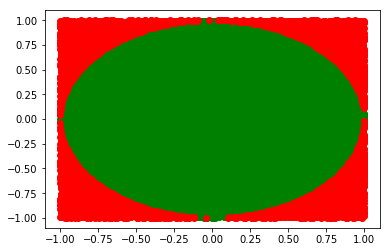

In [68]:
plt.figure()

# trace le carré
plt.plot([-1, -1, 1, 1], [-1, 1, 1, -1], '-')

# trace le cercle
x = np.linspace(-1, 1, 100)
y = np.sqrt(1- x*x)
plt.plot(x, y, 'b')
plt.plot(x, -y, 'b')

# estimation par MCMC
pi, x, y = MCMC(int(1e5),0.000000001)

# trace les points dans le cercle et hors du cercle
dist = x*x + y*y 
plt.plot(x[dist <=1], y[dist <=1], "go")
plt.plot(x[dist>1], y[dist>1], "ro")
plt.show()

In [69]:
pi

3.39152016008524